In [1]:
import numpy as np
import pandas as pd

import seaborn as sns
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings('ignore')

In [2]:
df = pd.read_csv('loan.csv')

In [3]:
df.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
4,1075358,1311748,3000,3000,3000.0,60 months,12.69%,67.79,B,B5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN


In [4]:
df.shape

(39717, 111)

In [5]:
round(100*df.isnull().mean(),2)

id                              0.0
member_id                       0.0
loan_amnt                       0.0
funded_amnt                     0.0
funded_amnt_inv                 0.0
                              ...  
tax_liens                       0.1
tot_hi_cred_lim               100.0
total_bal_ex_mort             100.0
total_bc_limit                100.0
total_il_high_credit_limit    100.0
Length: 111, dtype: float64

#Dropping all the NUll Values and unwanted of the Columns

In [6]:
df1 = df.drop({'total_il_high_credit_limit','total_bc_limit','total_bal_ex_mort','tot_hi_cred_lim','percent_bc_gt_75','pct_tl_nvr_dlq','num_tl_op_past_12m','num_tl_90g_dpd_24m','num_tl_30dpd','num_tl_120dpd_2m','num_sats','num_rev_tl_bal_gt_0','num_rev_accts','num_op_rev_tl','num_il_tl','num_bc_tl','num_bc_sats','num_actv_rev_tl','num_actv_bc_tl','num_accts_ever_120_pd','mths_since_recent_revol_delinq','mths_since_recent_inq','mths_since_recent_bc_dlq','mths_since_recent_bc','mort_acc','mo_sin_rcnt_tl','mo_sin_rcnt_rev_tl_op','mo_sin_old_rev_tl_op','mo_sin_old_il_acct','bc_util','bc_open_to_buy','avg_cur_bal','acc_open_past_24mths','inq_last_12m','mths_since_last_major_derog','total_bal_il','annual_inc_joint','dti_joint','verification_status_joint','open_il_24m','open_il_6m','tot_coll_amt','tot_cur_bal','total_cu_tl','il_util','inq_fi','total_rev_hi_lim','all_util','max_bal_bc','open_rv_24m','open_rv_12m','mths_since_rcnt_il','open_il_12m','open_acc_6m','next_pymnt_d','mths_since_last_record','mths_since_last_delinq','desc','emp_title','collections_12_mths_ex_med','chargeoff_within_12_mths','tax_liens','title'}, axis = 1)

In [8]:
df1.shape

(39717, 48)

In [10]:
df2 = df.dropna(axis = 1 , how = 'all')
df2.shape

(39717, 57)

In [16]:
df2.columns

Index(['id', 'member_id', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv',
       'term', 'int_rate', 'installment', 'grade', 'sub_grade', 'emp_title',
       'emp_length', 'home_ownership', 'annual_inc', 'verification_status',
       'issue_d', 'loan_status', 'pymnt_plan', 'url', 'desc', 'purpose',
       'title', 'zip_code', 'addr_state', 'dti', 'delinq_2yrs',
       'earliest_cr_line', 'inq_last_6mths', 'mths_since_last_delinq',
       'mths_since_last_record', 'open_acc', 'pub_rec', 'revol_bal',
       'revol_util', 'total_acc', 'initial_list_status', 'out_prncp',
       'out_prncp_inv', 'total_pymnt', 'total_pymnt_inv', 'total_rec_prncp',
       'total_rec_int', 'total_rec_late_fee', 'recoveries',
       'collection_recovery_fee', 'last_pymnt_d', 'last_pymnt_amnt',
       'next_pymnt_d', 'last_credit_pull_d', 'collections_12_mths_ex_med',
       'policy_code', 'application_type', 'acc_now_delinq',
       'chargeoff_within_12_mths', 'delinq_amnt', 'pub_rec_bankruptcies',
       'tax_

In [ ]:
df2 = df2.drop({'tax_liens','pub_rec_bankruptcies','delinq_amnt','chargeoff_within_12_mths','acc_now_delinq','application_type','policy_code','collections_12_mths_ex_med','next_pymnt_d','total_rec_late_fee','out_prncp_inv','out_prncp','initial_list_status','mths_since_last_record','mths_since_last_delinq','delinq_2yrs','desc','url','pymnt_plan','emp_title','id','member_id'}, axis = 1)
df2.shape

In [24]:
df2.shape

(39717, 35)

In [29]:
df2 = df2.drop('title', axis = 1)
df2.shape

(39717, 34)

In [30]:
df2.shape

(39717, 34)

In [31]:
df2.isnull().sum().sort_values()

loan_amnt                     0
collection_recovery_fee       0
recoveries                    0
total_rec_int                 0
total_rec_prncp               0
total_pymnt_inv               0
total_pymnt                   0
total_acc                     0
revol_bal                     0
pub_rec                       0
open_acc                      0
inq_last_6mths                0
earliest_cr_line              0
dti                           0
last_pymnt_amnt               0
addr_state                    0
purpose                       0
funded_amnt                   0
funded_amnt_inv               0
term                          0
int_rate                      0
installment                   0
grade                         0
zip_code                      0
sub_grade                     0
home_ownership                0
annual_inc                    0
verification_status           0
issue_d                       0
loan_status                   0
last_credit_pull_d            2
revol_ut

In [32]:
df2.last_credit_pull_d.fillna(0,inplace=True)
df2.revol_util.fillna(0,inplace=True)
df2.emp_length.fillna(0 ,inplace=True)
df2.last_pymnt_d.fillna(0 ,inplace=True)

In [33]:
df2.isnull().sum()

loan_amnt                  0
funded_amnt                0
funded_amnt_inv            0
term                       0
int_rate                   0
installment                0
grade                      0
sub_grade                  0
emp_length                 0
home_ownership             0
annual_inc                 0
verification_status        0
issue_d                    0
loan_status                0
purpose                    0
zip_code                   0
addr_state                 0
dti                        0
earliest_cr_line           0
inq_last_6mths             0
open_acc                   0
pub_rec                    0
revol_bal                  0
revol_util                 0
total_acc                  0
total_pymnt                0
total_pymnt_inv            0
total_rec_prncp            0
total_rec_int              0
recoveries                 0
collection_recovery_fee    0
last_pymnt_d               0
last_pymnt_amnt            0
last_credit_pull_d         0
dtype: int64

In [36]:
df2.shape

(39717, 34)

In [37]:
df2.head()

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,...,total_acc,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,last_credit_pull_d
0,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,10+ years,RENT,...,9,5863.155187,5833.84,5000.00,863.16,0.00,0.00,Jan-15,171.62,May-16
1,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,< 1 year,RENT,...,4,1008.710000,1008.71,456.46,435.17,117.08,1.11,Apr-13,119.66,Sep-13
2,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,10+ years,RENT,...,10,3005.666844,3005.67,2400.00,605.67,0.00,0.00,Jun-14,649.91,May-16
3,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,10+ years,RENT,...,37,12231.890000,12231.89,10000.00,2214.92,0.00,0.00,Jan-15,357.48,Apr-16
4,3000,3000,3000.0,60 months,12.69%,67.79,B,B5,1 year,RENT,...,38,3513.330000,3513.33,2475.94,1037.39,0.00,0.00,May-16,67.79,May-16


In [38]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Data columns (total 34 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   loan_amnt                39717 non-null  int64  
 1   funded_amnt              39717 non-null  int64  
 2   funded_amnt_inv          39717 non-null  float64
 3   term                     39717 non-null  object 
 4   int_rate                 39717 non-null  object 
 5   installment              39717 non-null  float64
 6   grade                    39717 non-null  object 
 7   sub_grade                39717 non-null  object 
 8   emp_length               39717 non-null  object 
 9   home_ownership           39717 non-null  object 
 10  annual_inc               39717 non-null  float64
 11  verification_status      39717 non-null  object 
 12  issue_d                  39717 non-null  object 
 13  loan_status              39717 non-null  object 
 14  purpose               

In [39]:
~df2.describe().columns

Index(['loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'installment',
       'annual_inc', 'dti', 'inq_last_6mths', 'open_acc', 'pub_rec',
       'revol_bal', 'total_acc', 'total_pymnt', 'total_pymnt_inv',
       'total_rec_prncp', 'total_rec_int', 'recoveries',
       'collection_recovery_fee', 'last_pymnt_amnt'],
      dtype='object')

In [42]:
df2.columns

Index(['loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'term', 'int_rate',
       'installment', 'grade', 'sub_grade', 'emp_length', 'home_ownership',
       'annual_inc', 'verification_status', 'issue_d', 'loan_status',
       'purpose', 'zip_code', 'addr_state', 'dti', 'earliest_cr_line',
       'inq_last_6mths', 'open_acc', 'pub_rec', 'revol_bal', 'revol_util',
       'total_acc', 'total_pymnt', 'total_pymnt_inv', 'total_rec_prncp',
       'total_rec_int', 'recoveries', 'collection_recovery_fee',
       'last_pymnt_d', 'last_pymnt_amnt', 'last_credit_pull_d'],
      dtype='object')

In [43]:
num_cols = ['loan_amnt','funded_amnt','funded_amnt_inv','installment', 'annual_inc', 'dti','inq_last_6mths','open_acc','pub_rec','revol_bal','total_acc','total_pymnt','total_pymnt_inv','total_rec_prncp','total_rec_int','recoveries','collection_recovery_fee','last_pymnt_amnt']
Cat_cols = ['term','int_rate','grade','sub_grade','emp_length','home_ownership','verification_status','issue_d','loan_status','purpose','zip_code','addr_state','earliest_cr_line','revol_util','last_pymnt_d','last_credit_pull_d']


#Numerical Analysis

Hist Plot of loan_amnt


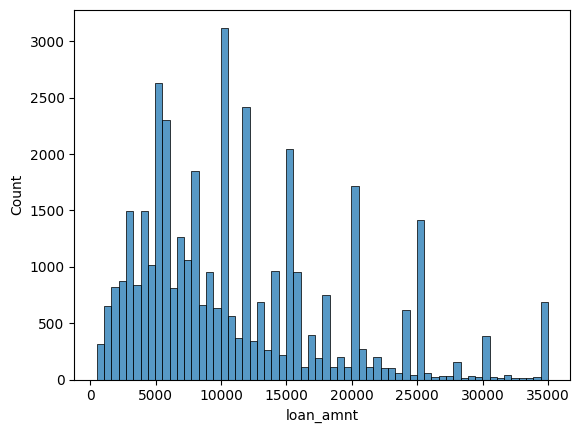

Hist Plot of funded_amnt


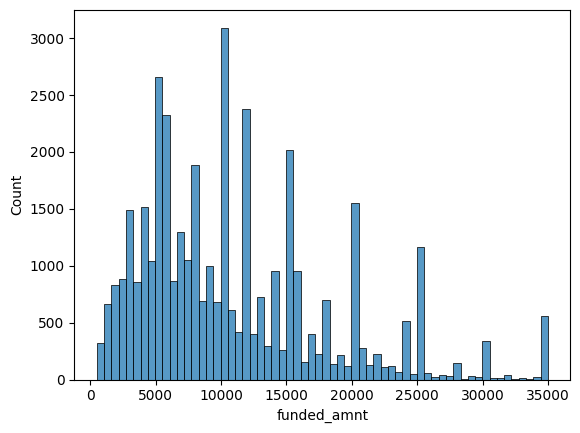

Hist Plot of funded_amnt_inv


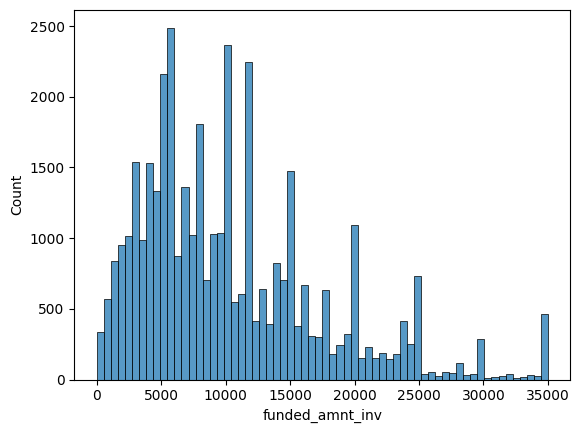

Hist Plot of installment


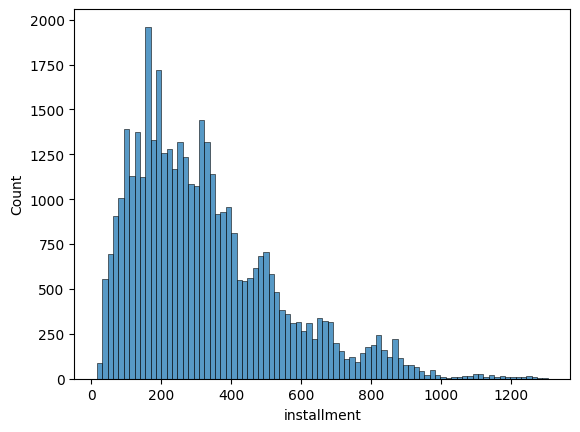

Hist Plot of annual_inc


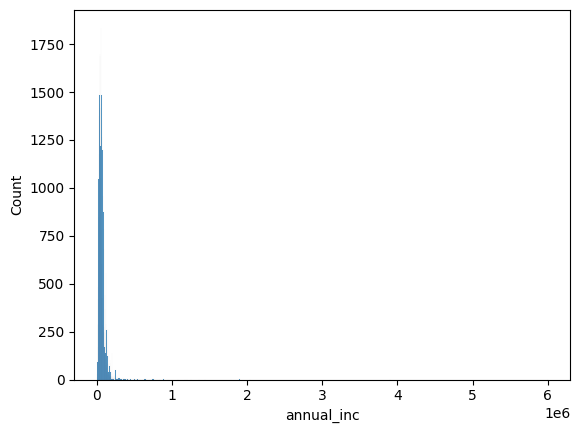

Hist Plot of dti


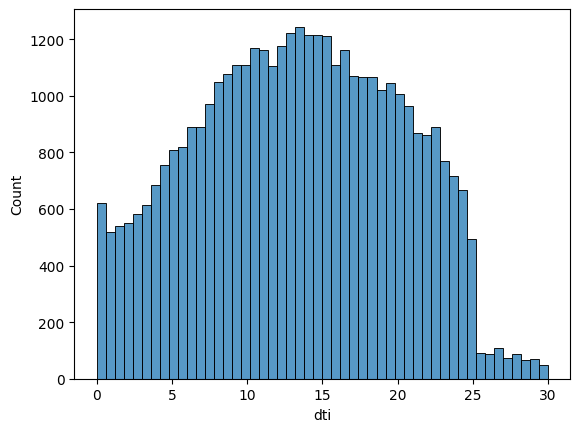

Hist Plot of inq_last_6mths


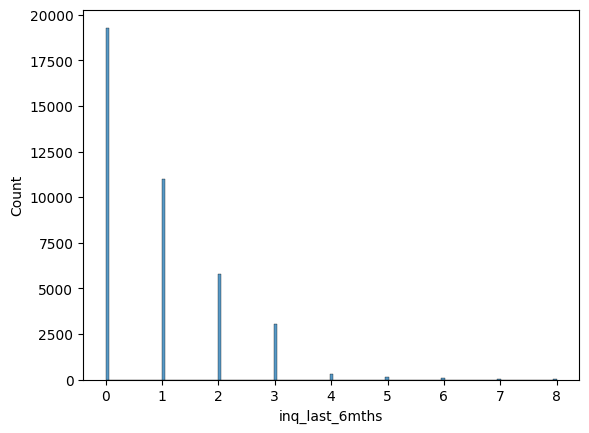

Hist Plot of open_acc


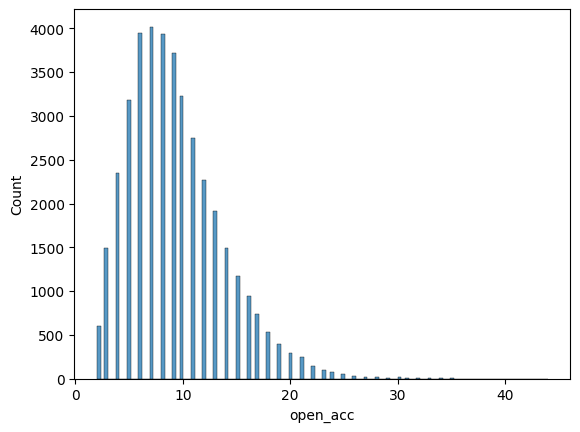

Hist Plot of pub_rec


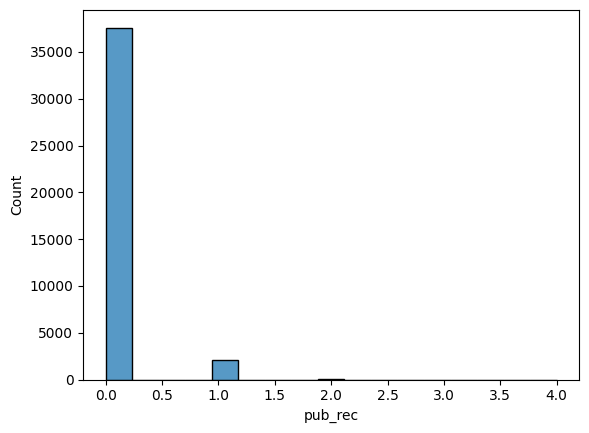

Hist Plot of revol_bal


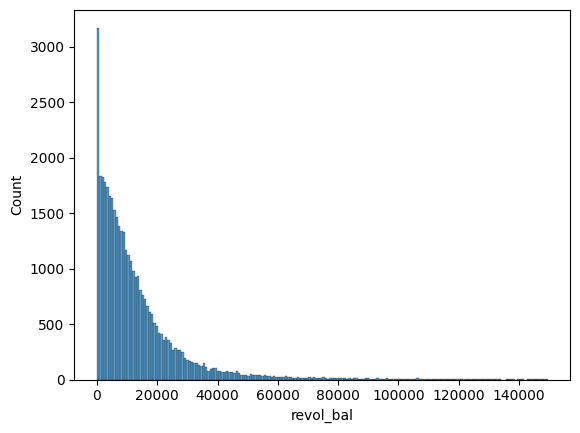

Hist Plot of total_acc


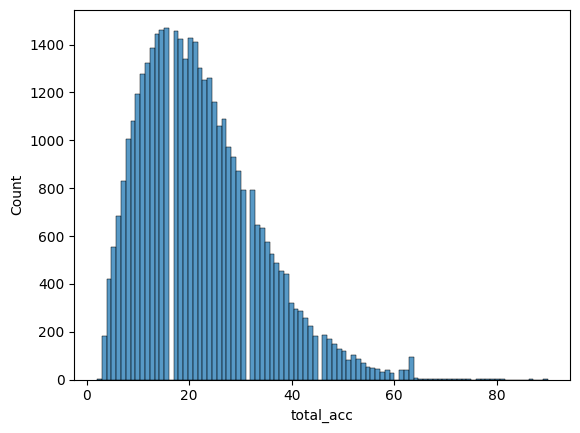

Hist Plot of total_pymnt


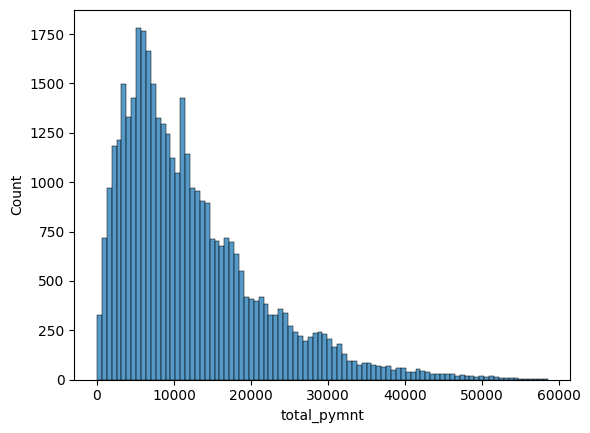

Hist Plot of total_pymnt_inv


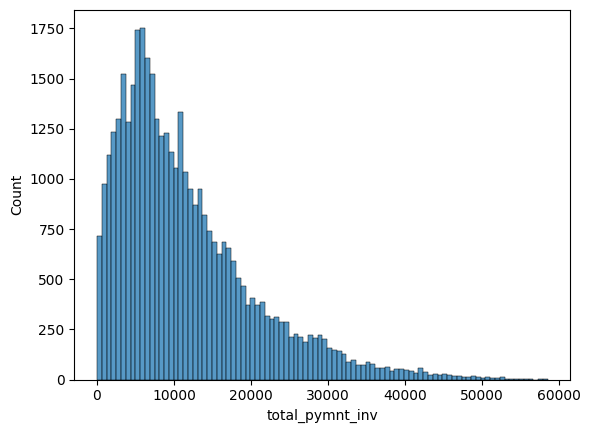

Hist Plot of total_rec_prncp


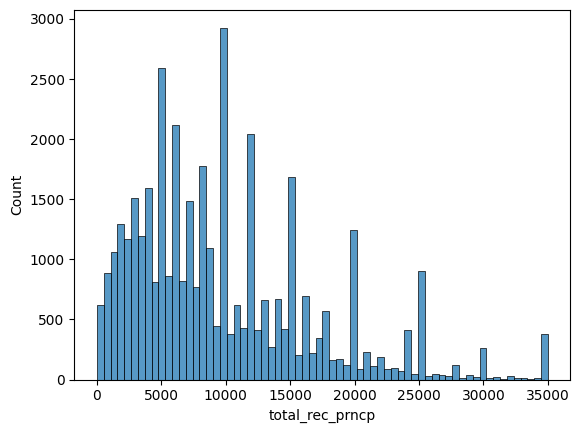

Hist Plot of total_rec_int


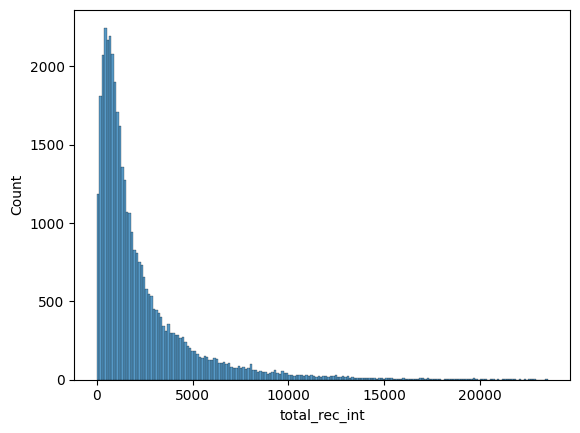

Hist Plot of recoveries


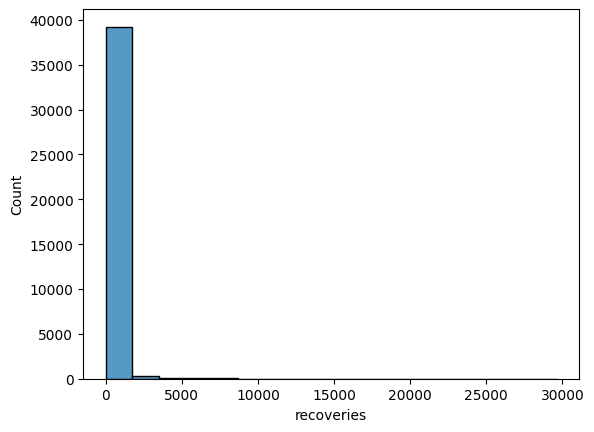

Hist Plot of collection_recovery_fee


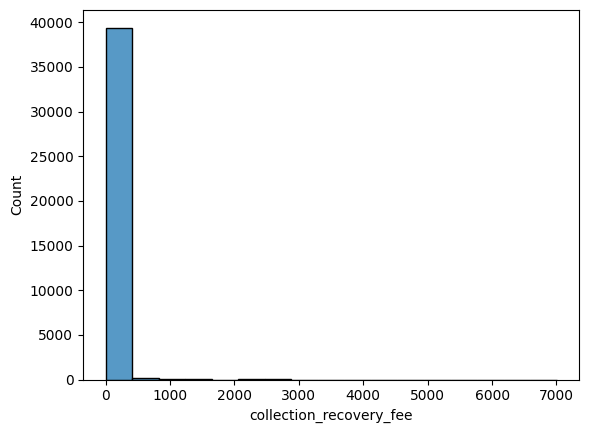

Hist Plot of last_pymnt_amnt


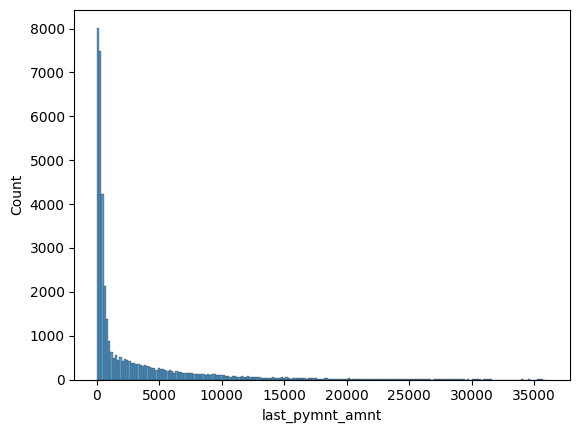

In [44]:
for i in num_cols:
  print("Hist Plot of",i)
  sns.histplot(x=df1[i])
  plt.show()

#Numerical Vs Numerical

<Axes: xlabel='loan_amnt', ylabel='last_pymnt_amnt'>

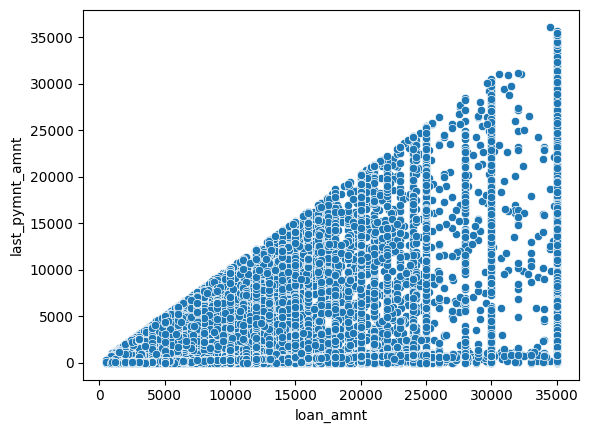

In [51]:
num_cols = ['loan_amnt','funded_amnt','funded_amnt_inv','installment', 'annual_inc', 'dti','inq_last_6mths','open_acc','pub_rec','revol_bal','total_acc','total_pymnt','total_pymnt_inv','total_rec_prncp','total_rec_int','recoveries','collection_recovery_fee','last_pymnt_amnt']
Cat_cols = ['term','int_rate','grade','sub_grade','emp_length','home_ownership','verification_status','issue_d','loan_status','purpose','zip_code','addr_state','earliest_cr_line','revol_util','last_pymnt_d','last_credit_pull_d']

sns.scatterplot(x=df['loan_amnt'],y=df['last_pymnt_amnt'])

#Univeriant Analysis for Numerical values

Box Plot of loan_amnt


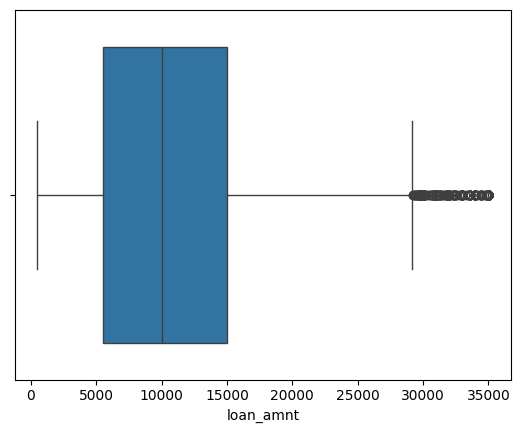

Box Plot of funded_amnt


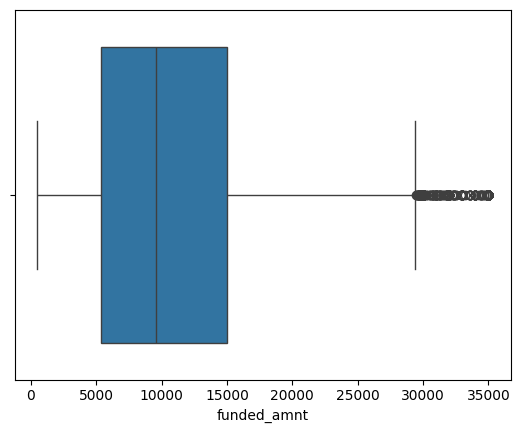

Box Plot of funded_amnt_inv


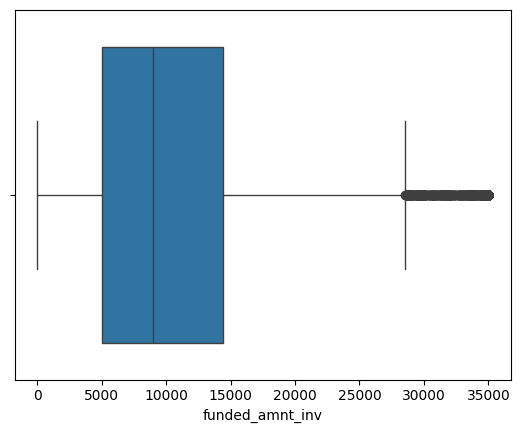

Box Plot of installment


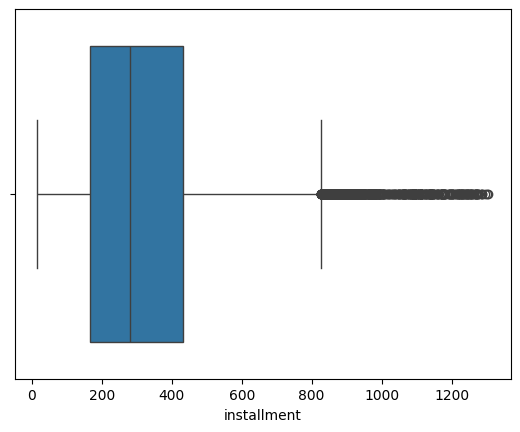

Box Plot of annual_inc


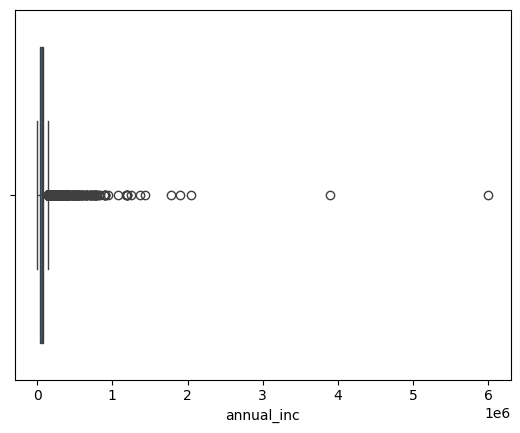

Box Plot of dti


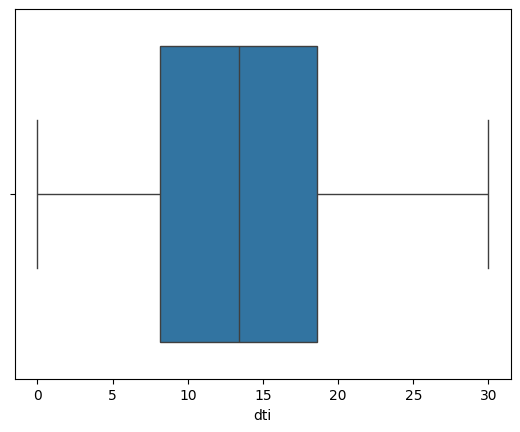

Box Plot of inq_last_6mths


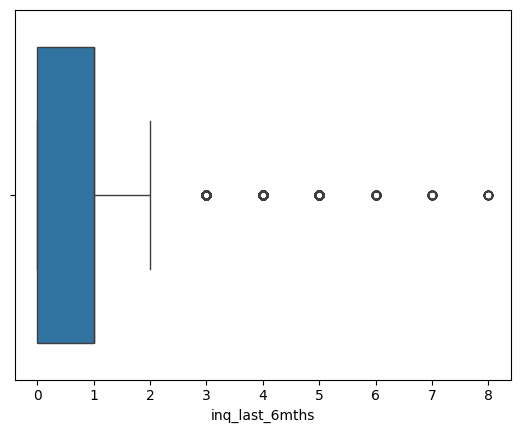

Box Plot of open_acc


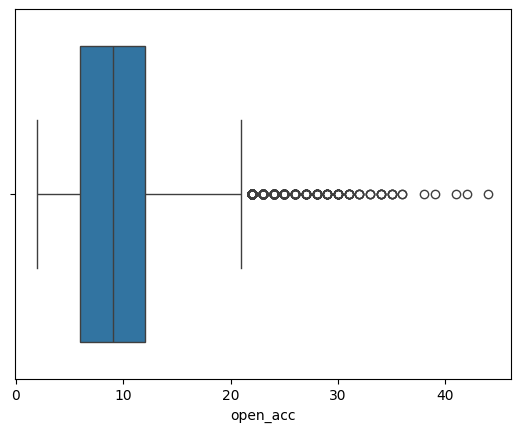

Box Plot of pub_rec


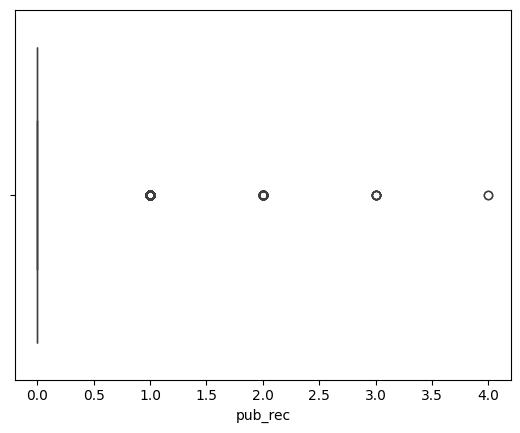

Box Plot of revol_bal


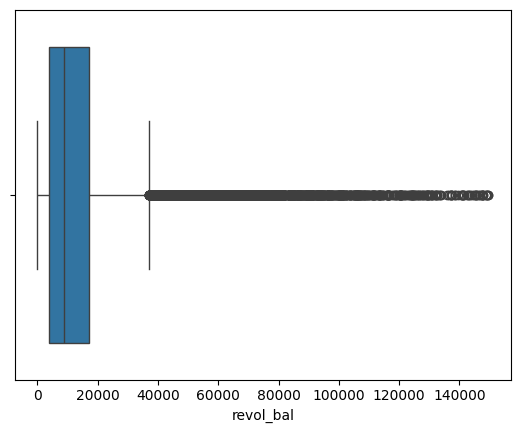

Box Plot of total_acc


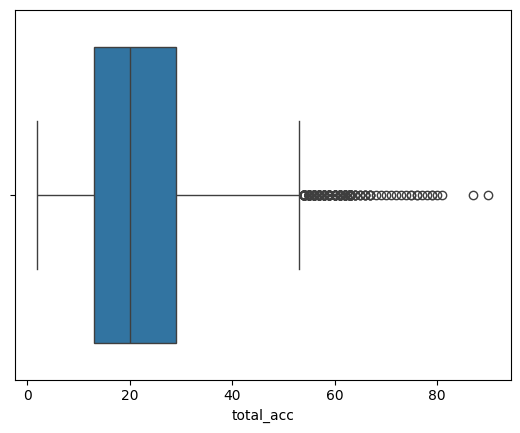

Box Plot of total_pymnt


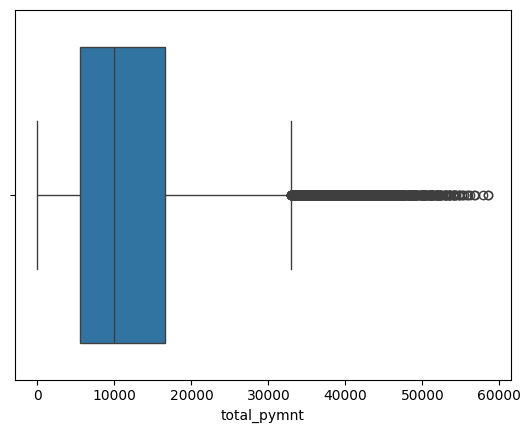

Box Plot of total_pymnt_inv


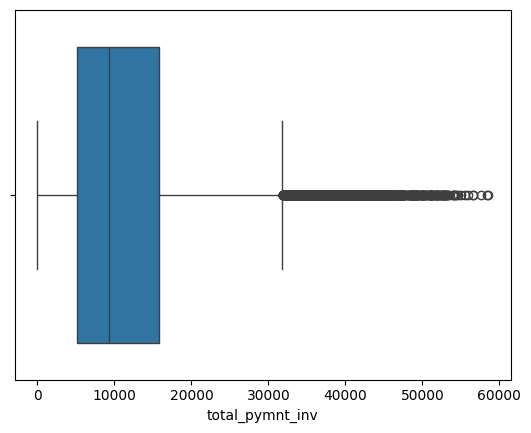

Box Plot of total_rec_prncp


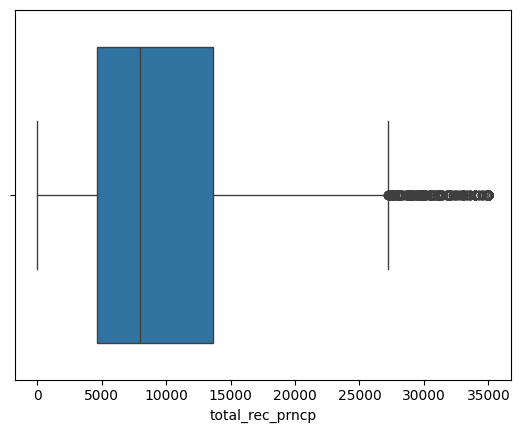

Box Plot of total_rec_int


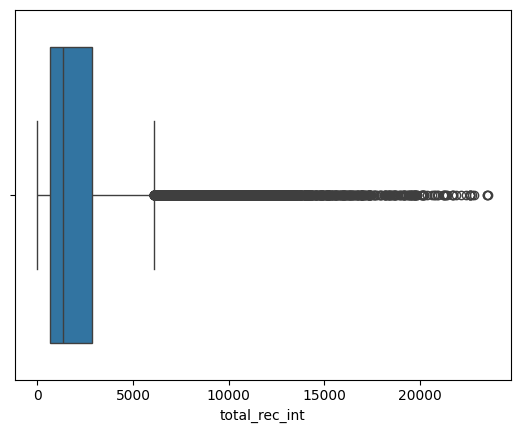

Box Plot of recoveries


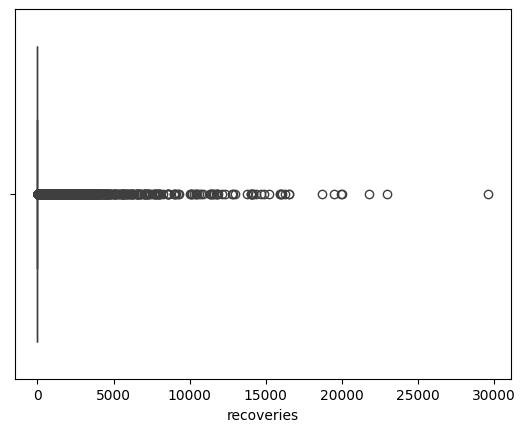

Box Plot of collection_recovery_fee


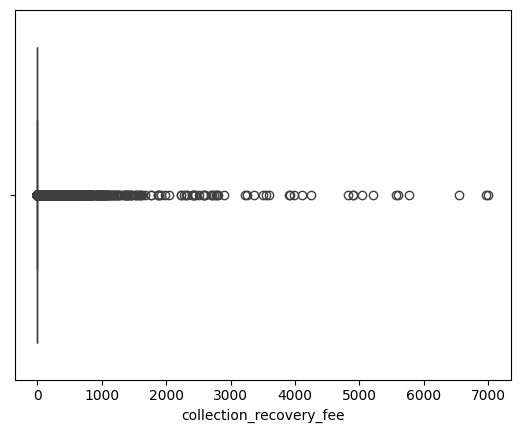

Box Plot of last_pymnt_amnt


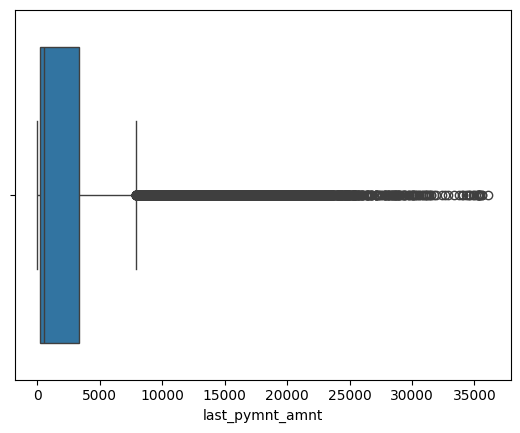

In [52]:
for i in num_cols:
  print("Box Plot of",i)
  sns.boxplot(x=df1[i])
  plt.show()

#Categorical Analysis

Count Plot of term


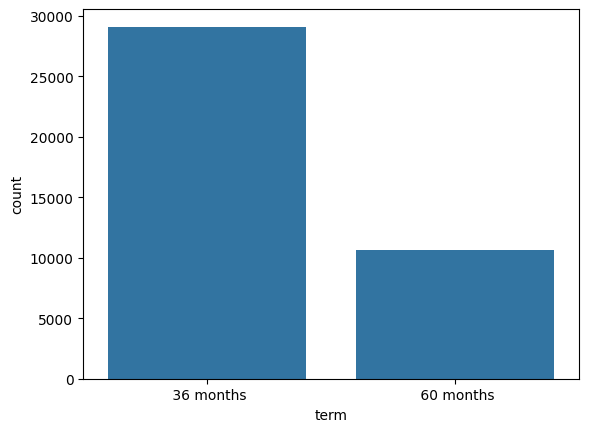

Count Plot of int_rate


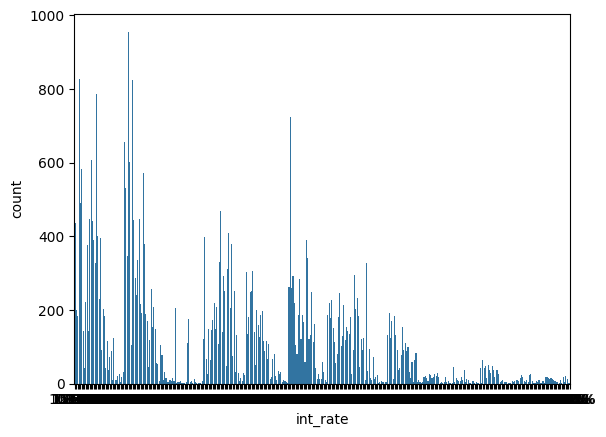

Count Plot of grade


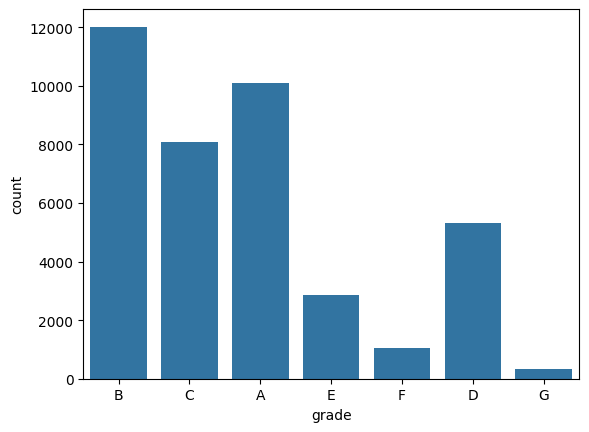

Count Plot of sub_grade


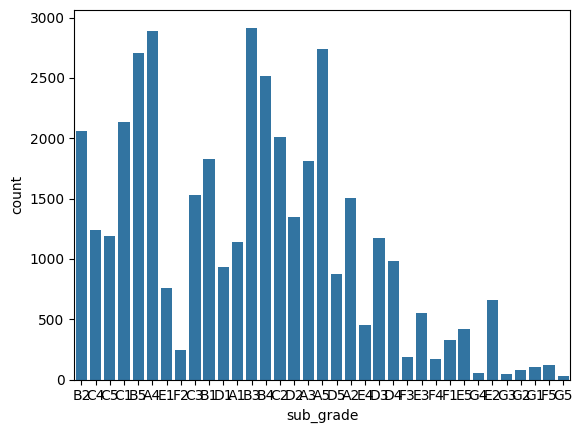

Count Plot of emp_length


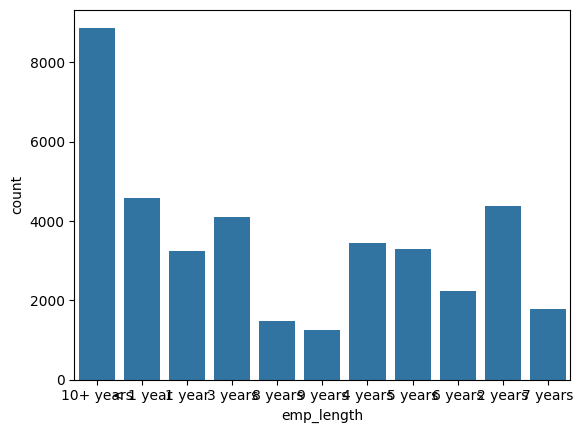

Count Plot of home_ownership


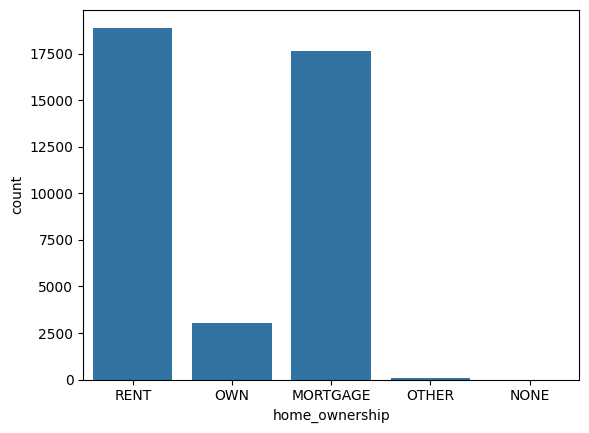

Count Plot of verification_status


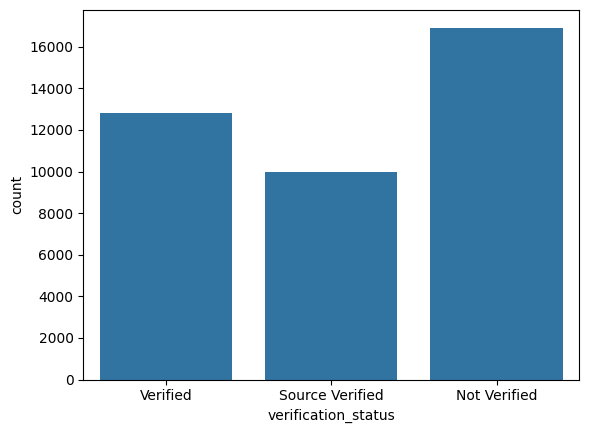

Count Plot of issue_d


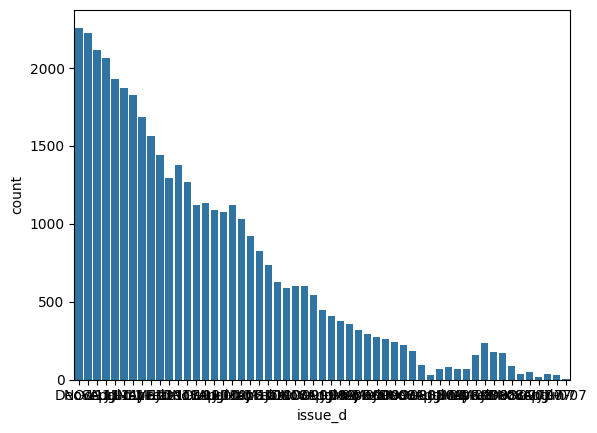

Count Plot of loan_status


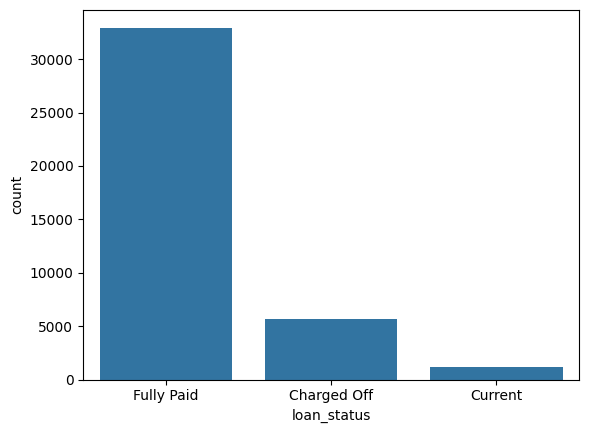

Count Plot of purpose


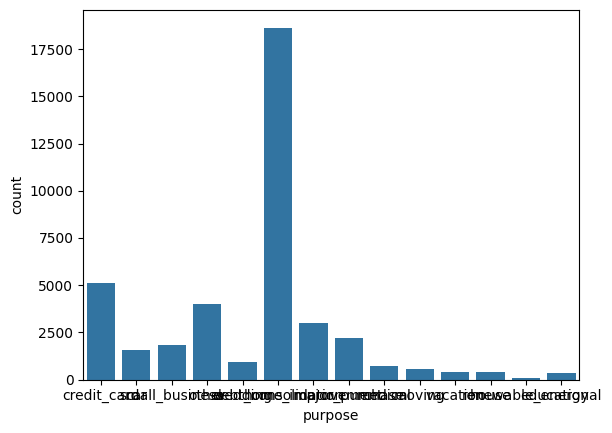

Count Plot of zip_code


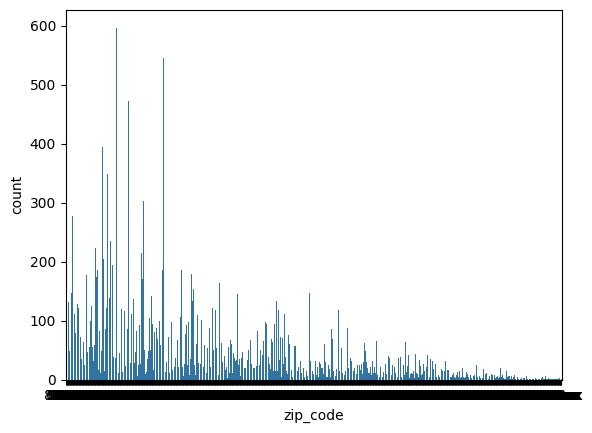

Count Plot of addr_state


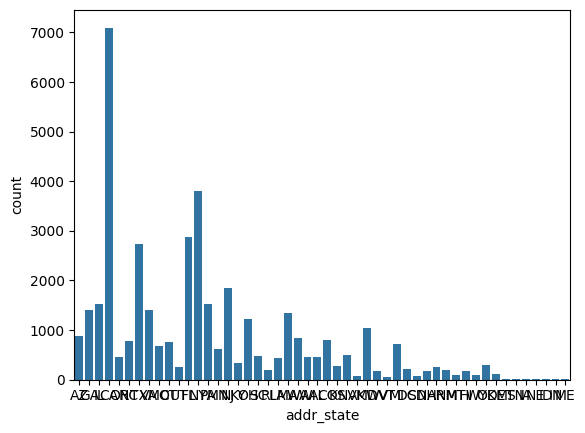

Count Plot of earliest_cr_line


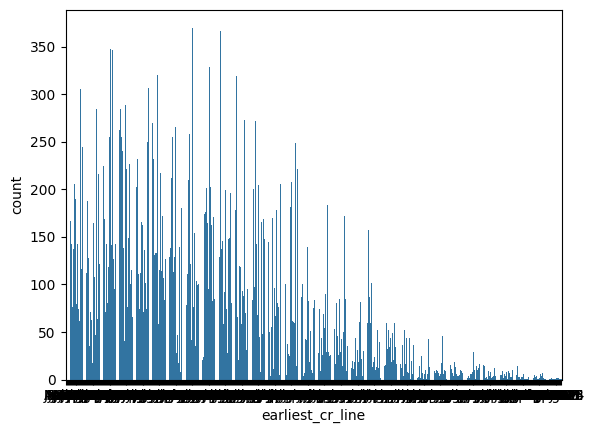

Count Plot of revol_util


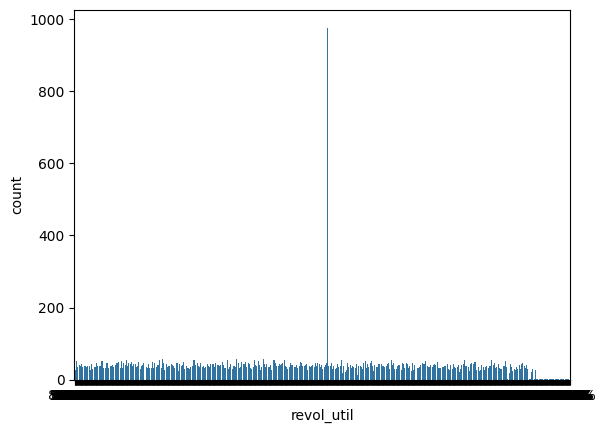

Count Plot of last_pymnt_d


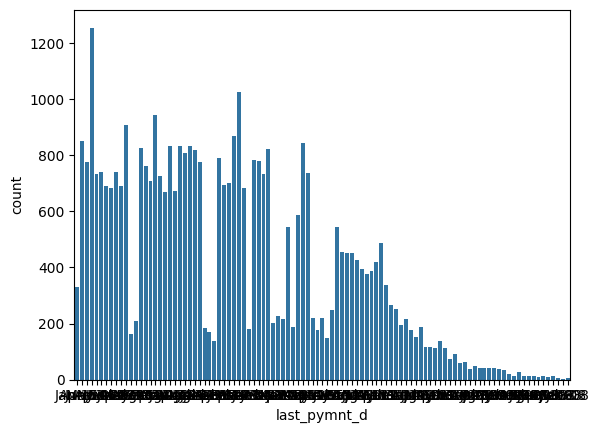

Count Plot of last_credit_pull_d


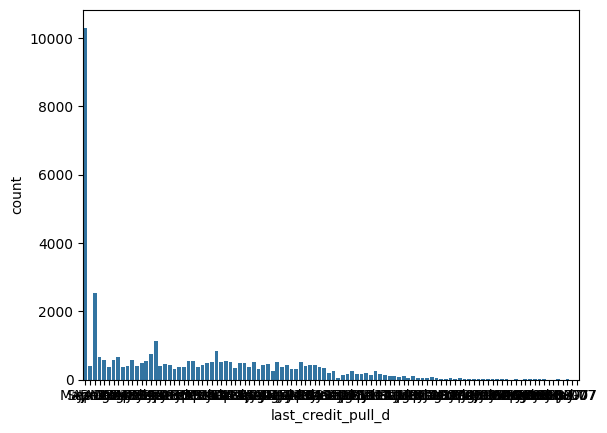

In [53]:
num_cols = ['loan_amnt','funded_amnt','funded_amnt_inv','installment', 'annual_inc', 'dti','inq_last_6mths','open_acc','pub_rec','revol_bal','total_acc','total_pymnt','total_pymnt_inv','total_rec_prncp','total_rec_int','recoveries','collection_recovery_fee','last_pymnt_amnt']
Cat_cols = ['term','int_rate','grade','sub_grade','emp_length','home_ownership','verification_status','issue_d','loan_status','purpose','zip_code','addr_state','earliest_cr_line','revol_util','last_pymnt_d','last_credit_pull_d']

for i in Cat_cols:
  print("Count Plot of",i)
  sns.countplot(x=df1[i])
  plt.show()

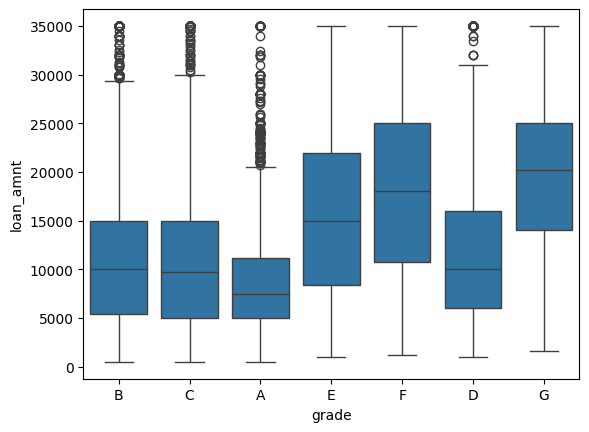

In [54]:
sns.boxplot(x=df1['grade'],y=df1['loan_amnt'])
plt.show()

#Bivariate Analysis
## Numerical Vs Categorical

Box Plot of loan_amnt Vs term


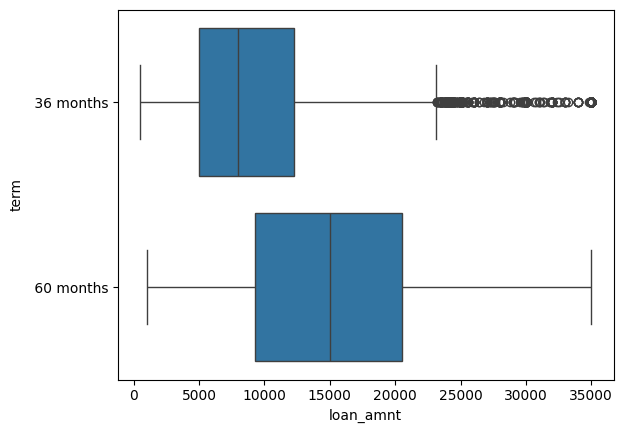

Box Plot of loan_amnt Vs int_rate


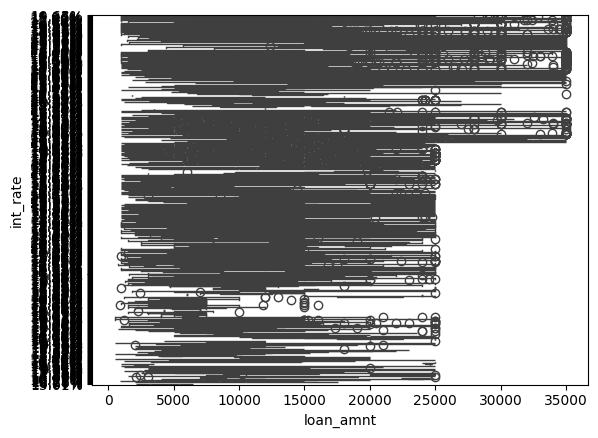

Box Plot of loan_amnt Vs grade


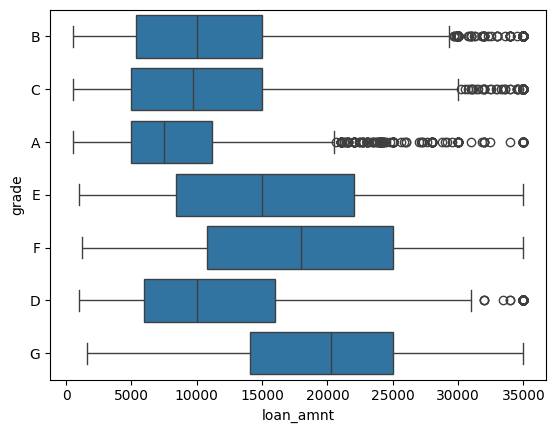

Box Plot of loan_amnt Vs sub_grade


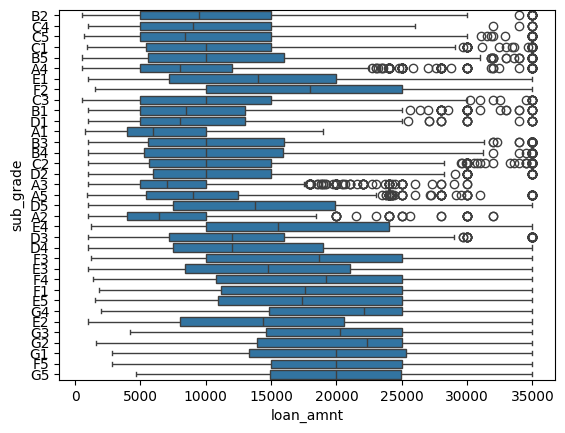

Box Plot of loan_amnt Vs emp_length


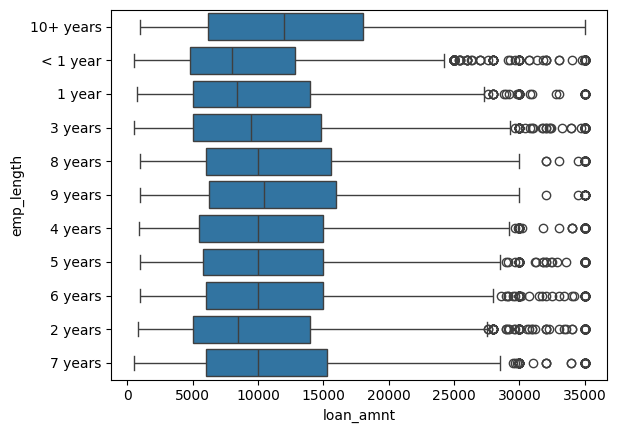

Box Plot of loan_amnt Vs home_ownership


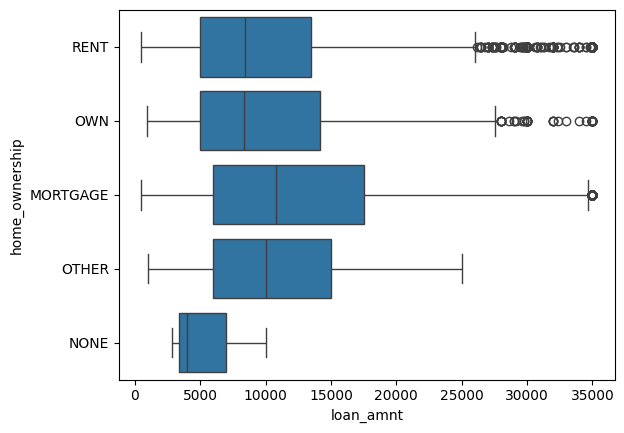

Box Plot of loan_amnt Vs verification_status


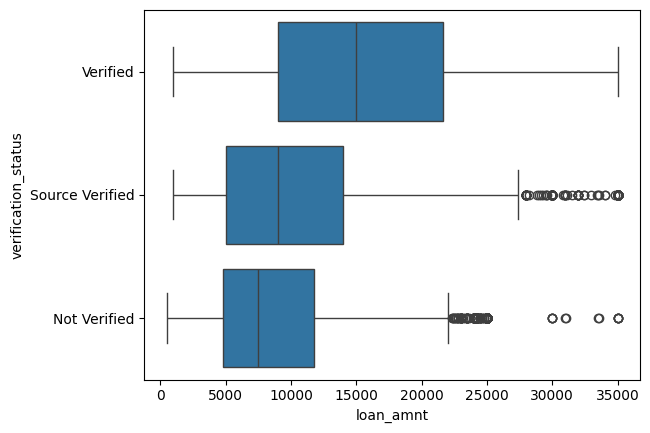

Box Plot of loan_amnt Vs issue_d


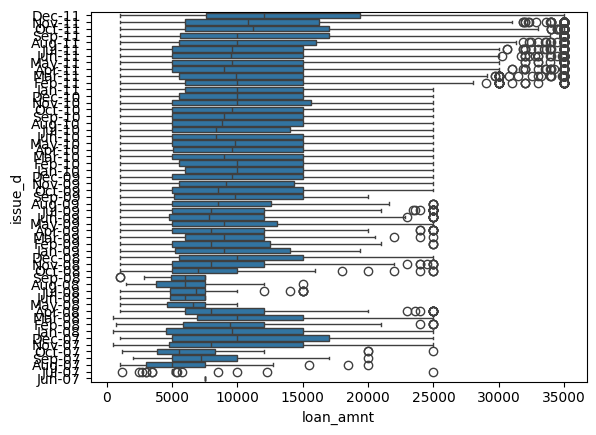

Box Plot of loan_amnt Vs loan_status


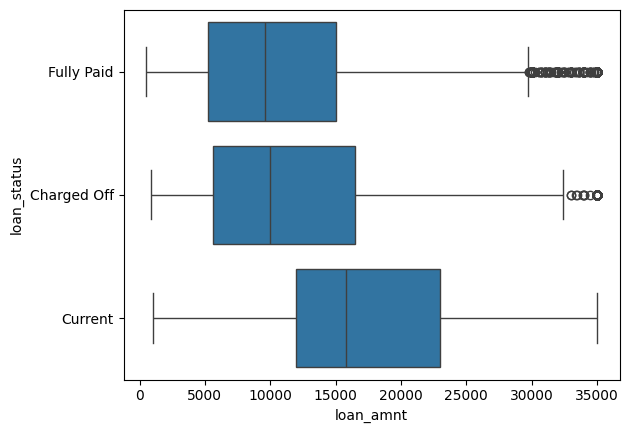

Box Plot of loan_amnt Vs purpose


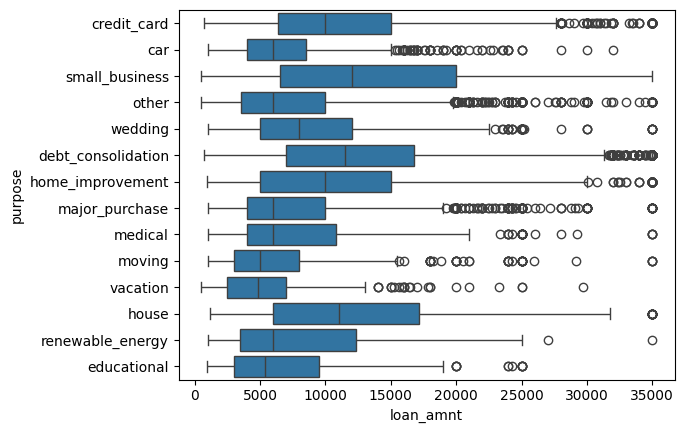

Box Plot of loan_amnt Vs zip_code


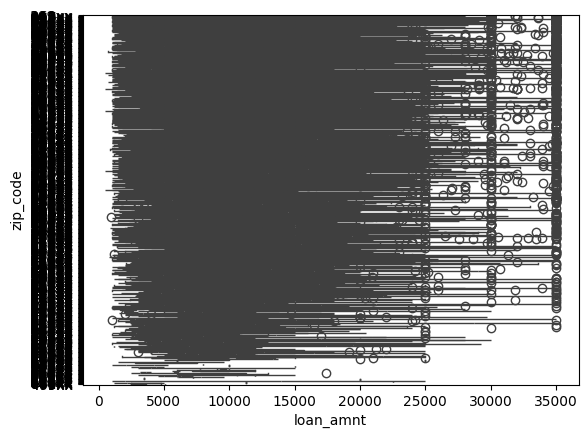

Box Plot of loan_amnt Vs addr_state


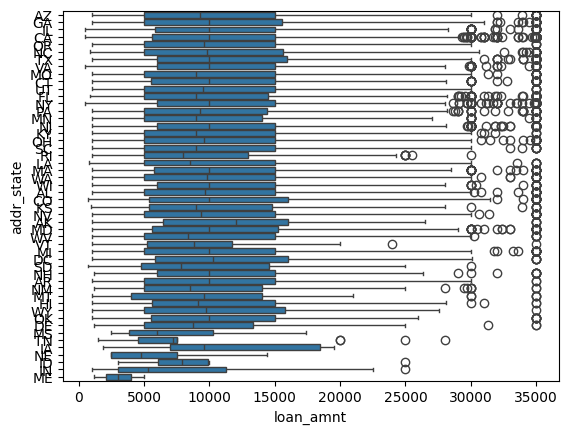

Box Plot of loan_amnt Vs earliest_cr_line


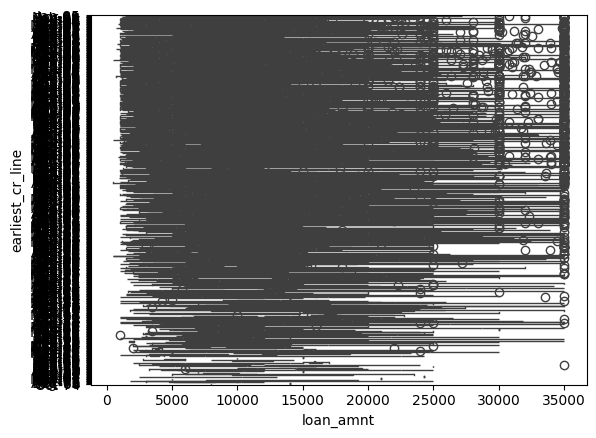

Box Plot of loan_amnt Vs revol_util


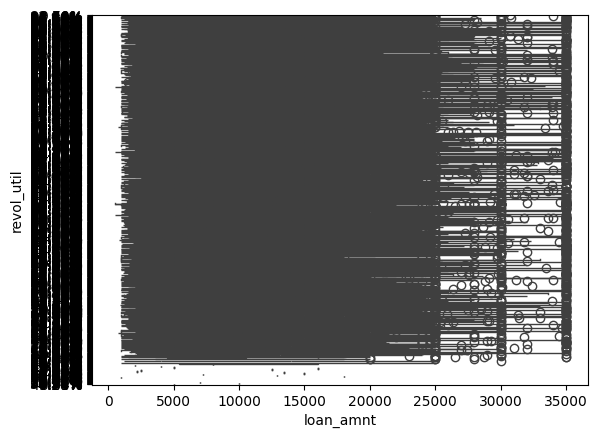

Box Plot of loan_amnt Vs last_pymnt_d


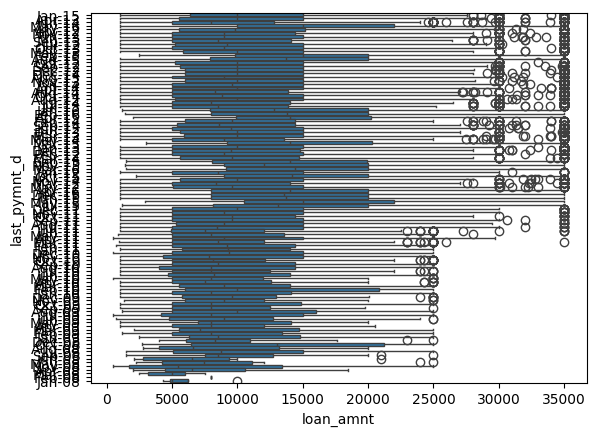

Box Plot of loan_amnt Vs last_credit_pull_d


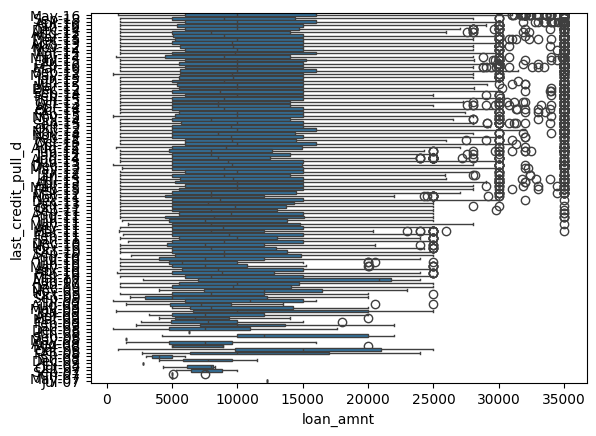

Box Plot of funded_amnt Vs term


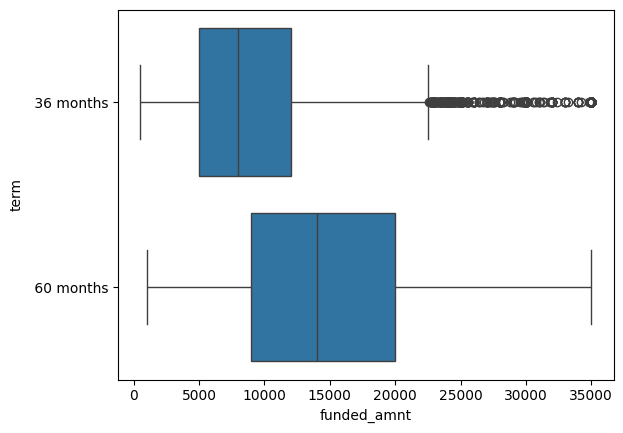

Box Plot of funded_amnt Vs int_rate


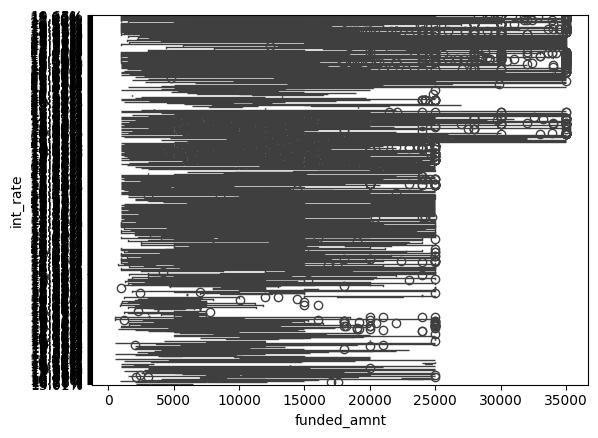

Box Plot of funded_amnt Vs grade


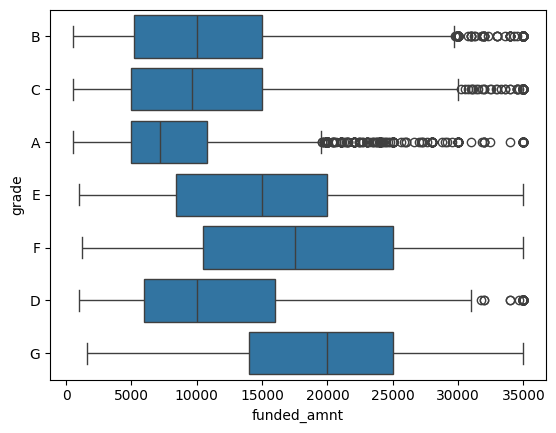

Box Plot of funded_amnt Vs sub_grade


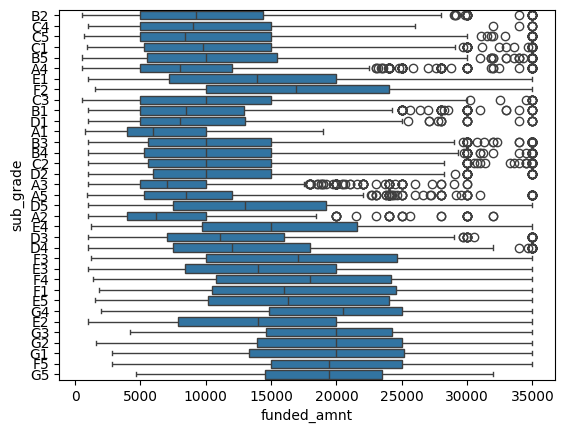

Box Plot of funded_amnt Vs emp_length


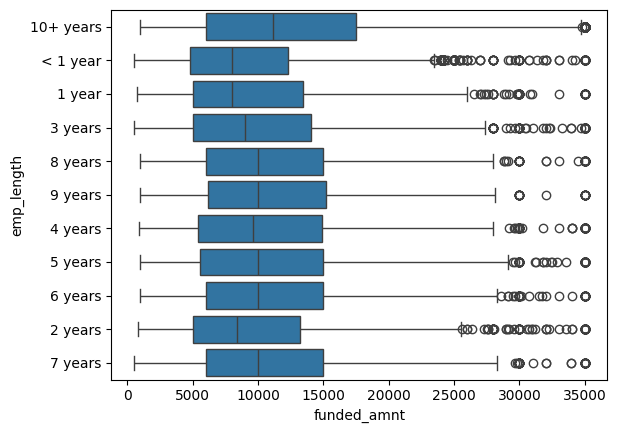

Box Plot of funded_amnt Vs home_ownership


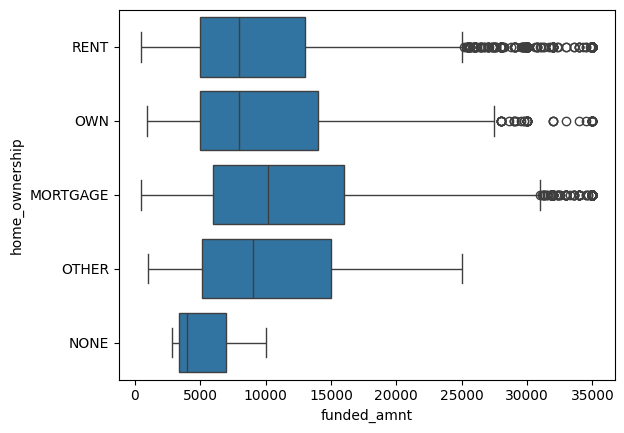

Box Plot of funded_amnt Vs verification_status


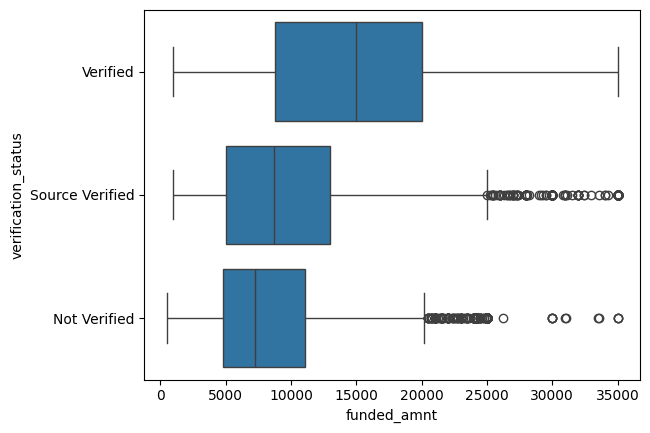

Box Plot of funded_amnt Vs issue_d


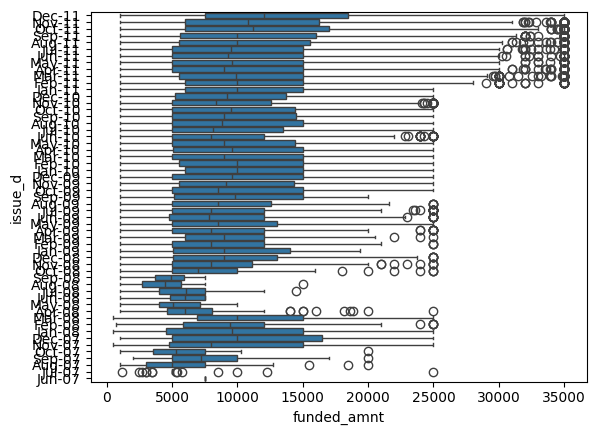

Box Plot of funded_amnt Vs loan_status


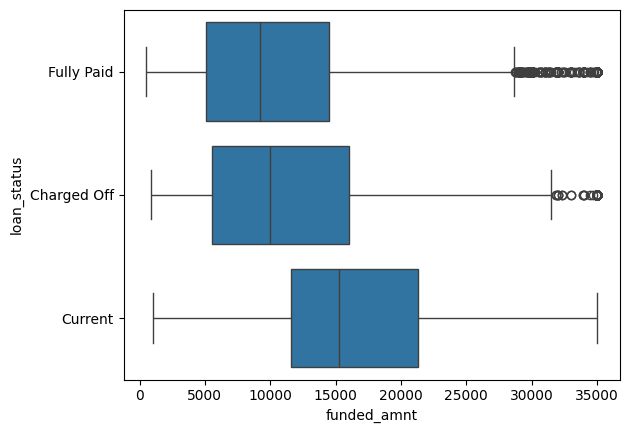

Box Plot of funded_amnt Vs purpose


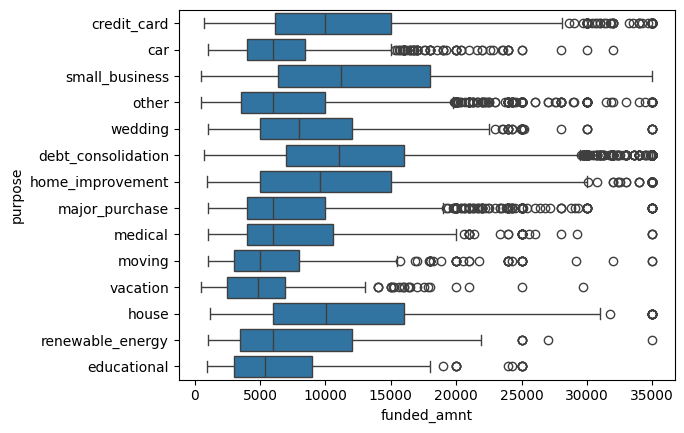

Box Plot of funded_amnt Vs zip_code


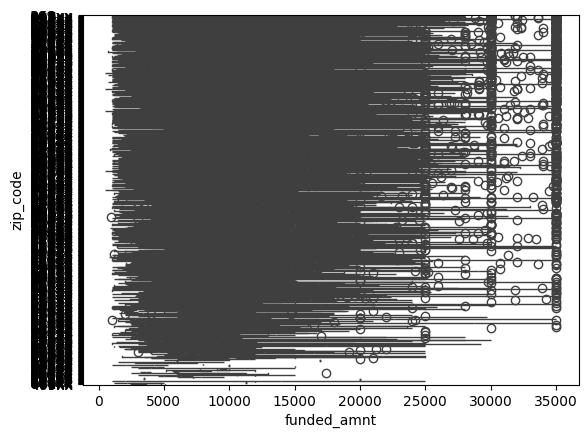

Box Plot of funded_amnt Vs addr_state


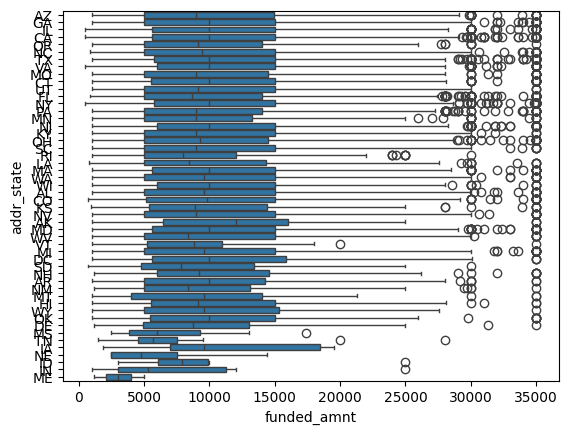

Box Plot of funded_amnt Vs earliest_cr_line


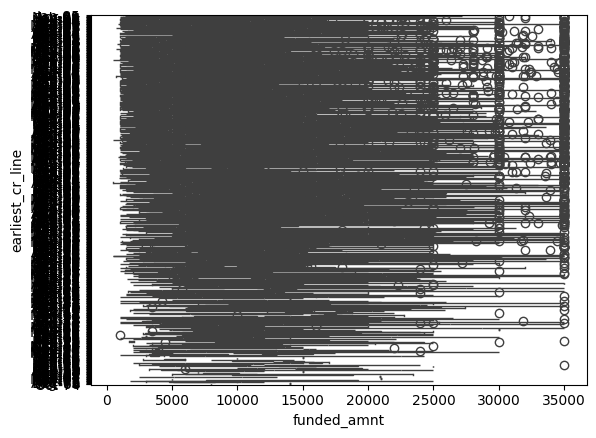

Box Plot of funded_amnt Vs revol_util


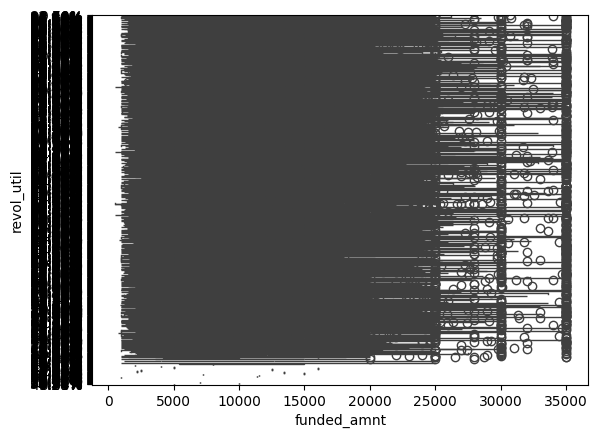

Box Plot of funded_amnt Vs last_pymnt_d


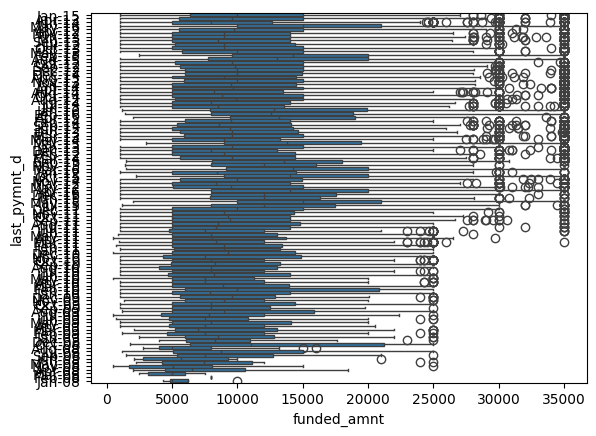

Box Plot of funded_amnt Vs last_credit_pull_d


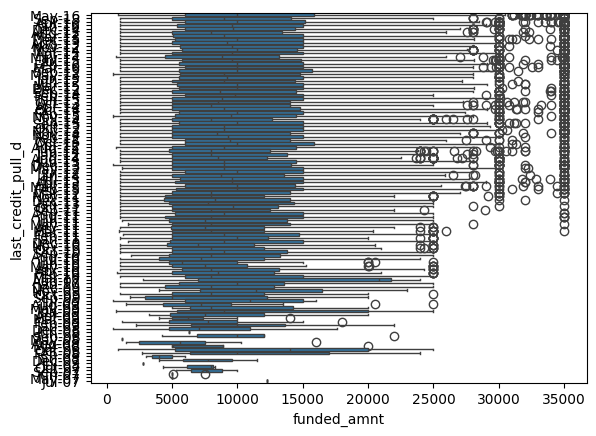

Box Plot of funded_amnt_inv Vs term


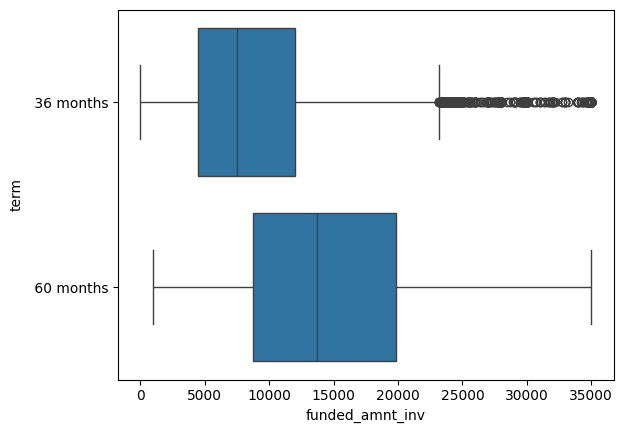

Box Plot of funded_amnt_inv Vs int_rate


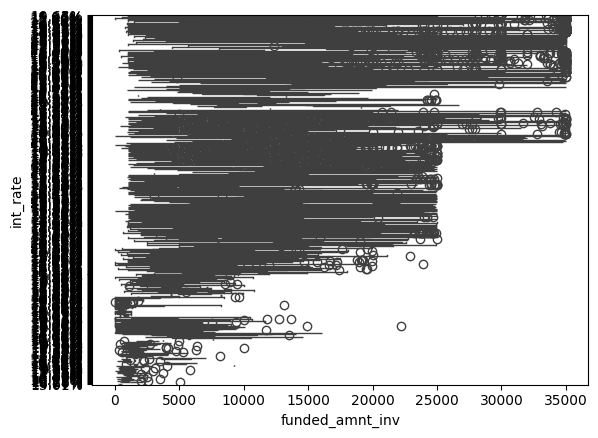

Box Plot of funded_amnt_inv Vs grade


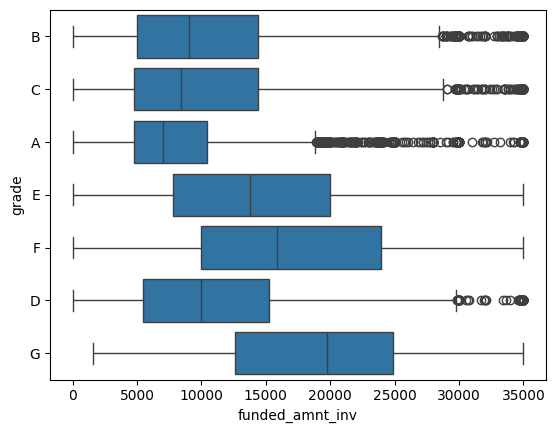

Box Plot of funded_amnt_inv Vs sub_grade


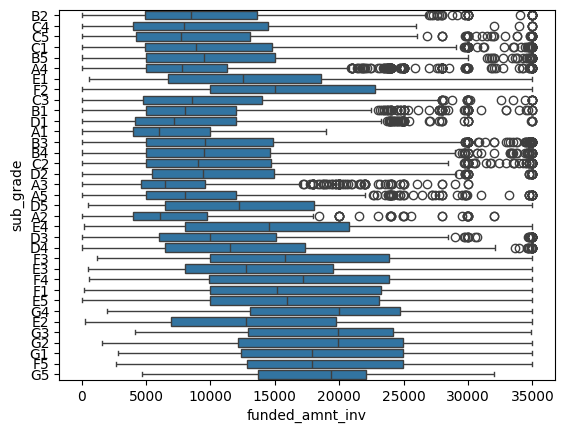

Box Plot of funded_amnt_inv Vs emp_length


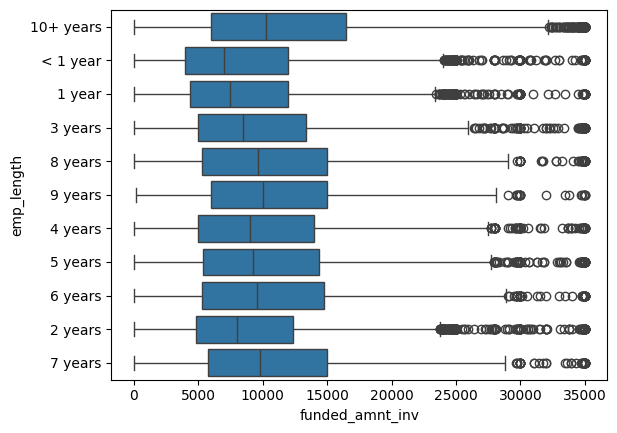

Box Plot of funded_amnt_inv Vs home_ownership


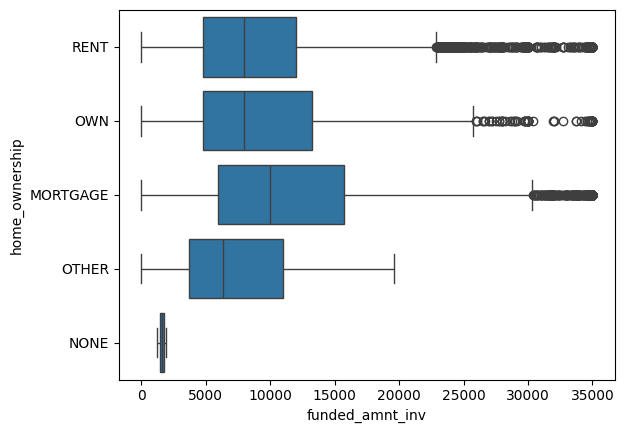

Box Plot of funded_amnt_inv Vs verification_status


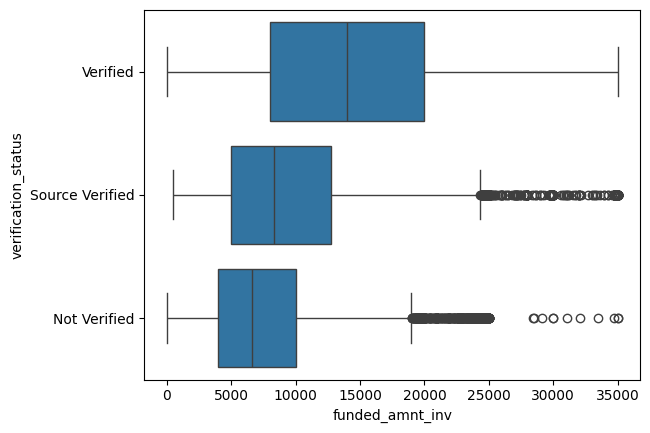

Box Plot of funded_amnt_inv Vs issue_d


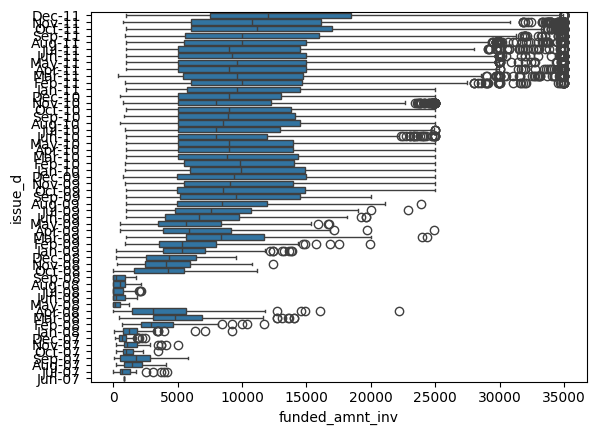

Box Plot of funded_amnt_inv Vs loan_status


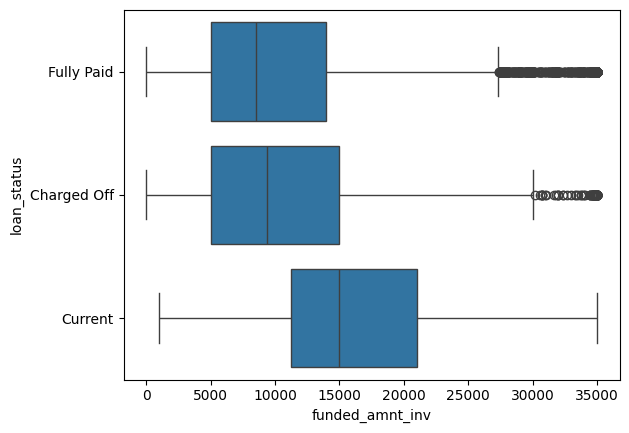

Box Plot of funded_amnt_inv Vs purpose


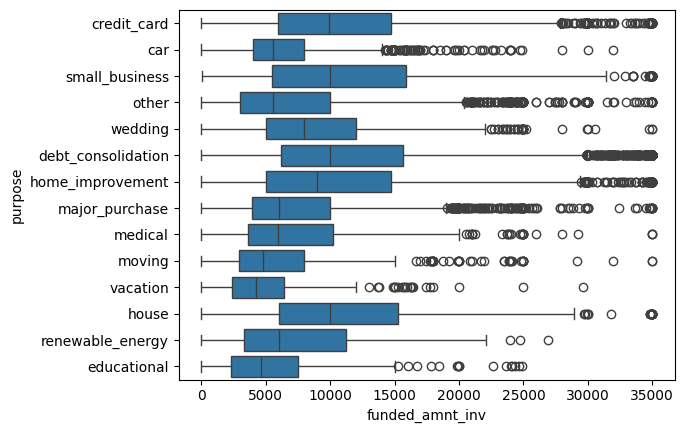

Box Plot of funded_amnt_inv Vs zip_code


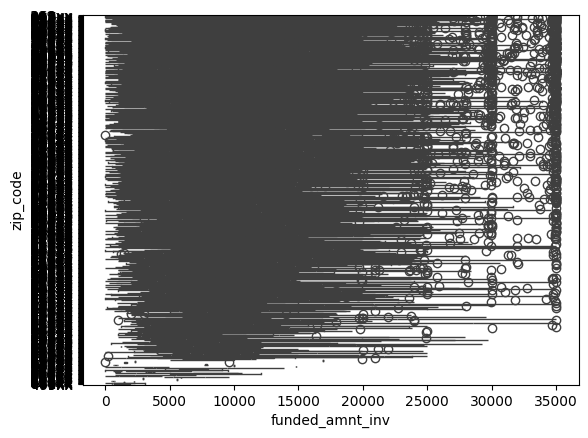

Box Plot of funded_amnt_inv Vs addr_state


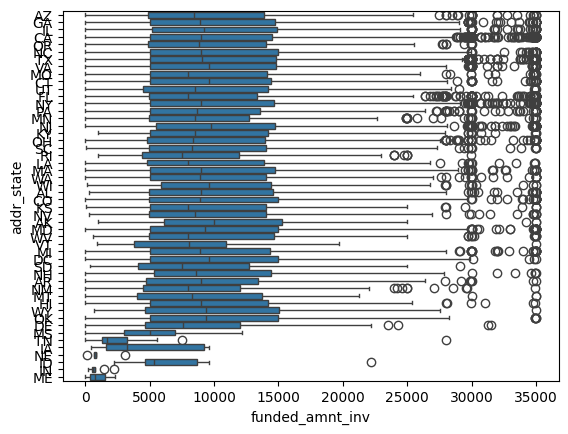

Box Plot of funded_amnt_inv Vs earliest_cr_line


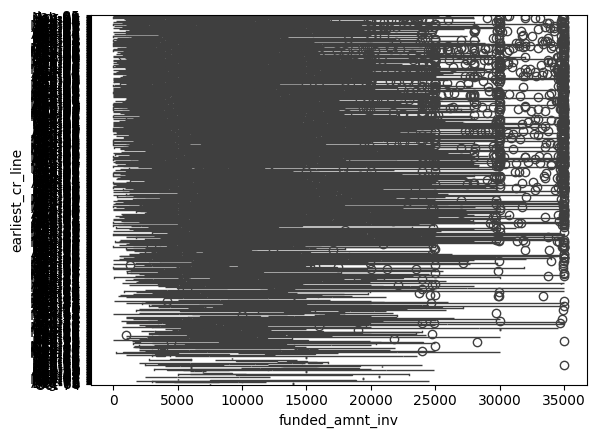

Box Plot of funded_amnt_inv Vs revol_util


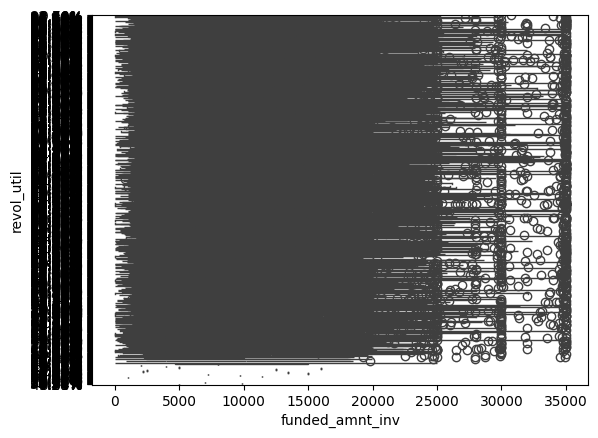

Box Plot of funded_amnt_inv Vs last_pymnt_d


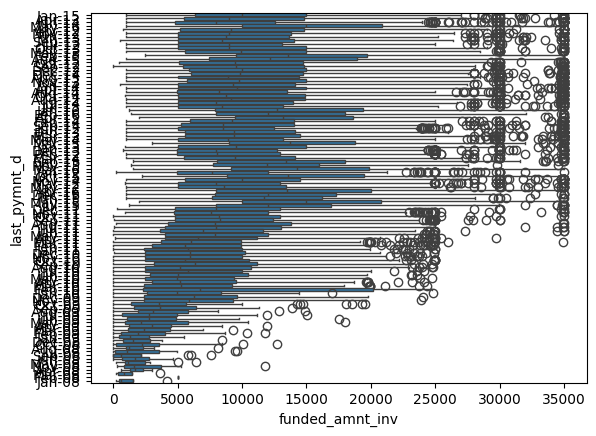

Box Plot of funded_amnt_inv Vs last_credit_pull_d


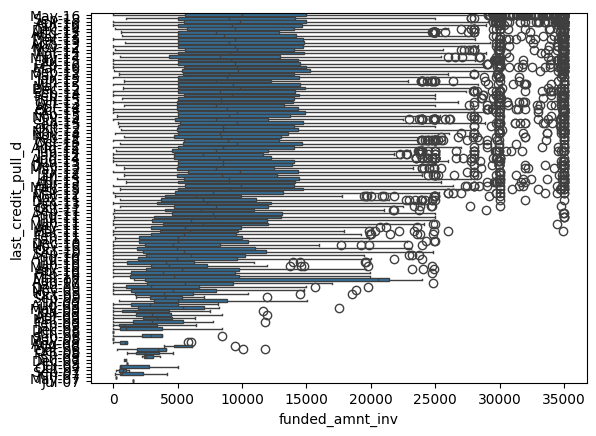

Box Plot of installment Vs term


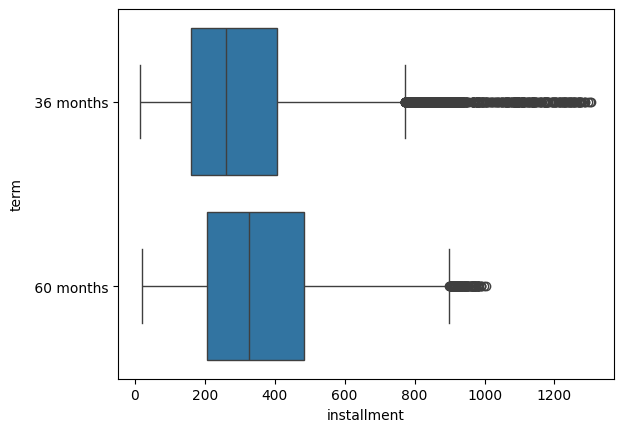

Box Plot of installment Vs int_rate


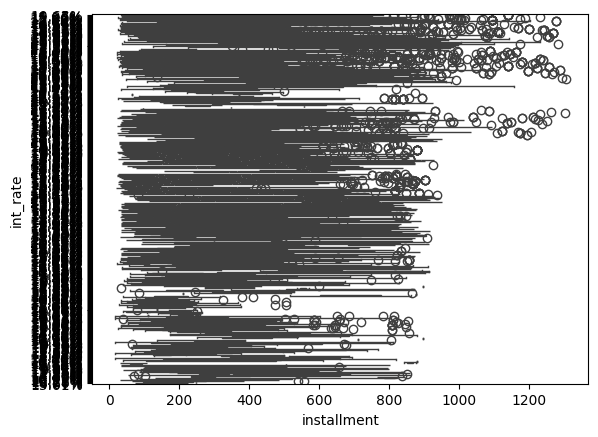

Box Plot of installment Vs grade


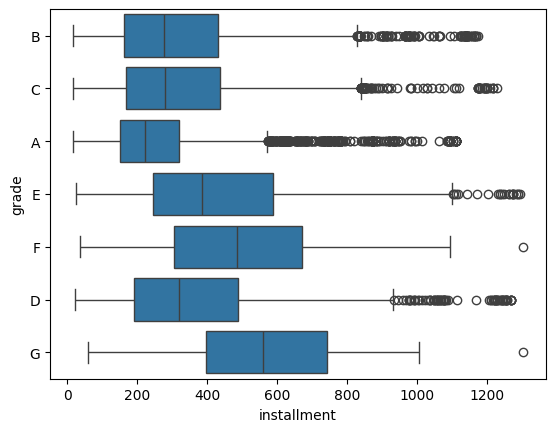

Box Plot of installment Vs sub_grade


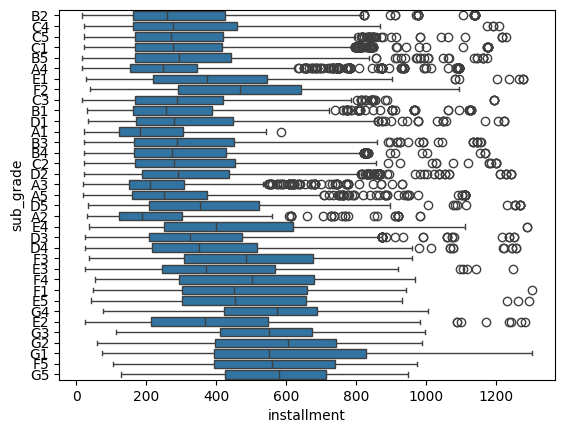

Box Plot of installment Vs emp_length


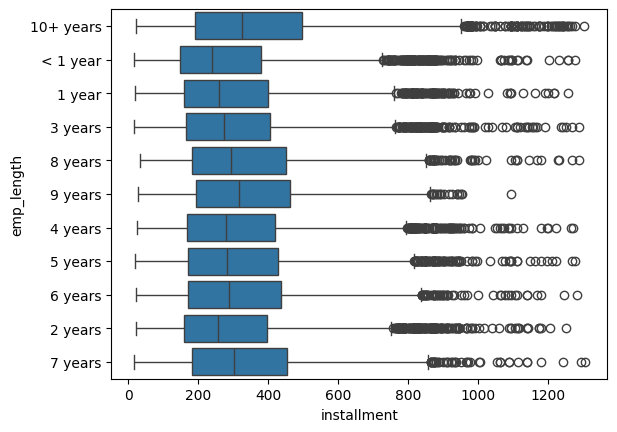

Box Plot of installment Vs home_ownership


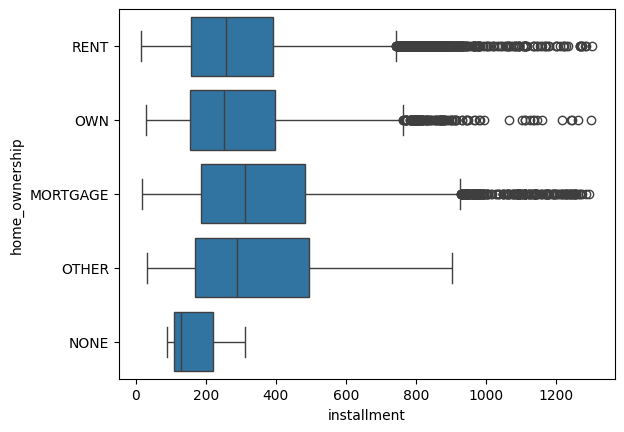

Box Plot of installment Vs verification_status


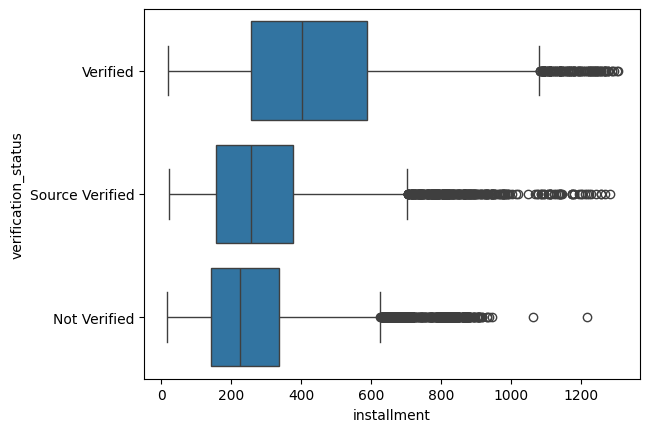

Box Plot of installment Vs issue_d


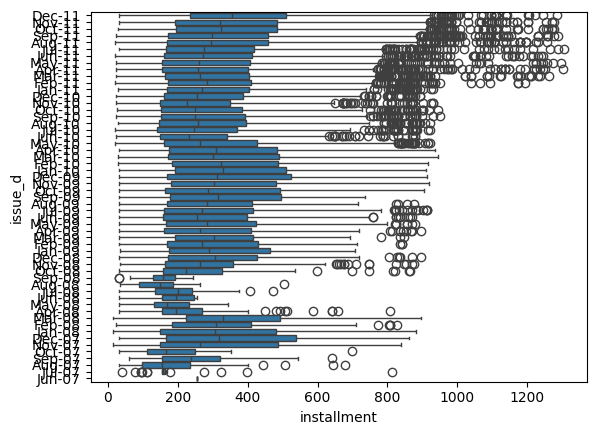

Box Plot of installment Vs loan_status


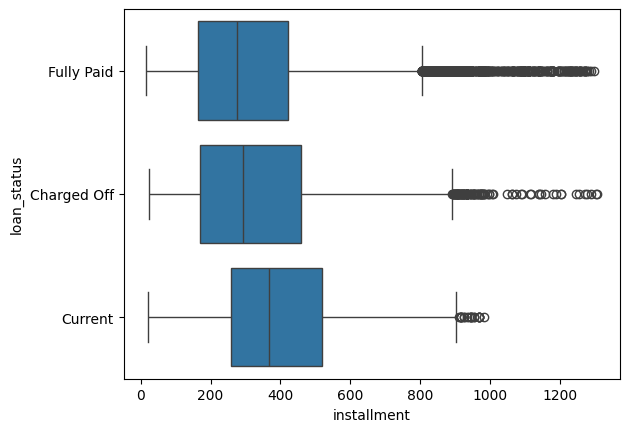

Box Plot of installment Vs purpose


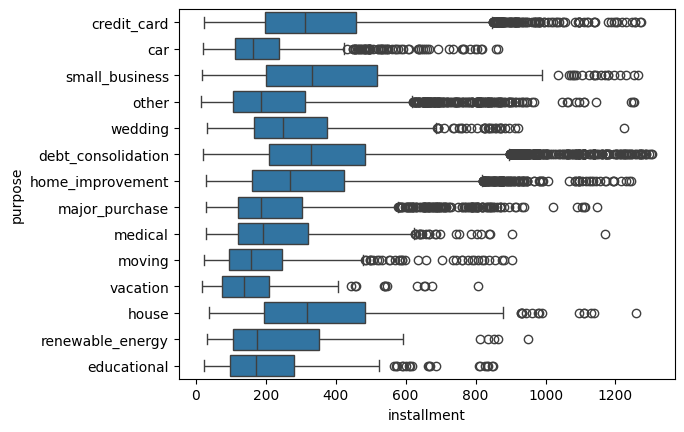

Box Plot of installment Vs zip_code


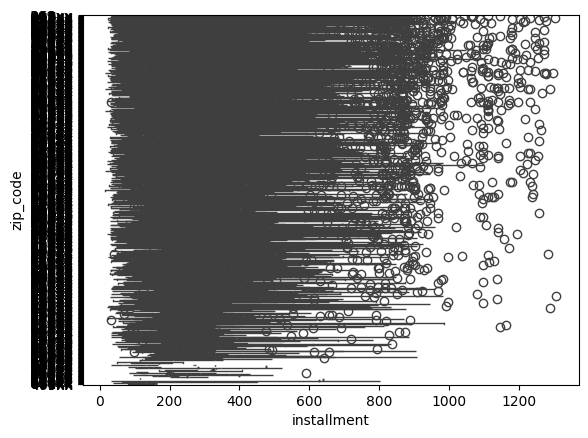

Box Plot of installment Vs addr_state


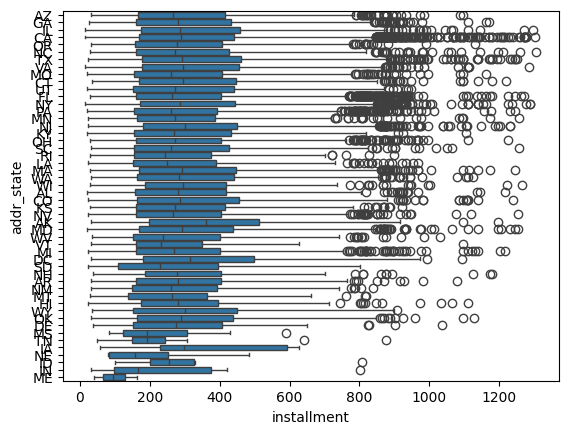

Box Plot of installment Vs earliest_cr_line


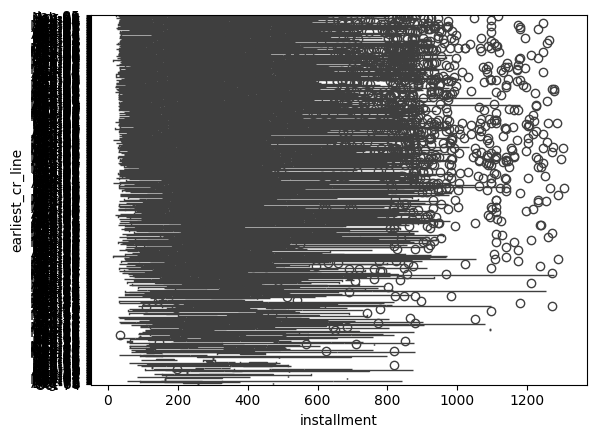

Box Plot of installment Vs revol_util


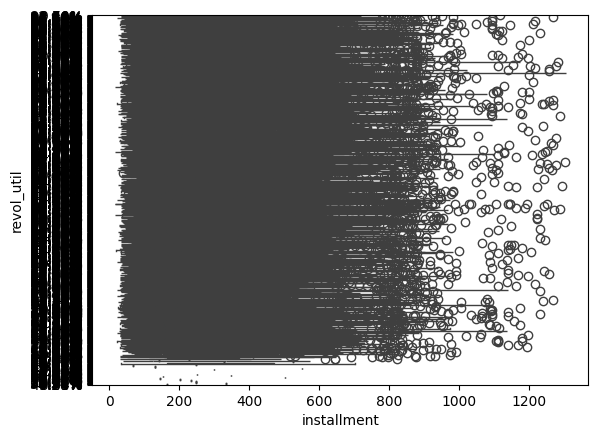

Box Plot of installment Vs last_pymnt_d


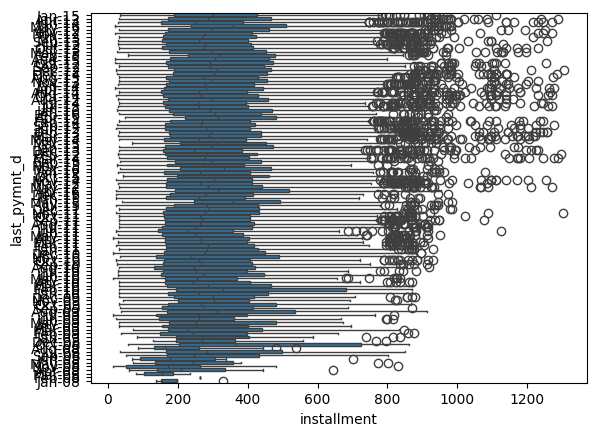

Box Plot of installment Vs last_credit_pull_d


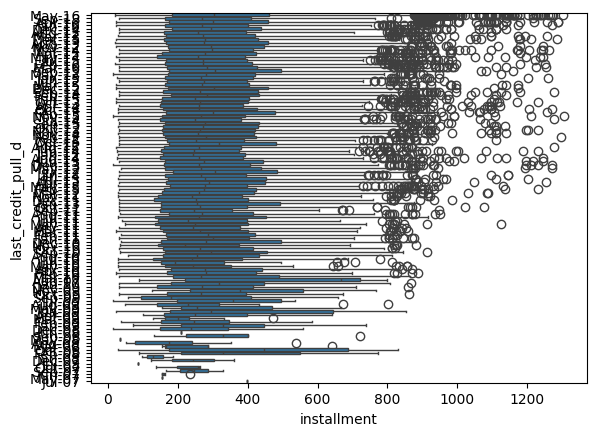

Box Plot of annual_inc Vs term


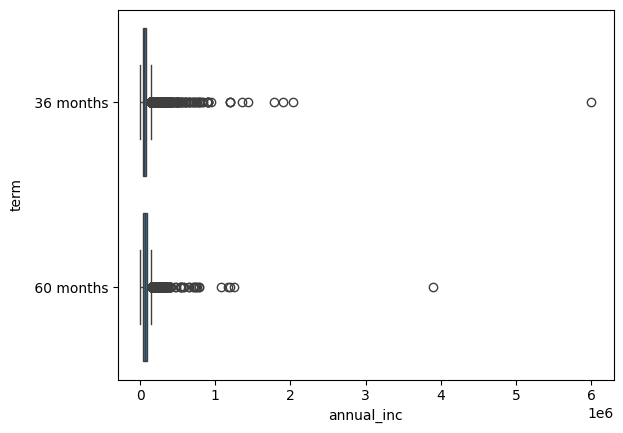

Box Plot of annual_inc Vs int_rate


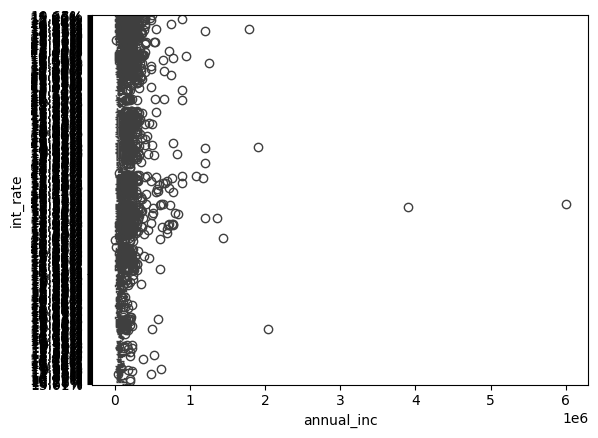

Box Plot of annual_inc Vs grade


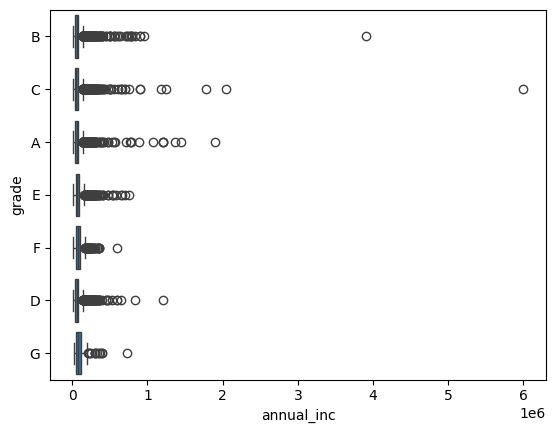

Box Plot of annual_inc Vs sub_grade


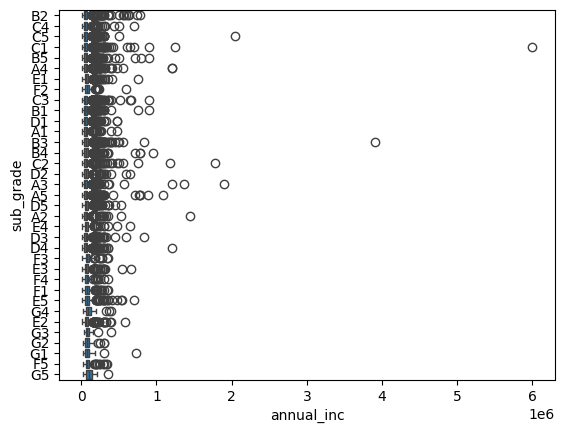

Box Plot of annual_inc Vs emp_length


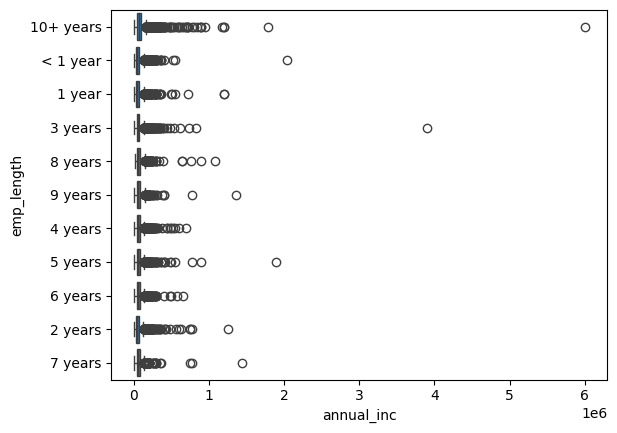

Box Plot of annual_inc Vs home_ownership


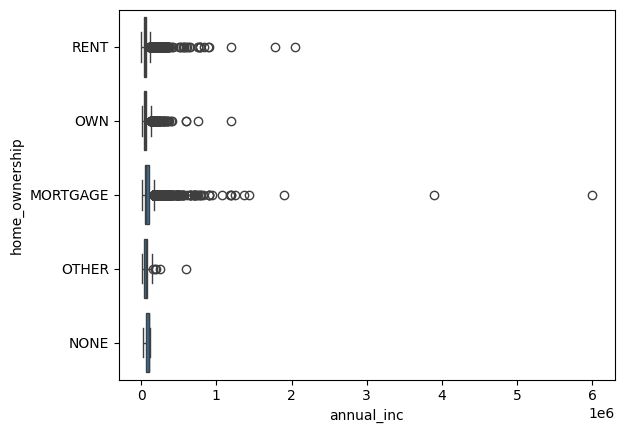

Box Plot of annual_inc Vs verification_status


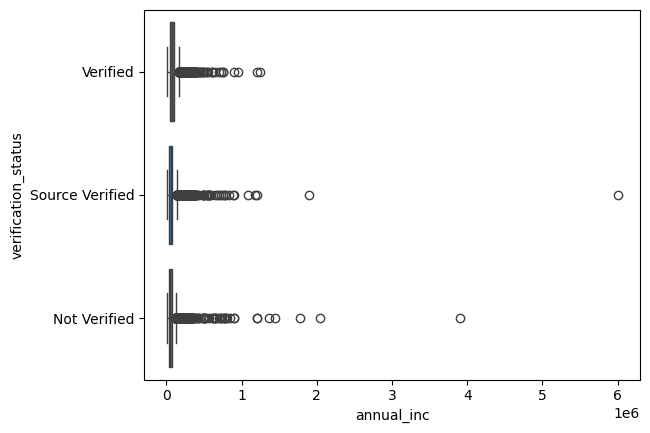

Box Plot of annual_inc Vs issue_d


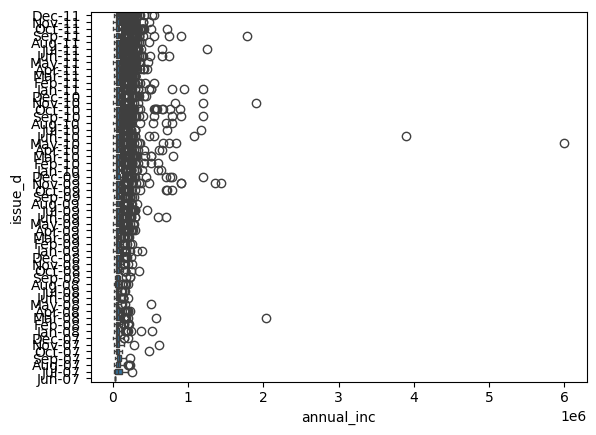

Box Plot of annual_inc Vs loan_status


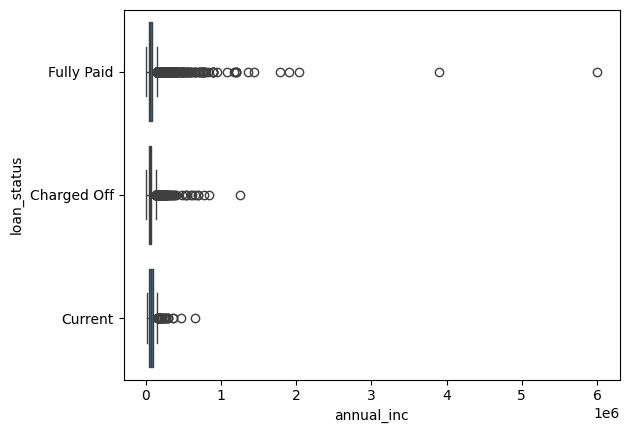

Box Plot of annual_inc Vs purpose


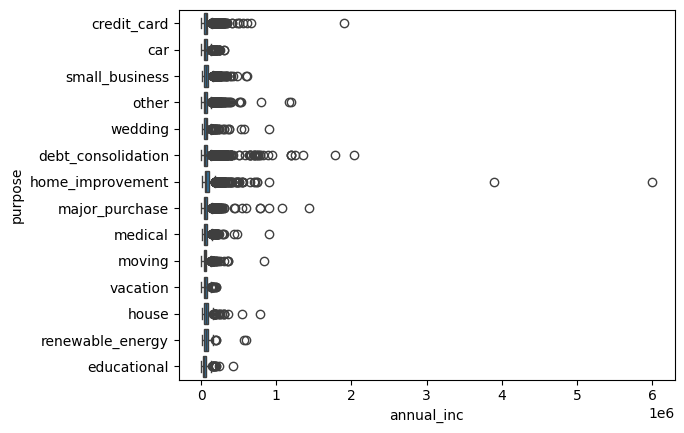

Box Plot of annual_inc Vs zip_code


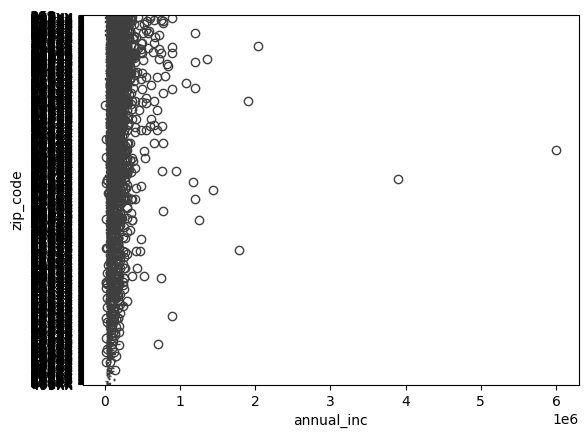

Box Plot of annual_inc Vs addr_state


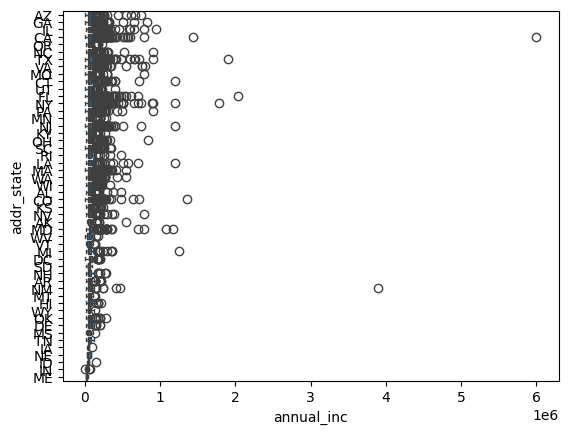

Box Plot of annual_inc Vs earliest_cr_line


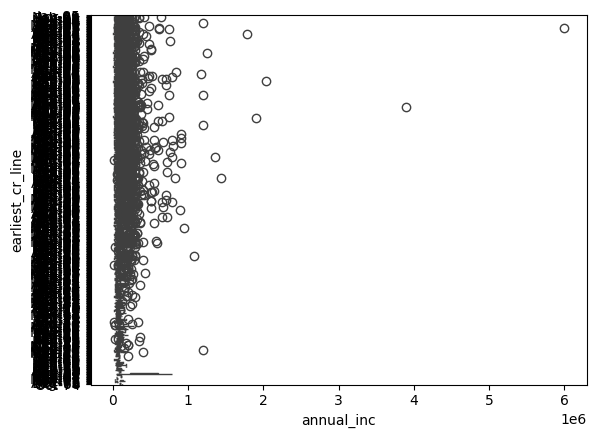

Box Plot of annual_inc Vs revol_util


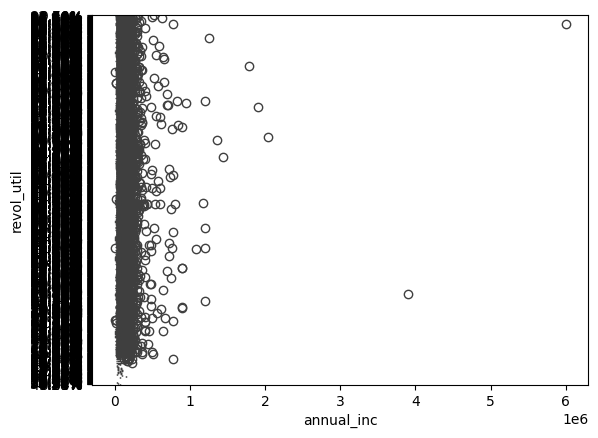

Box Plot of annual_inc Vs last_pymnt_d


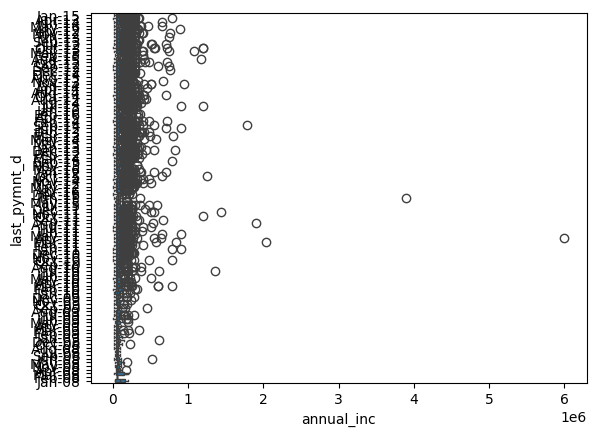

Box Plot of annual_inc Vs last_credit_pull_d


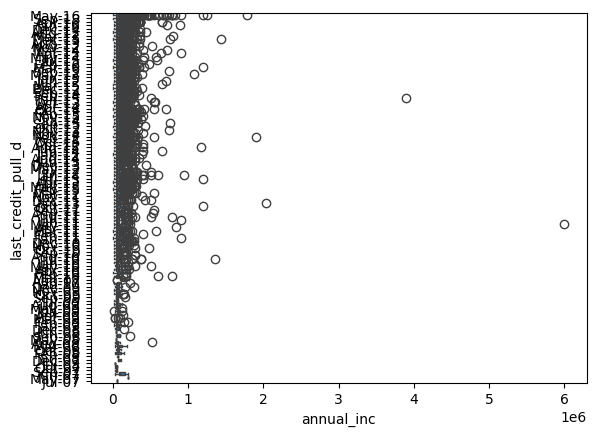

Box Plot of dti Vs term


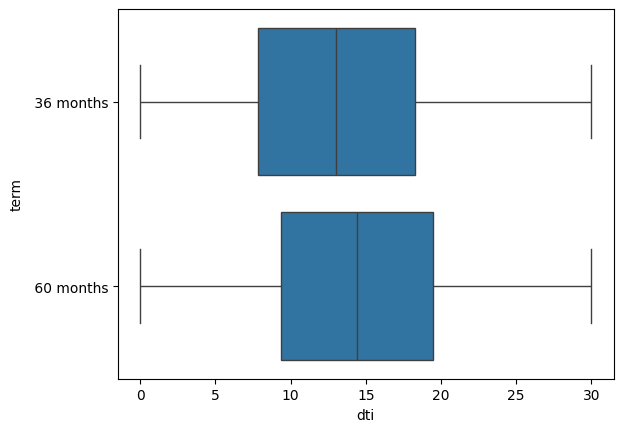

Box Plot of dti Vs int_rate


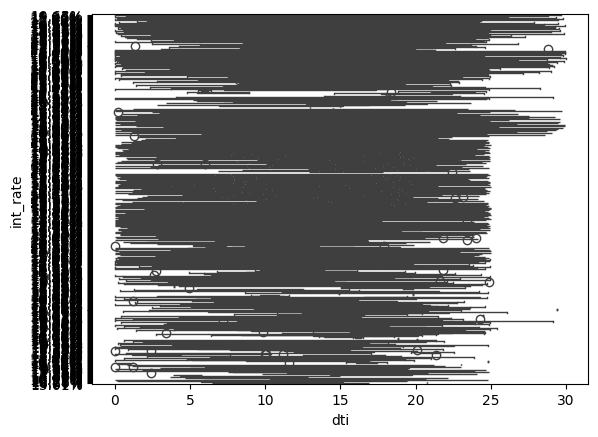

Box Plot of dti Vs grade


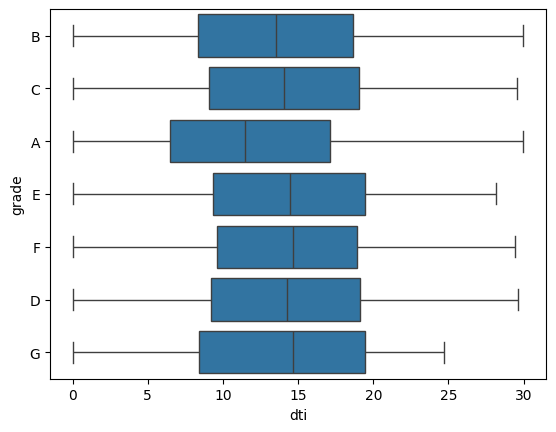

Box Plot of dti Vs sub_grade


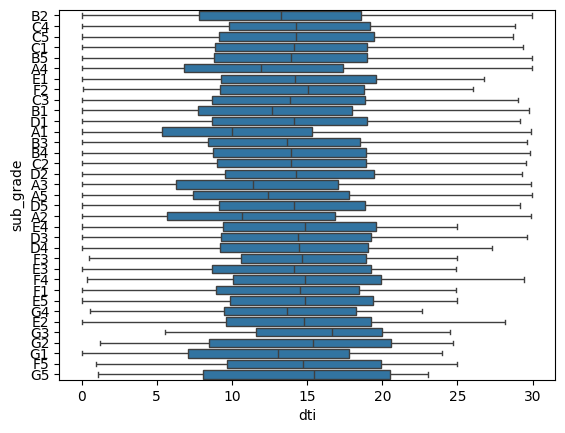

Box Plot of dti Vs emp_length


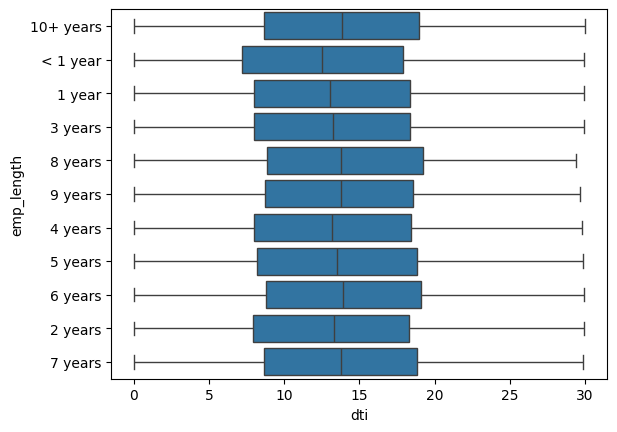

Box Plot of dti Vs home_ownership


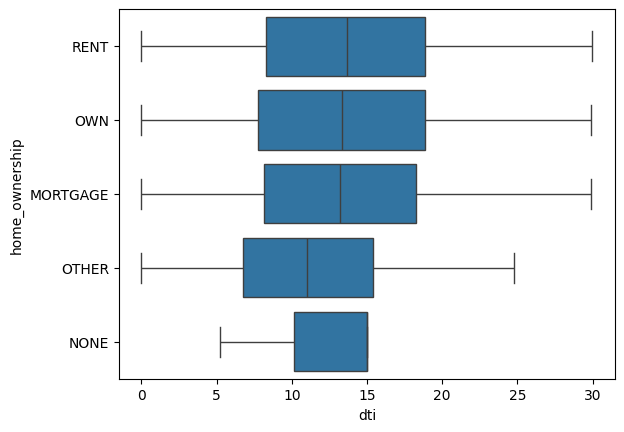

Box Plot of dti Vs verification_status


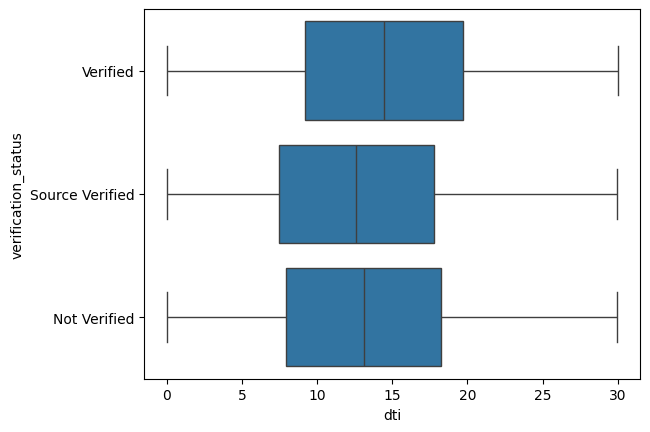

Box Plot of dti Vs issue_d


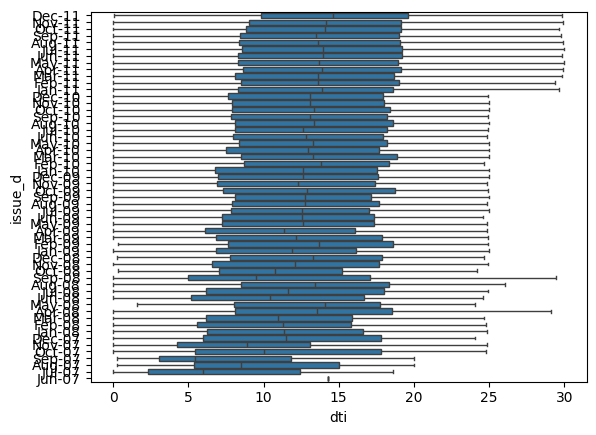

Box Plot of dti Vs loan_status


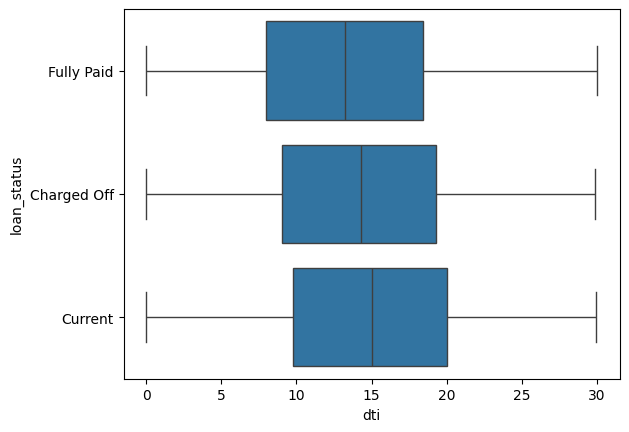

Box Plot of dti Vs purpose


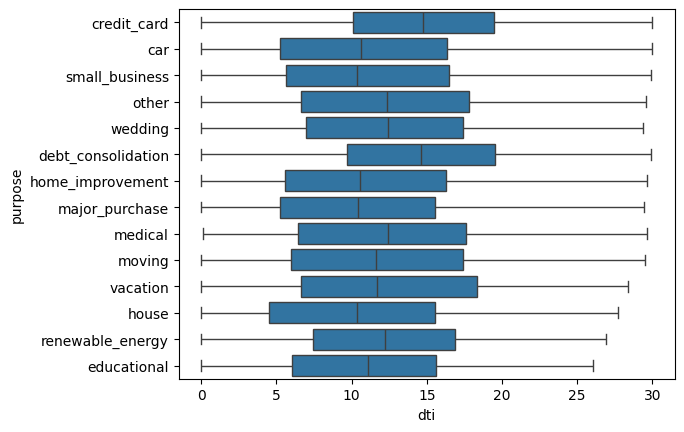

Box Plot of dti Vs zip_code


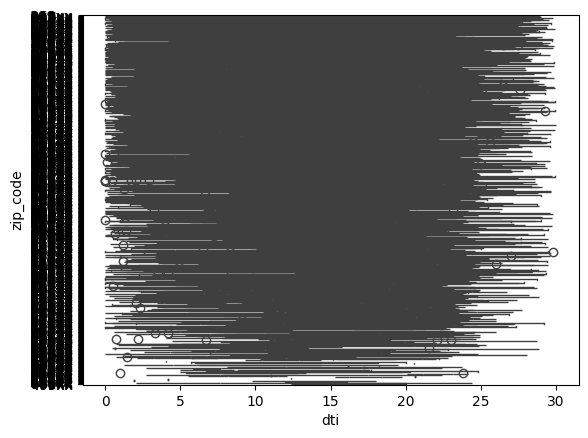

Box Plot of dti Vs addr_state


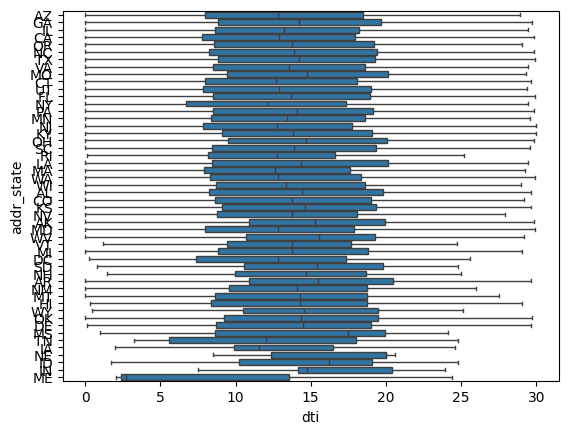

Box Plot of dti Vs earliest_cr_line


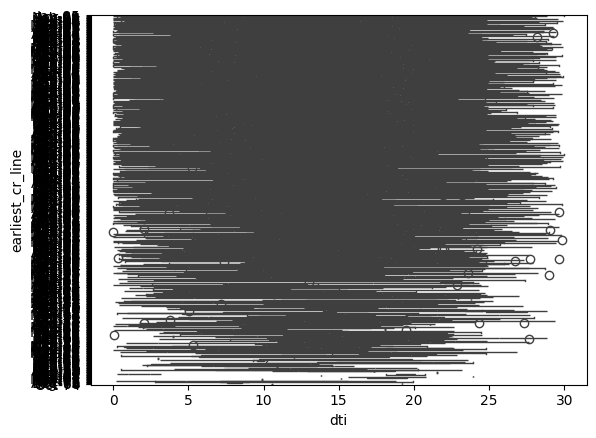

Box Plot of dti Vs revol_util


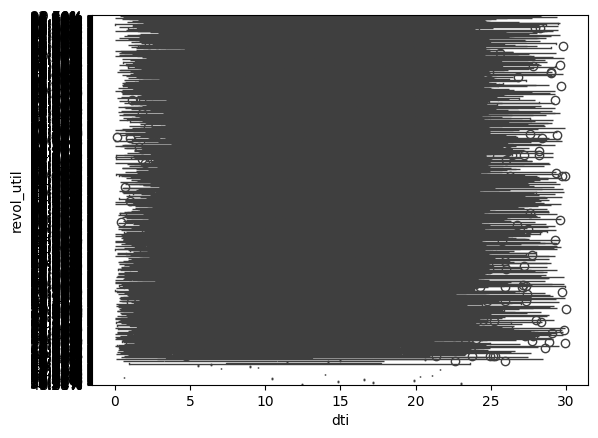

Box Plot of dti Vs last_pymnt_d


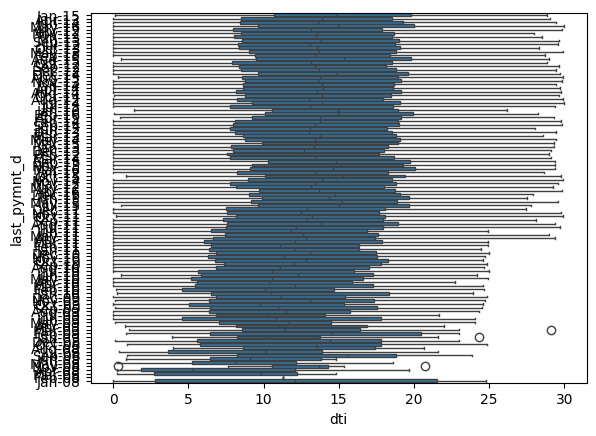

Box Plot of dti Vs last_credit_pull_d


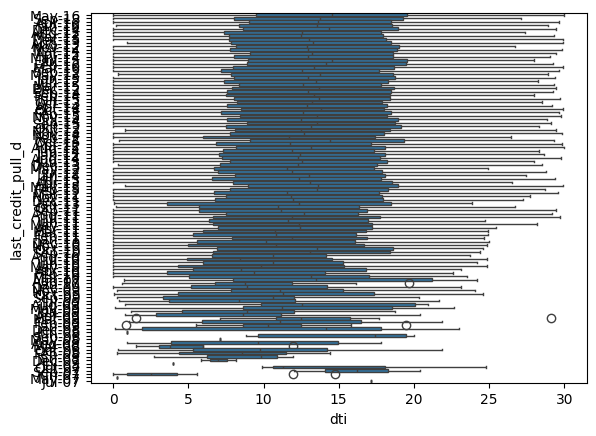

Box Plot of inq_last_6mths Vs term


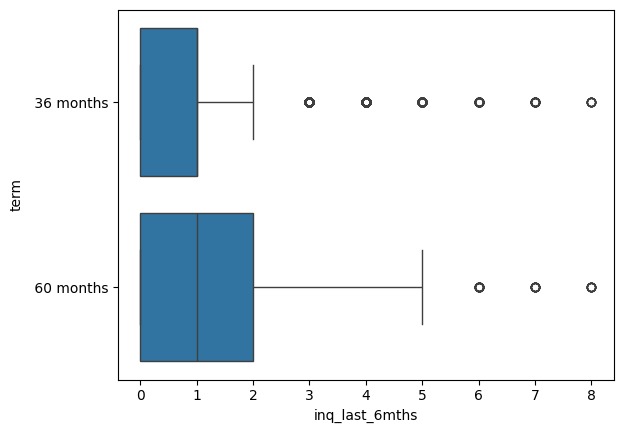

Box Plot of inq_last_6mths Vs int_rate


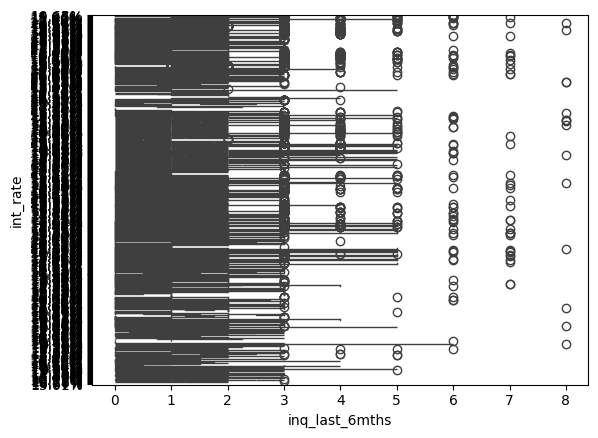

Box Plot of inq_last_6mths Vs grade


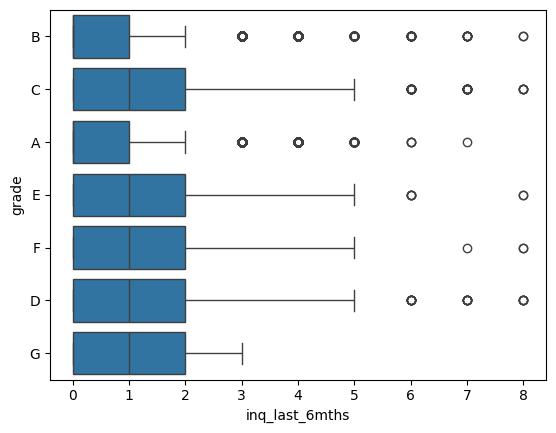

Box Plot of inq_last_6mths Vs sub_grade


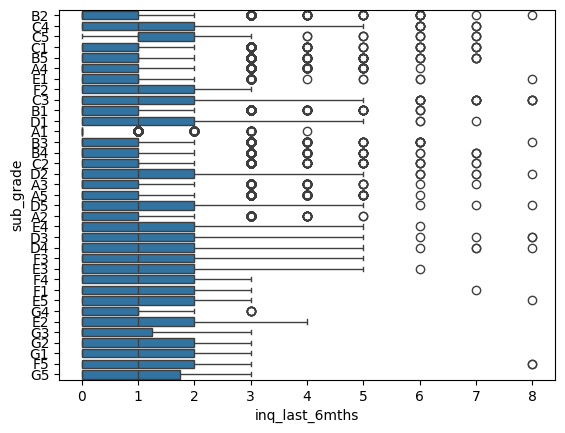

Box Plot of inq_last_6mths Vs emp_length


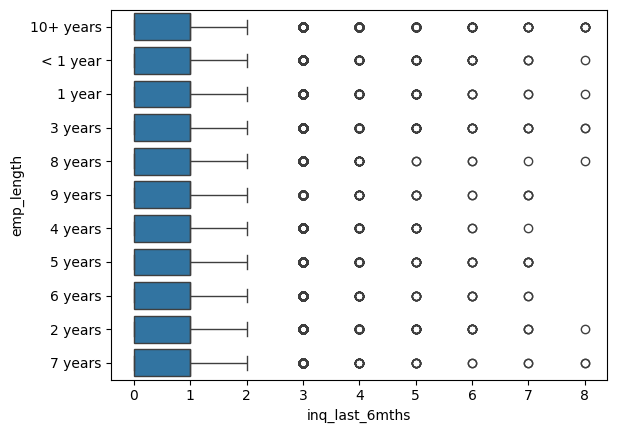

Box Plot of inq_last_6mths Vs home_ownership


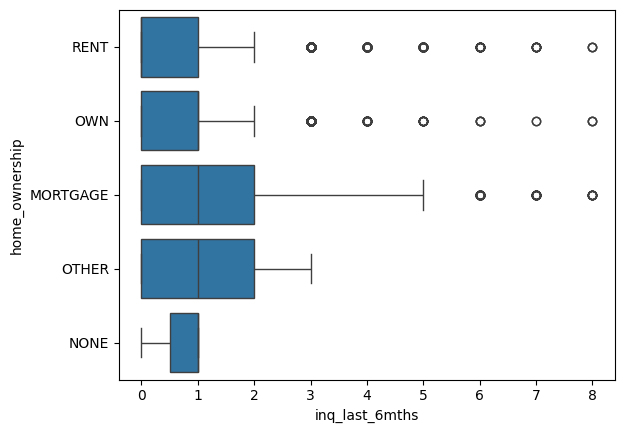

Box Plot of inq_last_6mths Vs verification_status


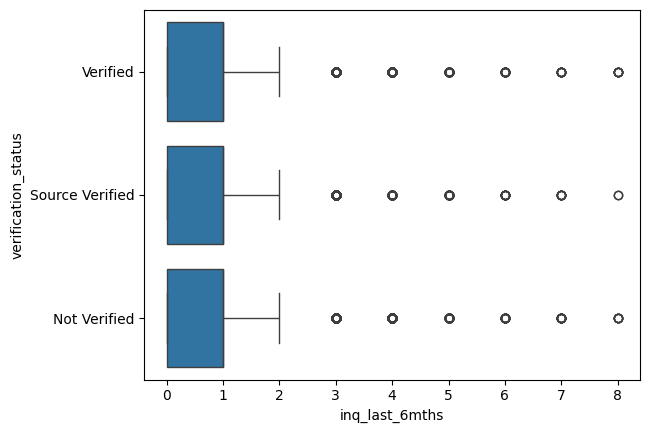

Box Plot of inq_last_6mths Vs issue_d


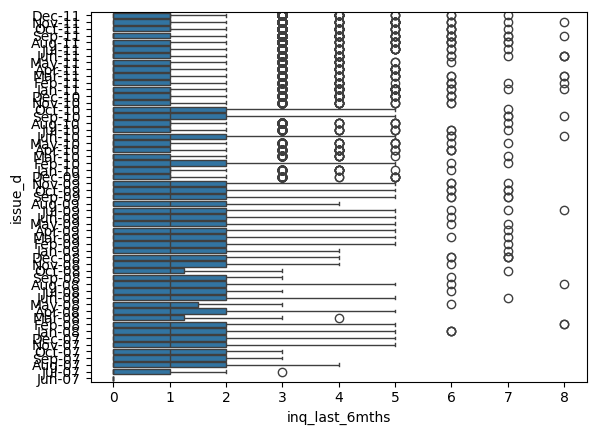

Box Plot of inq_last_6mths Vs loan_status


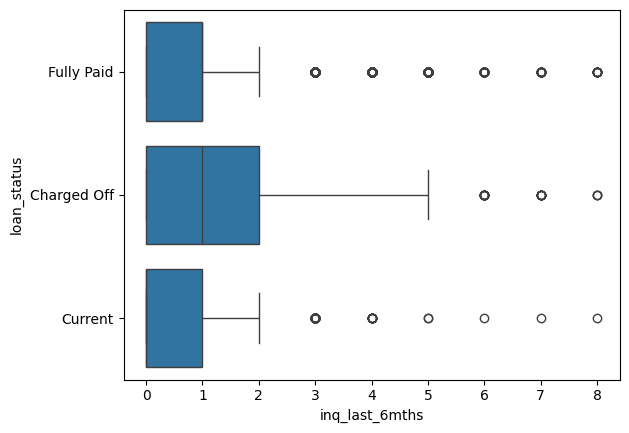

Box Plot of inq_last_6mths Vs purpose


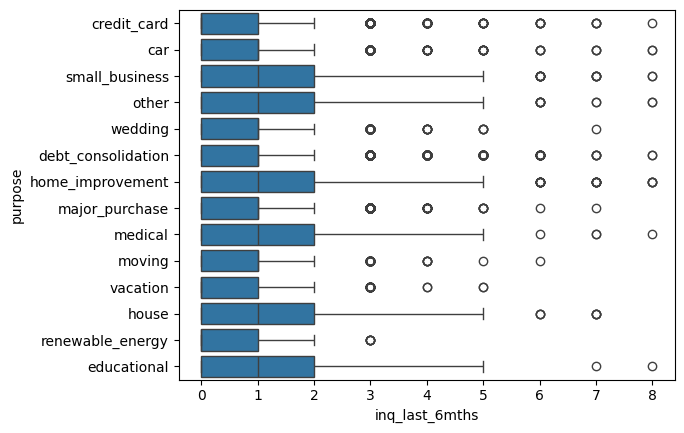

Box Plot of inq_last_6mths Vs zip_code


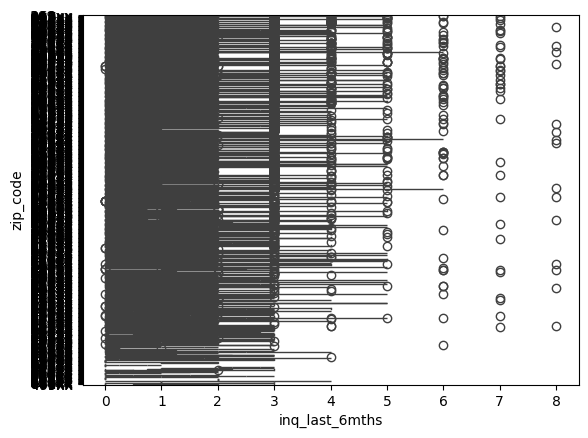

Box Plot of inq_last_6mths Vs addr_state


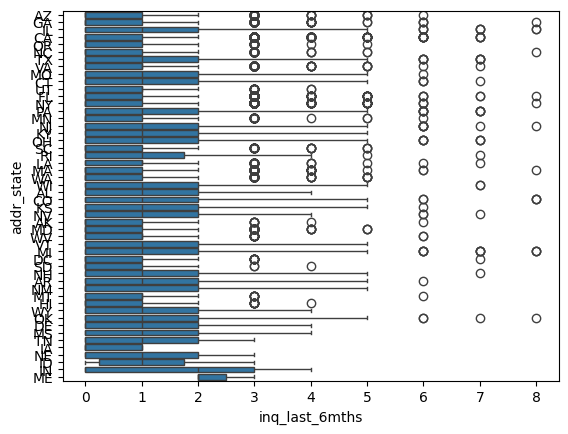

Box Plot of inq_last_6mths Vs earliest_cr_line


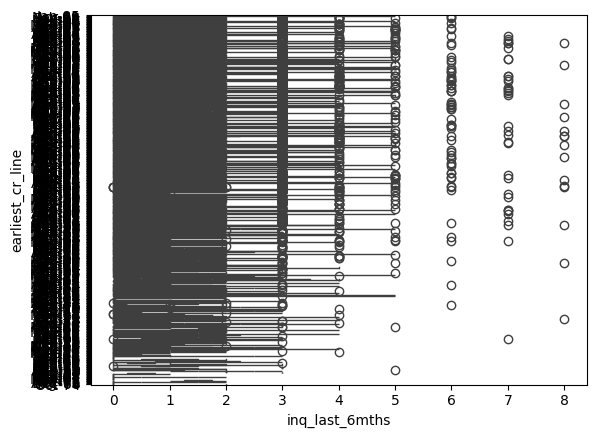

Box Plot of inq_last_6mths Vs revol_util


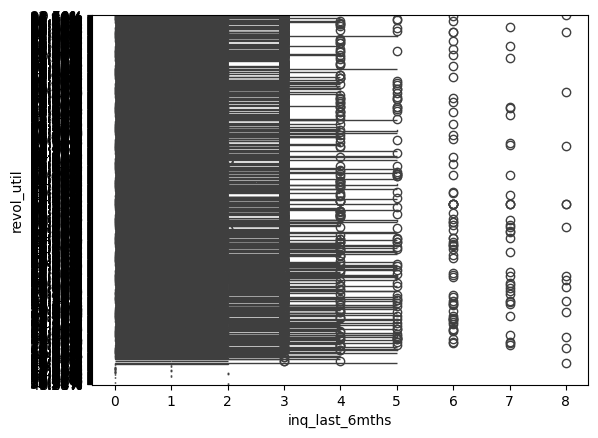

Box Plot of inq_last_6mths Vs last_pymnt_d


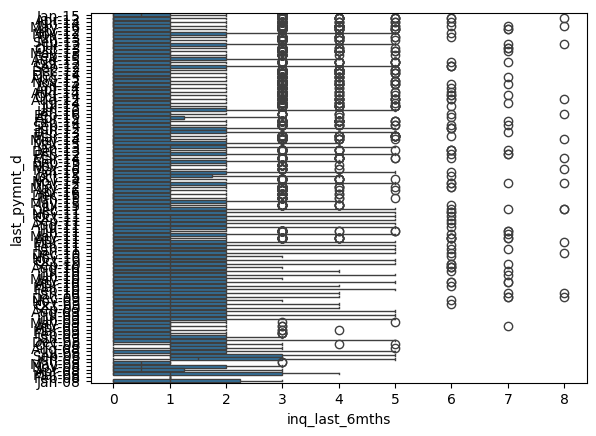

Box Plot of inq_last_6mths Vs last_credit_pull_d


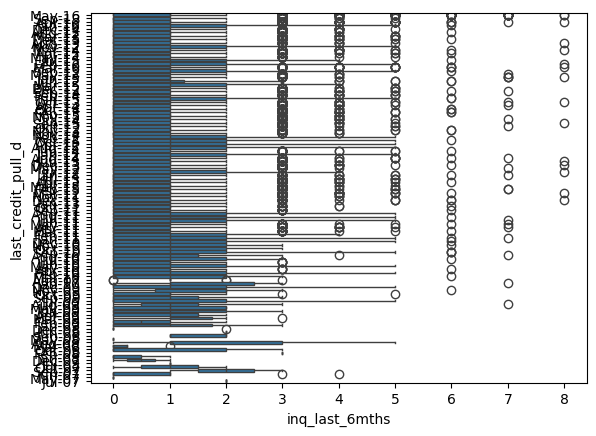

Box Plot of open_acc Vs term


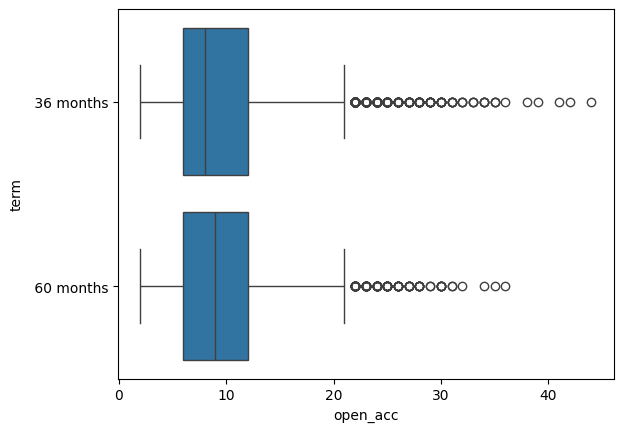

Box Plot of open_acc Vs int_rate


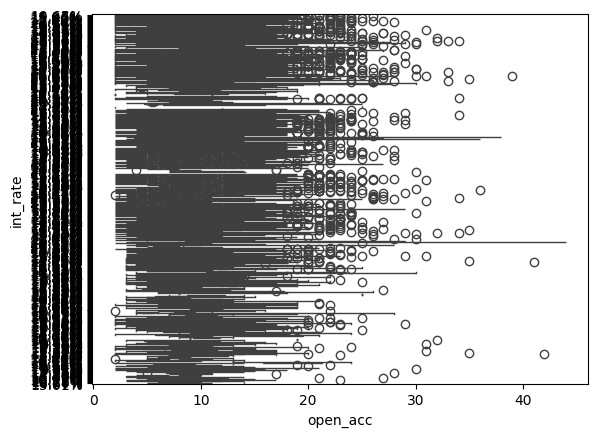

Box Plot of open_acc Vs grade


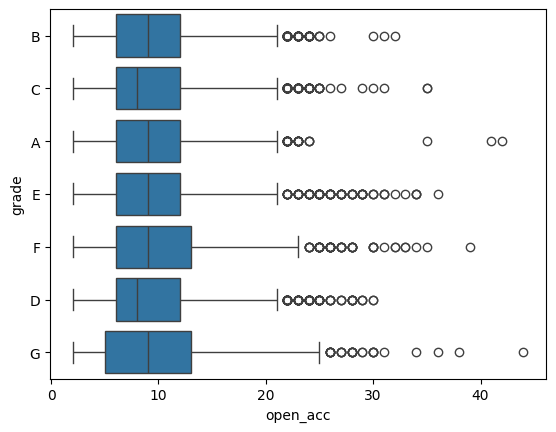

Box Plot of open_acc Vs sub_grade


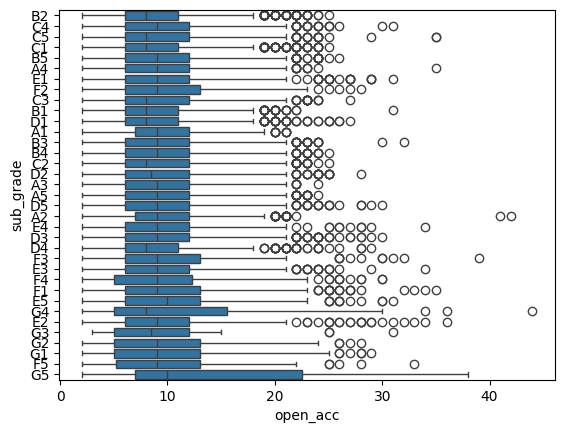

Box Plot of open_acc Vs emp_length


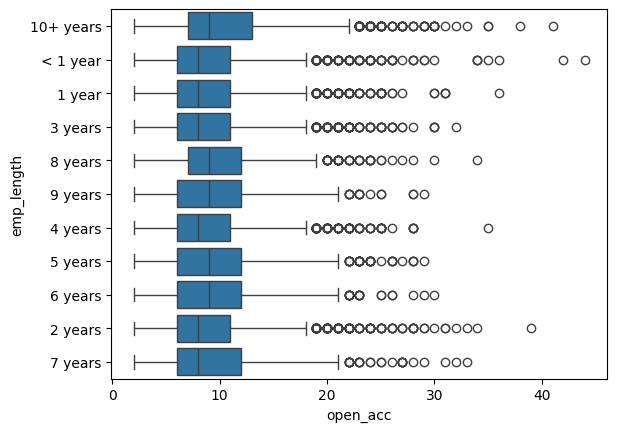

Box Plot of open_acc Vs home_ownership


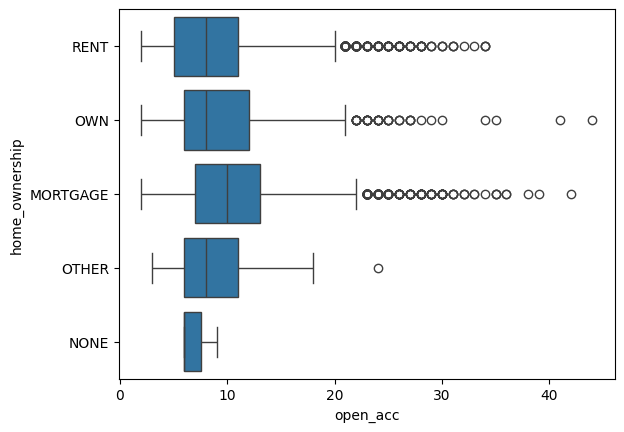

Box Plot of open_acc Vs verification_status


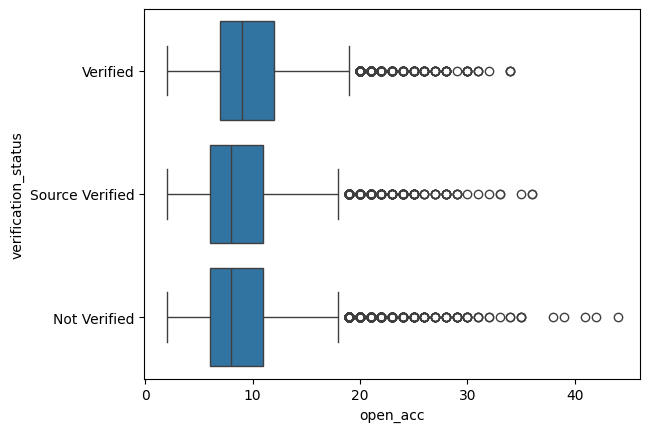

Box Plot of open_acc Vs issue_d


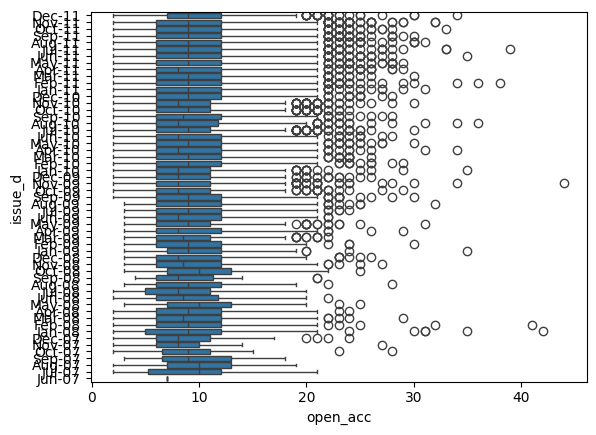

Box Plot of open_acc Vs loan_status


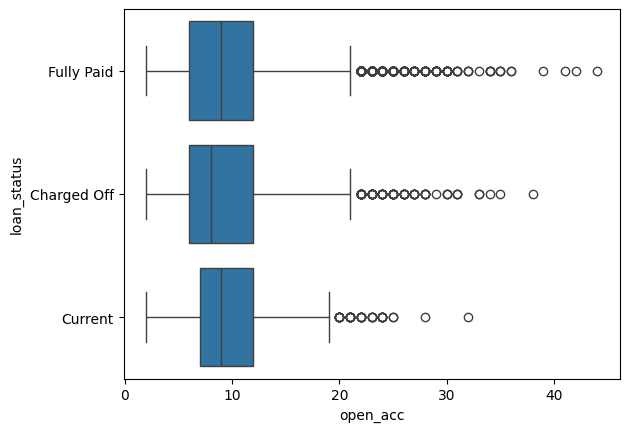

Box Plot of open_acc Vs purpose


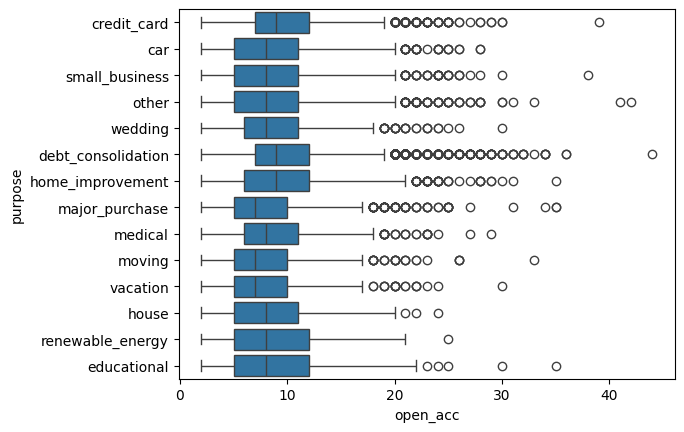

Box Plot of open_acc Vs zip_code


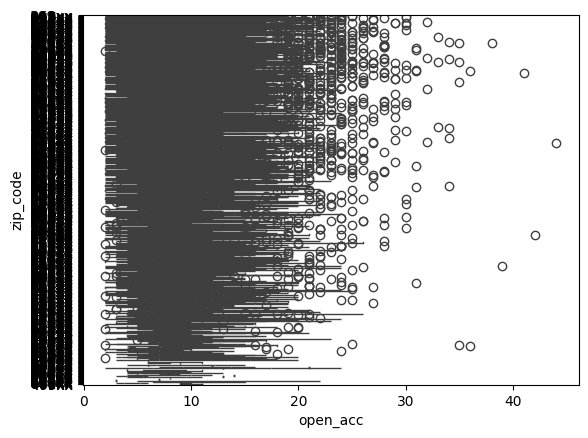

Box Plot of open_acc Vs addr_state


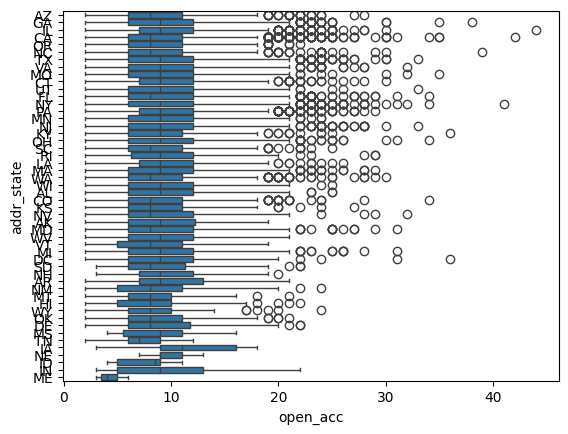

Box Plot of open_acc Vs earliest_cr_line


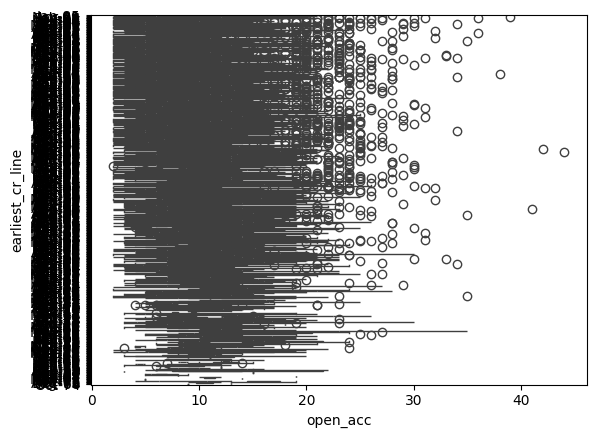

Box Plot of open_acc Vs revol_util


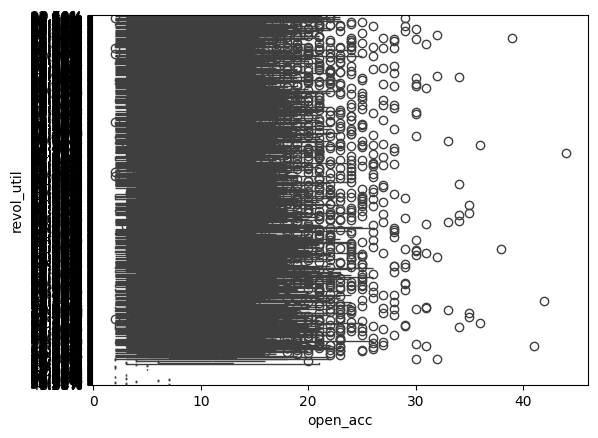

Box Plot of open_acc Vs last_pymnt_d


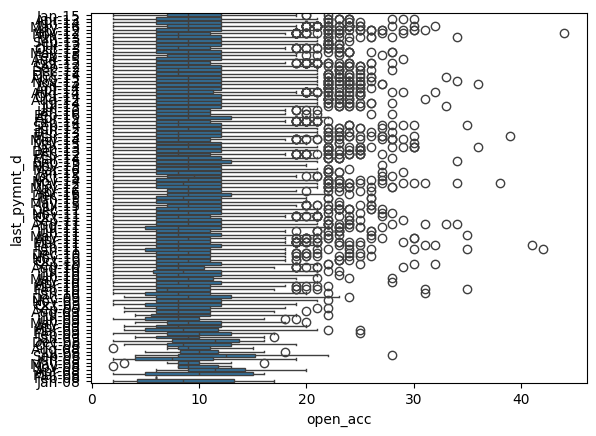

Box Plot of open_acc Vs last_credit_pull_d


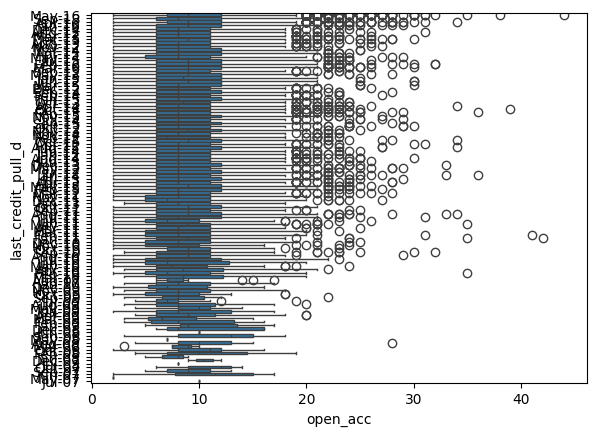

Box Plot of pub_rec Vs term


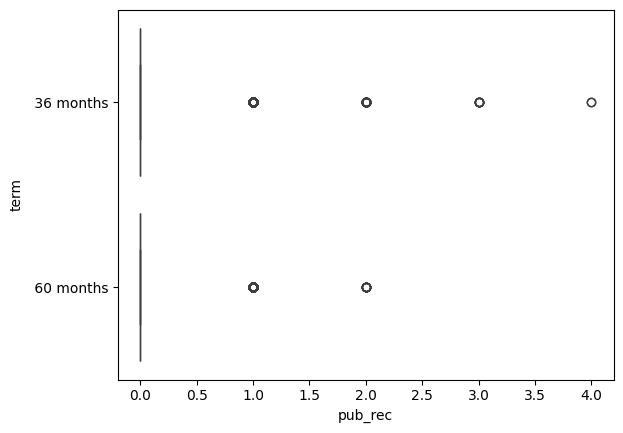

Box Plot of pub_rec Vs int_rate


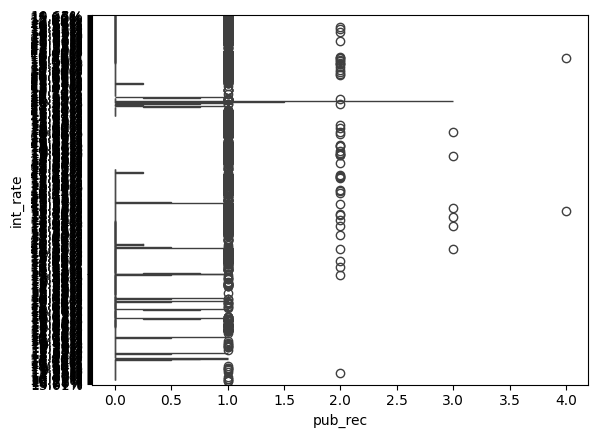

Box Plot of pub_rec Vs grade


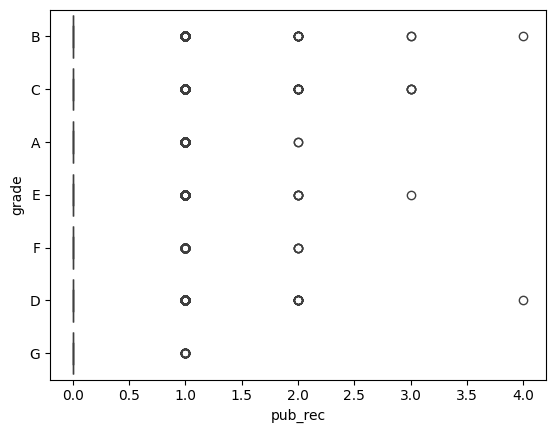

Box Plot of pub_rec Vs sub_grade


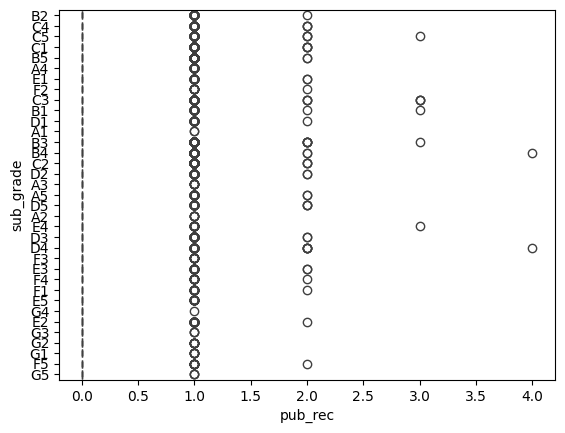

Box Plot of pub_rec Vs emp_length


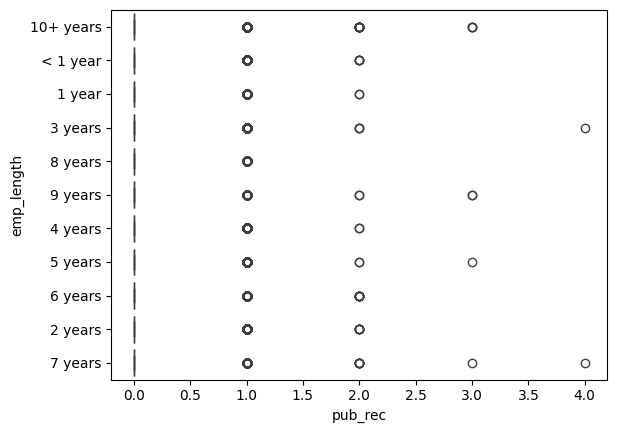

Box Plot of pub_rec Vs home_ownership


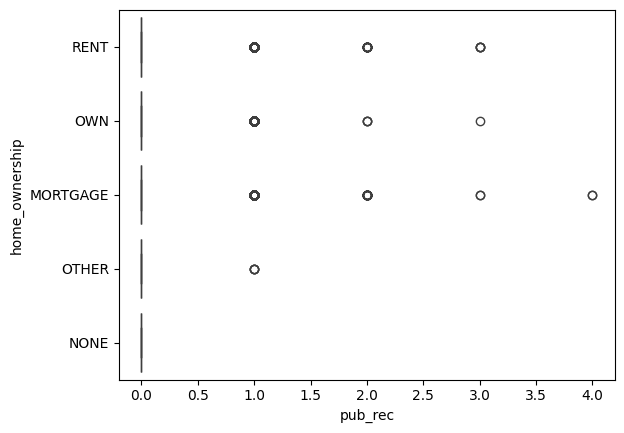

Box Plot of pub_rec Vs verification_status


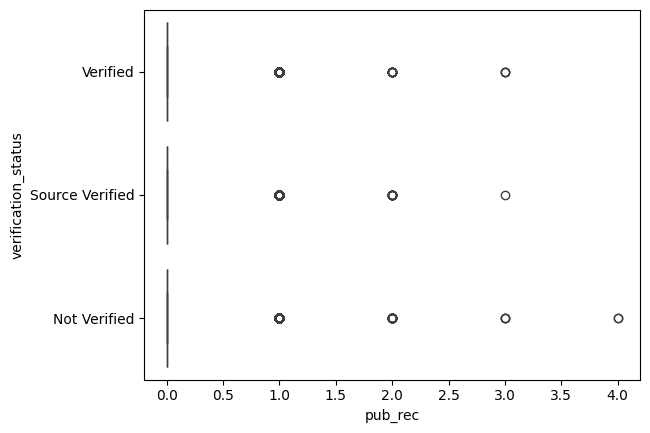

Box Plot of pub_rec Vs issue_d


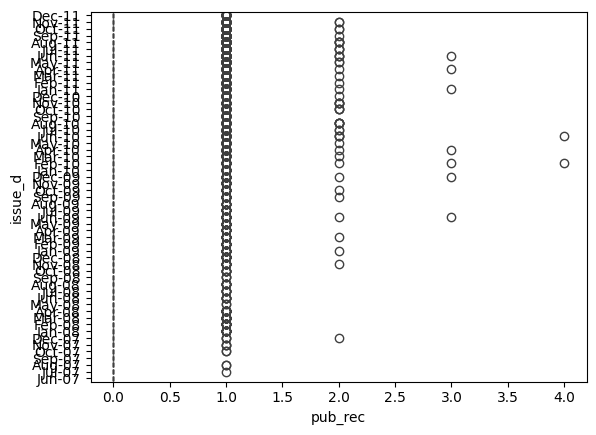

Box Plot of pub_rec Vs loan_status


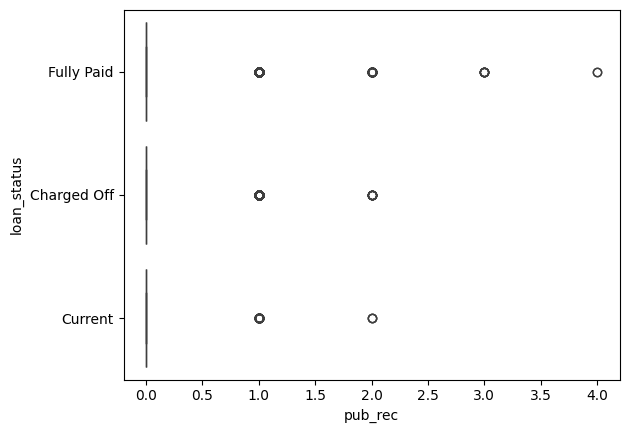

Box Plot of pub_rec Vs purpose


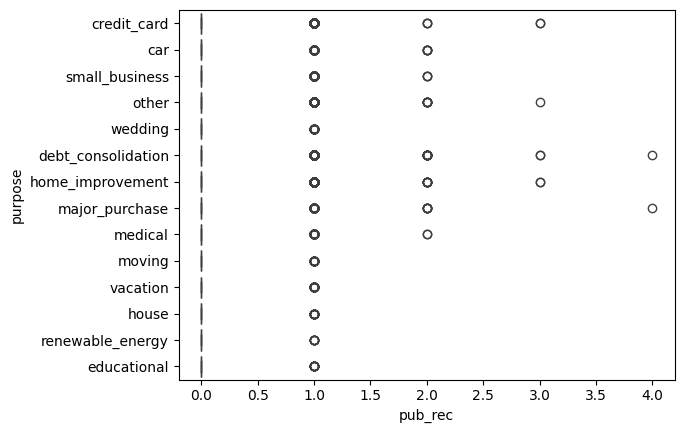

Box Plot of pub_rec Vs zip_code


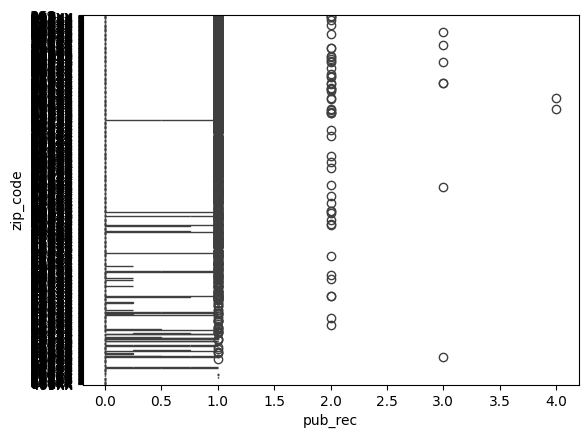

Box Plot of pub_rec Vs addr_state


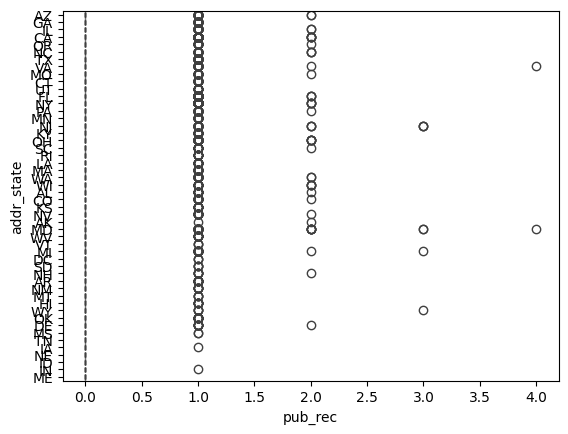

Box Plot of pub_rec Vs earliest_cr_line


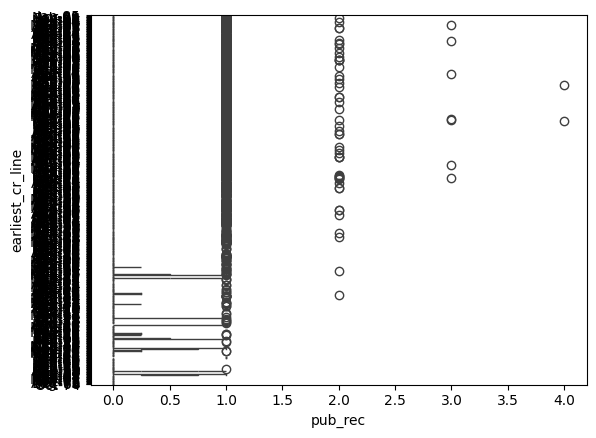

Box Plot of pub_rec Vs revol_util


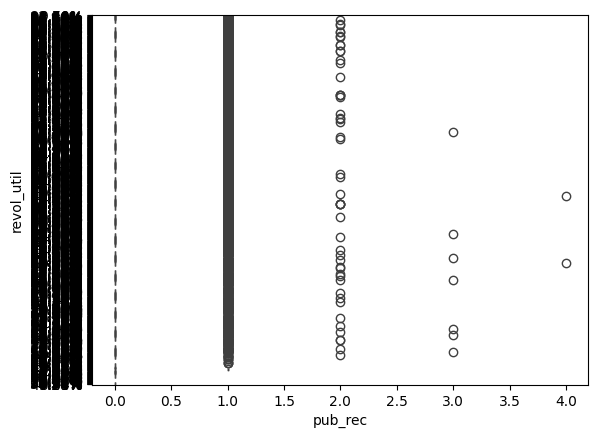

Box Plot of pub_rec Vs last_pymnt_d


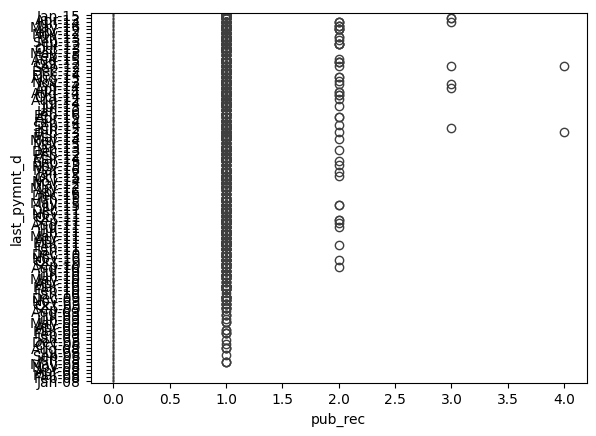

Box Plot of pub_rec Vs last_credit_pull_d


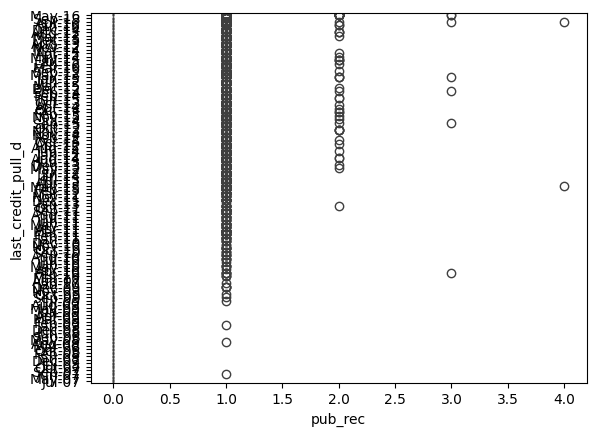

Box Plot of revol_bal Vs term


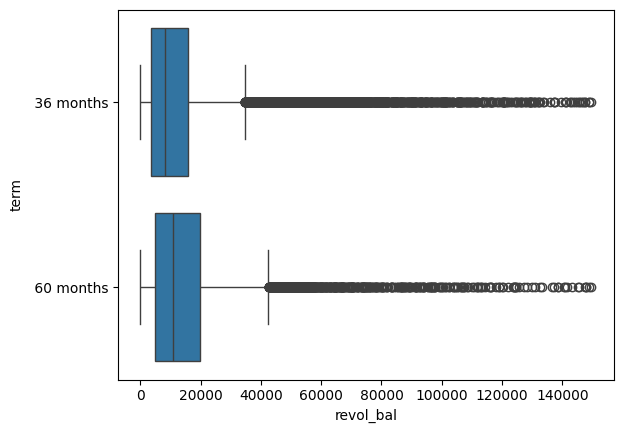

Box Plot of revol_bal Vs int_rate


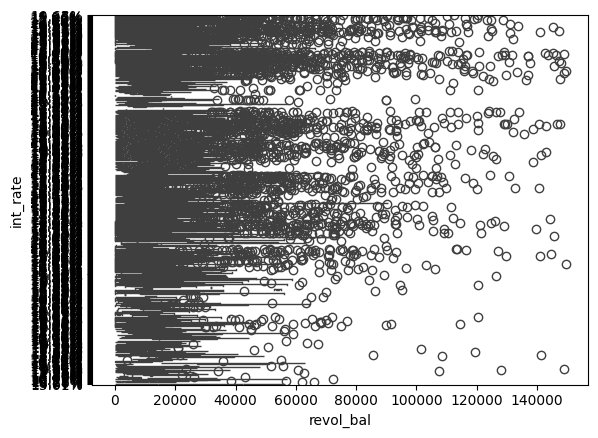

Box Plot of revol_bal Vs grade


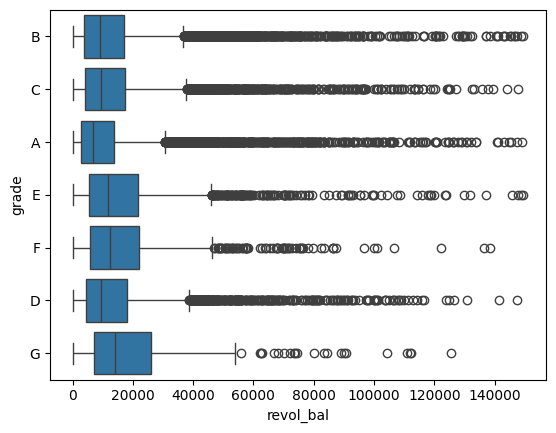

Box Plot of revol_bal Vs sub_grade


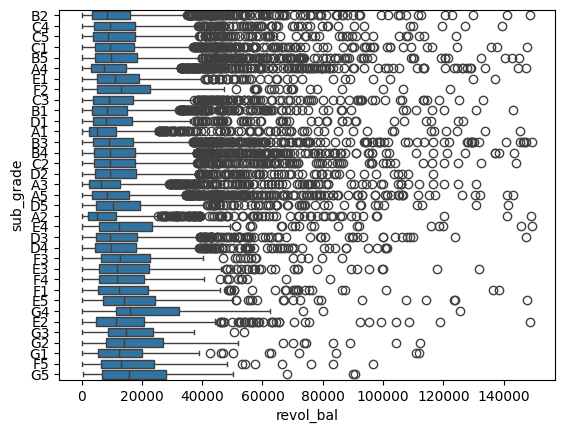

Box Plot of revol_bal Vs emp_length


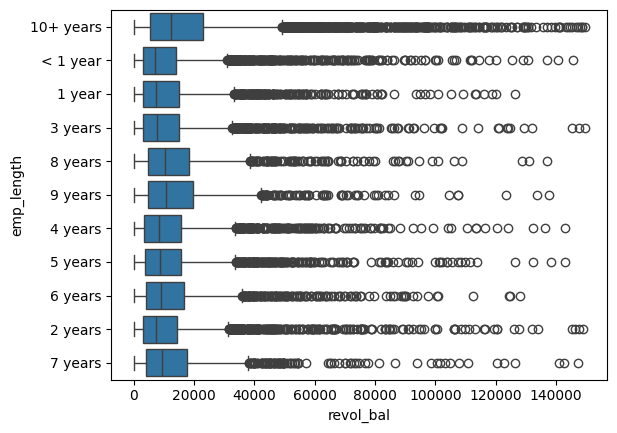

Box Plot of revol_bal Vs home_ownership


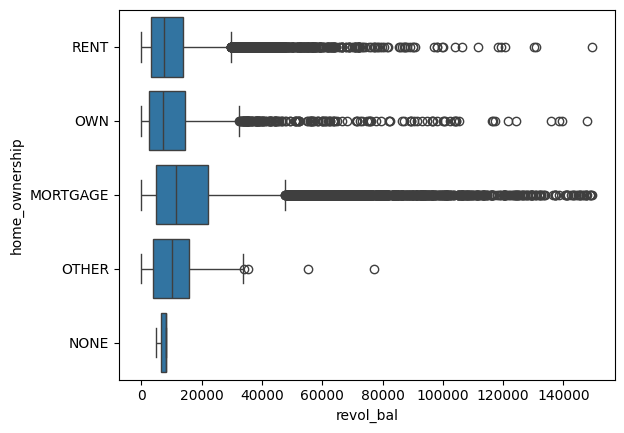

Box Plot of revol_bal Vs verification_status


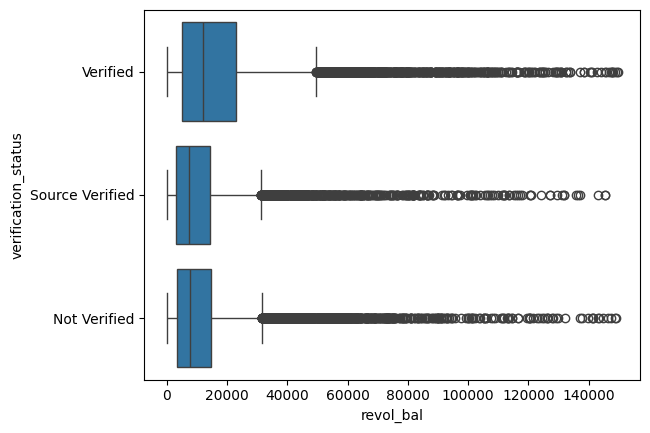

Box Plot of revol_bal Vs issue_d


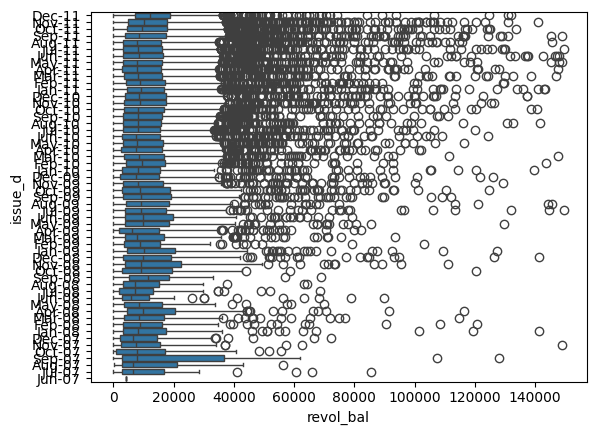

Box Plot of revol_bal Vs loan_status


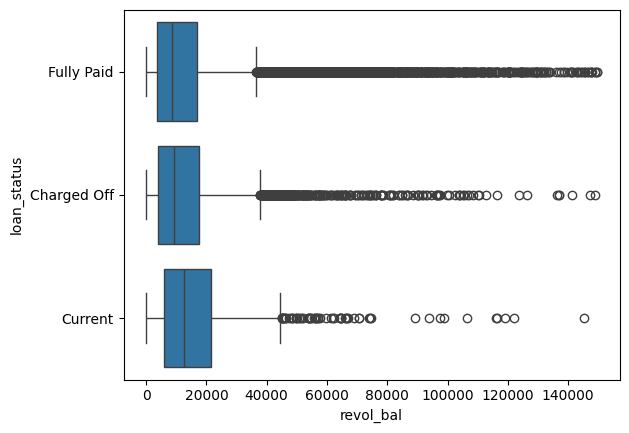

Box Plot of revol_bal Vs purpose


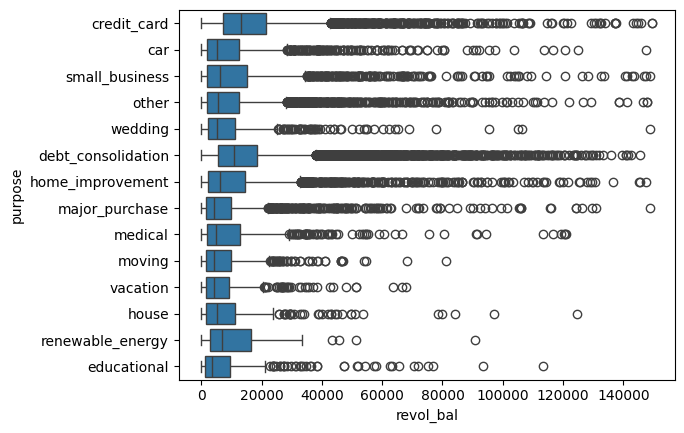

Box Plot of revol_bal Vs zip_code


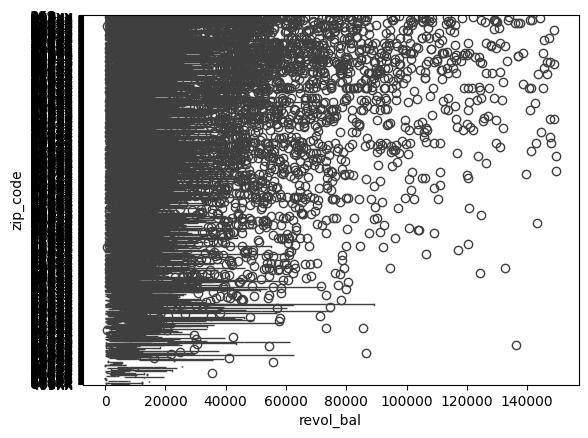

Box Plot of revol_bal Vs addr_state


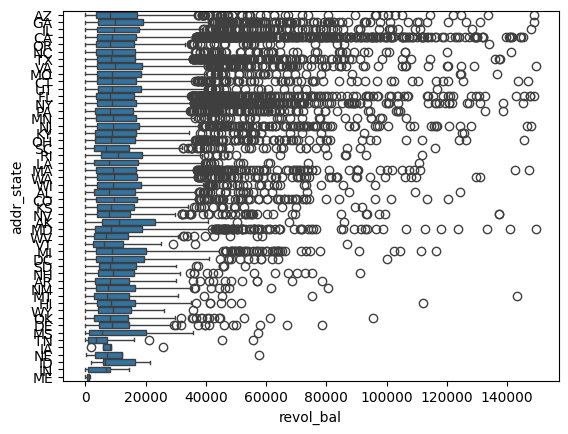

Box Plot of revol_bal Vs earliest_cr_line


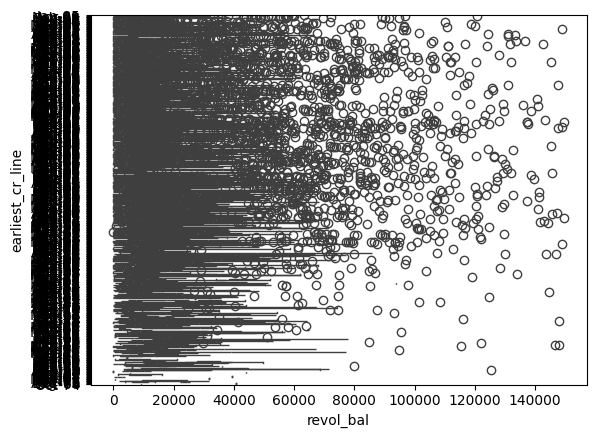

Box Plot of revol_bal Vs revol_util


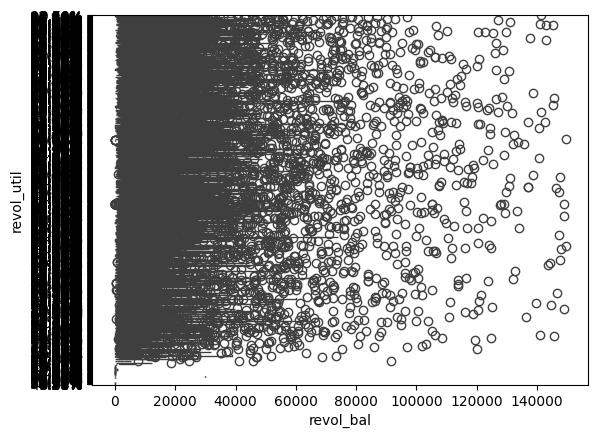

Box Plot of revol_bal Vs last_pymnt_d


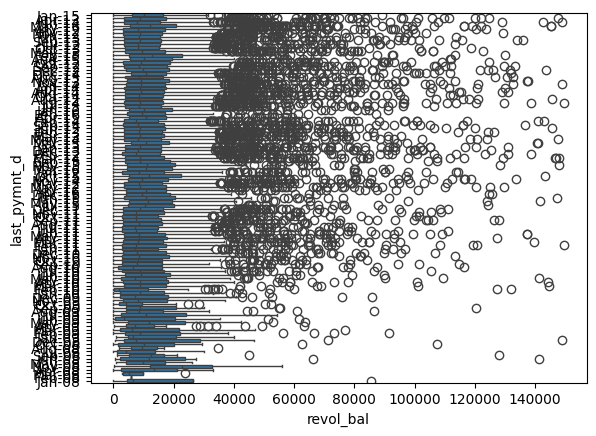

Box Plot of revol_bal Vs last_credit_pull_d


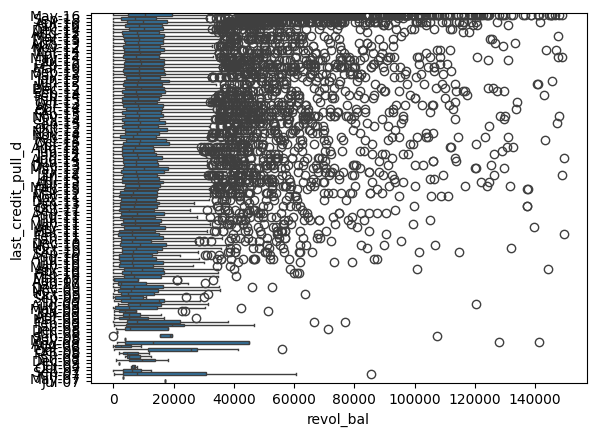

Box Plot of total_acc Vs term


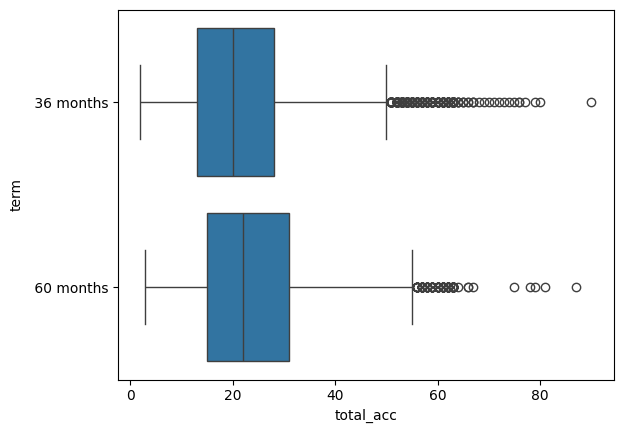

Box Plot of total_acc Vs int_rate


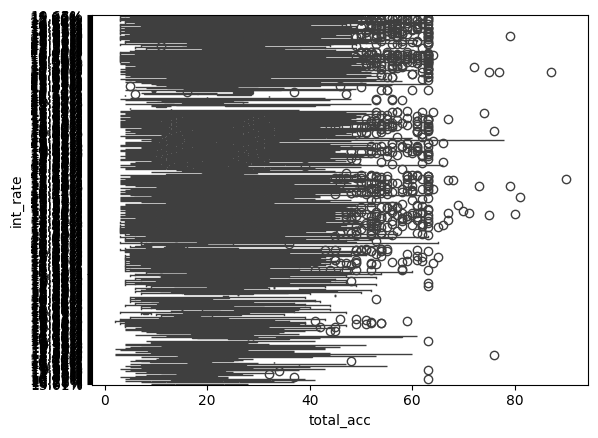

Box Plot of total_acc Vs grade


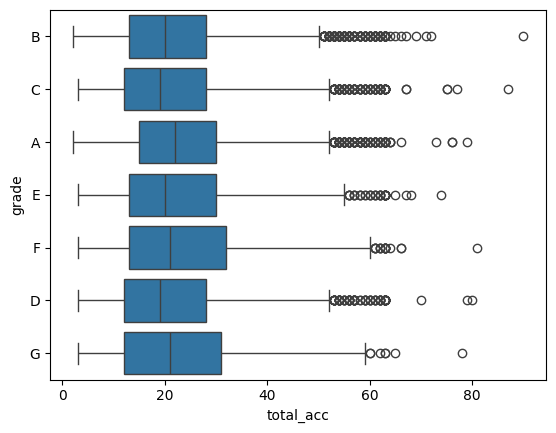

Box Plot of total_acc Vs sub_grade


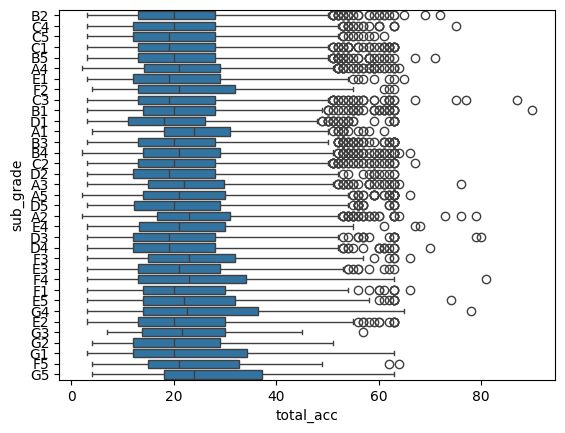

Box Plot of total_acc Vs emp_length


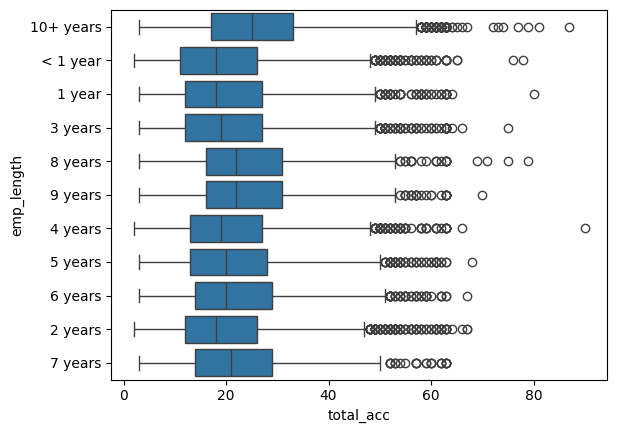

Box Plot of total_acc Vs home_ownership


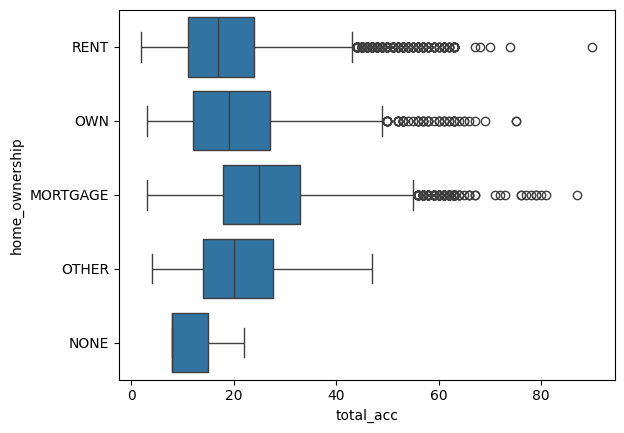

Box Plot of total_acc Vs verification_status


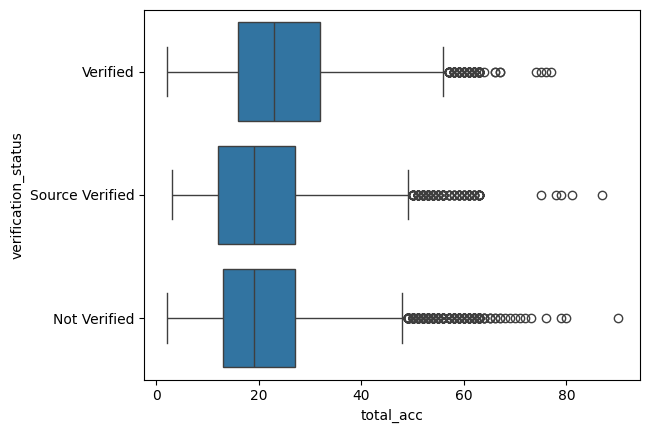

Box Plot of total_acc Vs issue_d


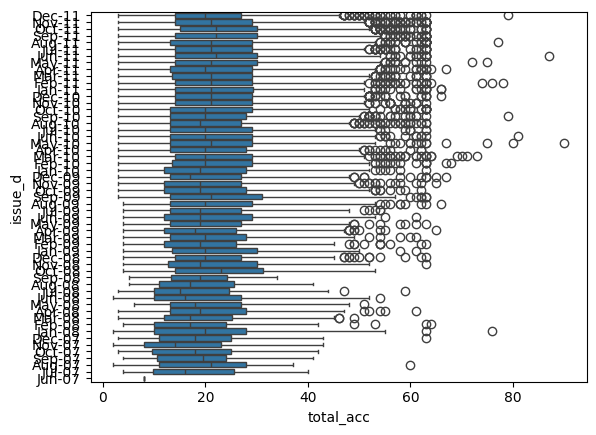

Box Plot of total_acc Vs loan_status


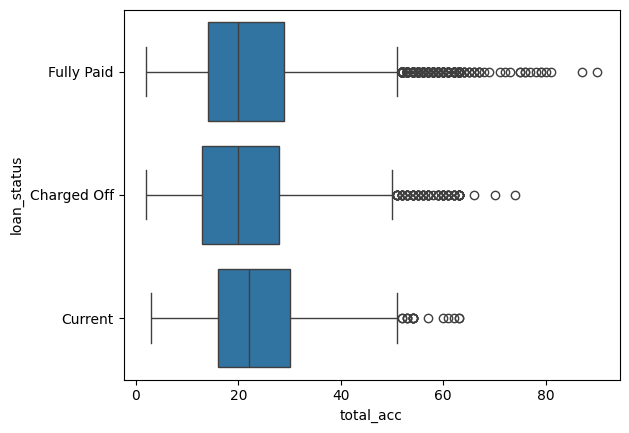

Box Plot of total_acc Vs purpose


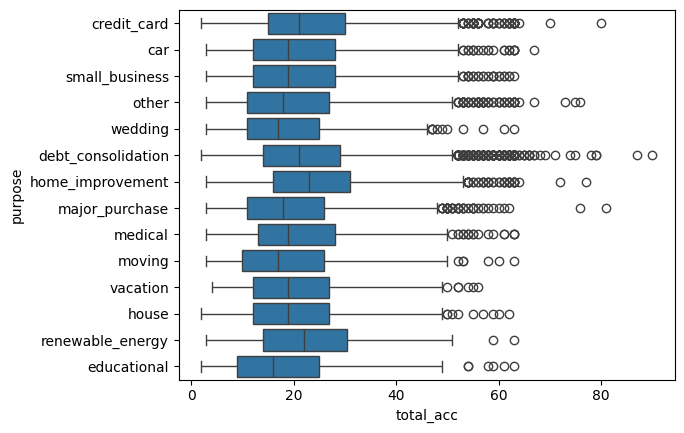

Box Plot of total_acc Vs zip_code


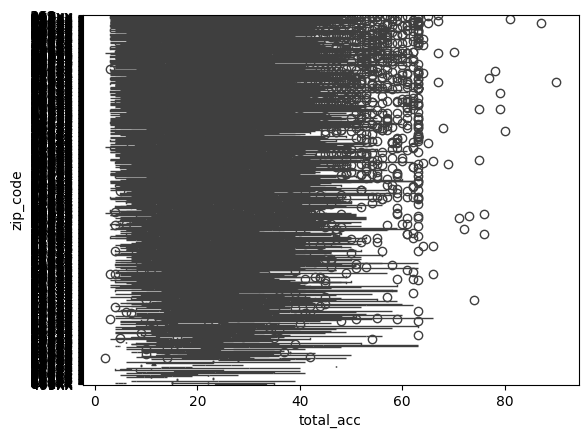

Box Plot of total_acc Vs addr_state


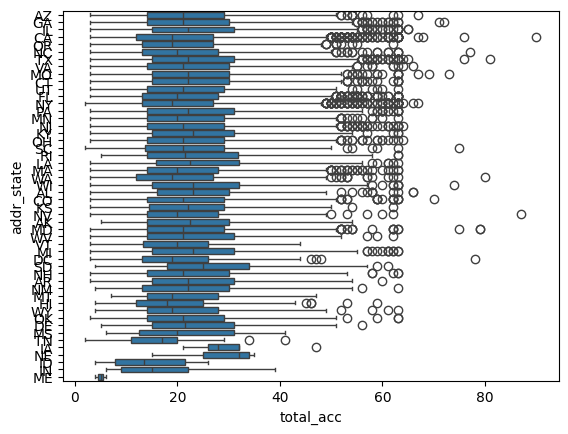

Box Plot of total_acc Vs earliest_cr_line


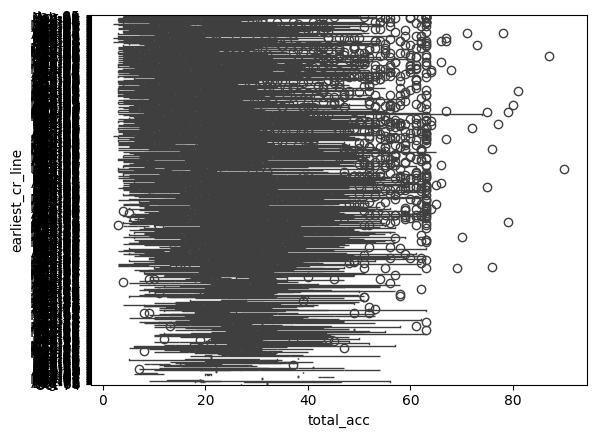

Box Plot of total_acc Vs revol_util


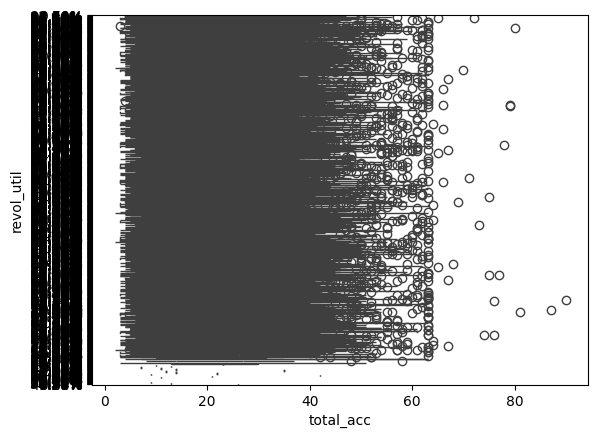

Box Plot of total_acc Vs last_pymnt_d


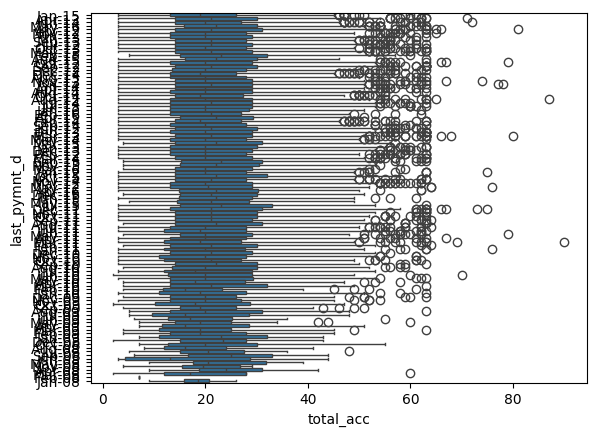

Box Plot of total_acc Vs last_credit_pull_d


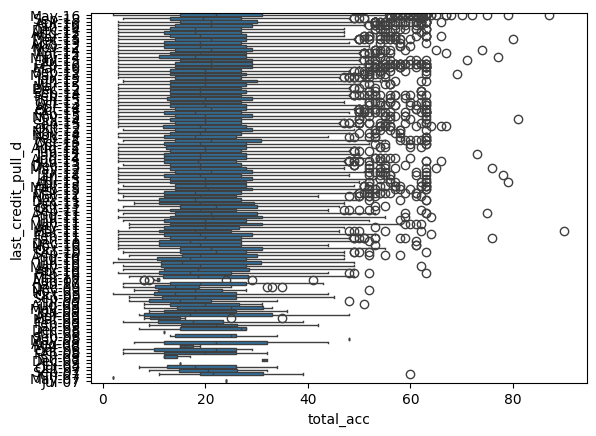

Box Plot of total_pymnt Vs term


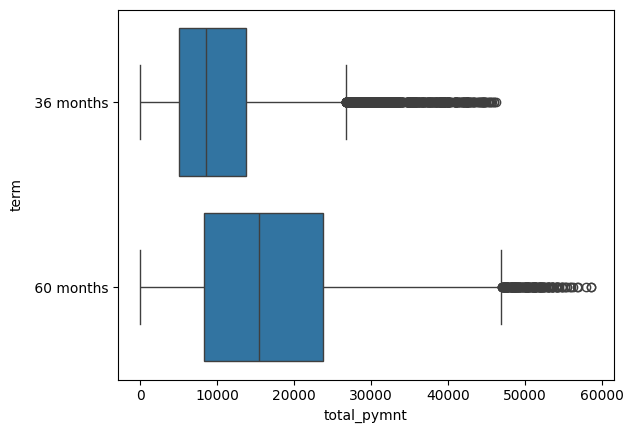

Box Plot of total_pymnt Vs int_rate


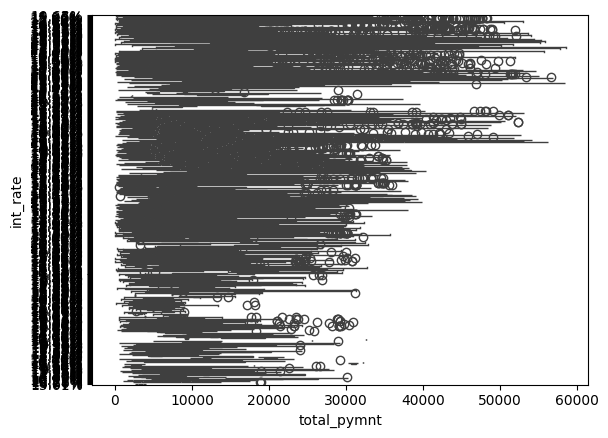

Box Plot of total_pymnt Vs grade


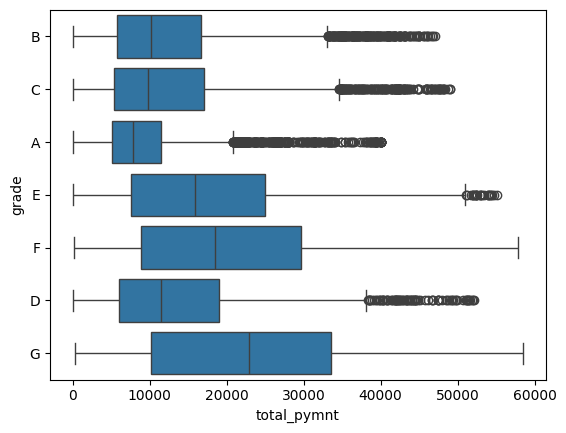

Box Plot of total_pymnt Vs sub_grade


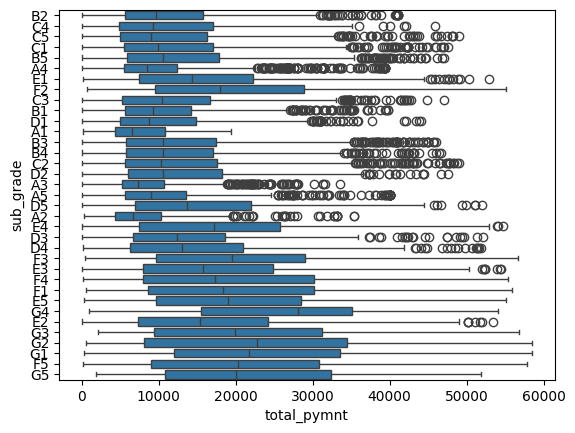

Box Plot of total_pymnt Vs emp_length


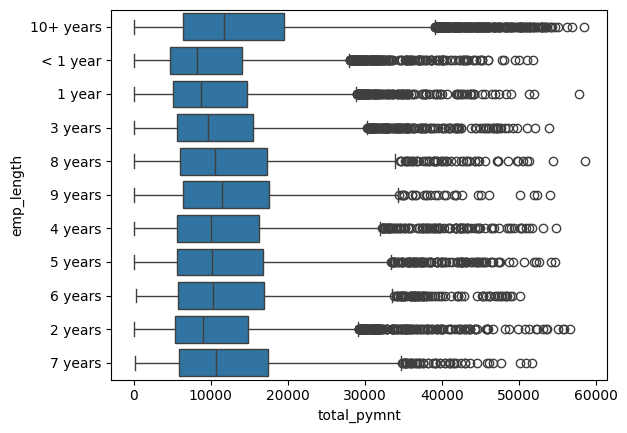

Box Plot of total_pymnt Vs home_ownership


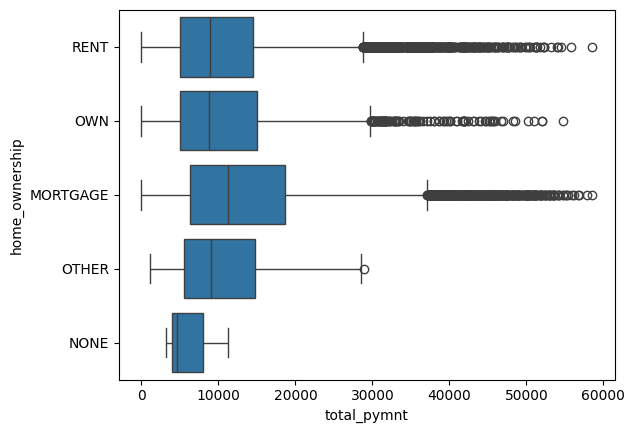

Box Plot of total_pymnt Vs verification_status


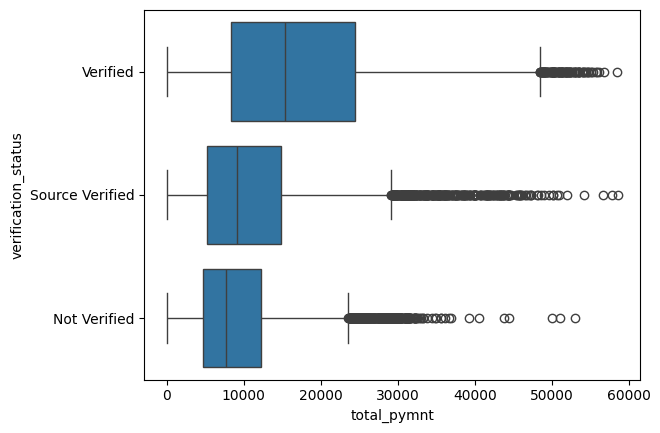

Box Plot of total_pymnt Vs issue_d


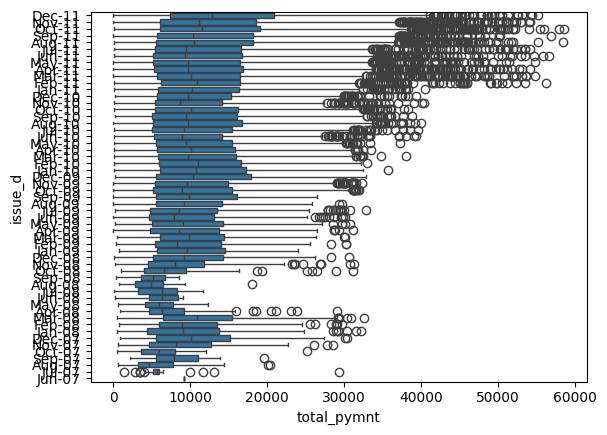

Box Plot of total_pymnt Vs loan_status


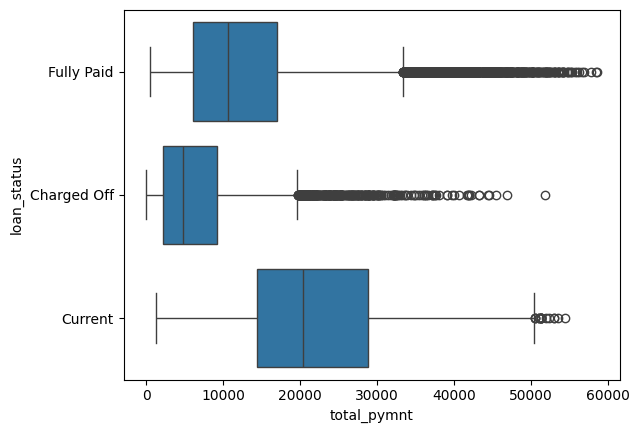

Box Plot of total_pymnt Vs purpose


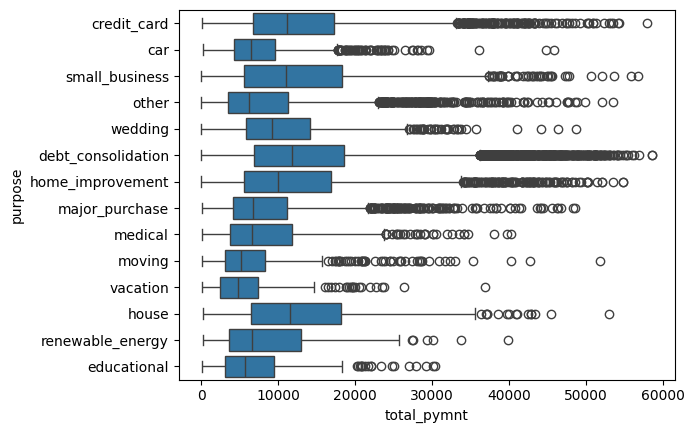

Box Plot of total_pymnt Vs zip_code


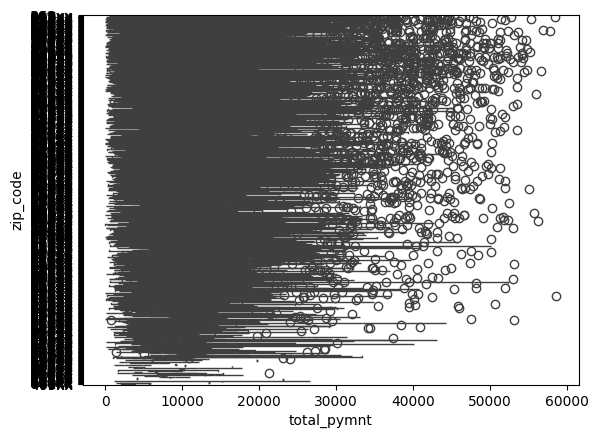

Box Plot of total_pymnt Vs addr_state


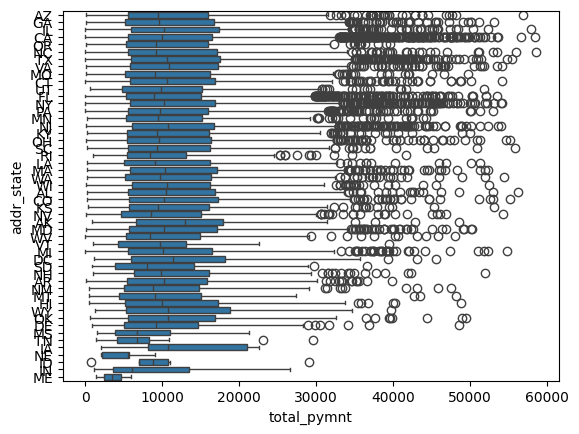

Box Plot of total_pymnt Vs earliest_cr_line


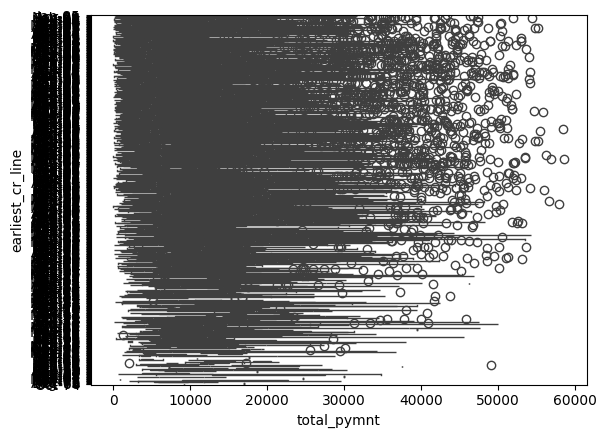

Box Plot of total_pymnt Vs revol_util


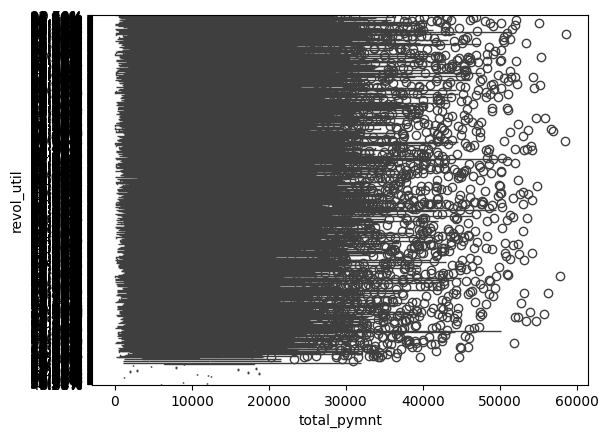

Box Plot of total_pymnt Vs last_pymnt_d


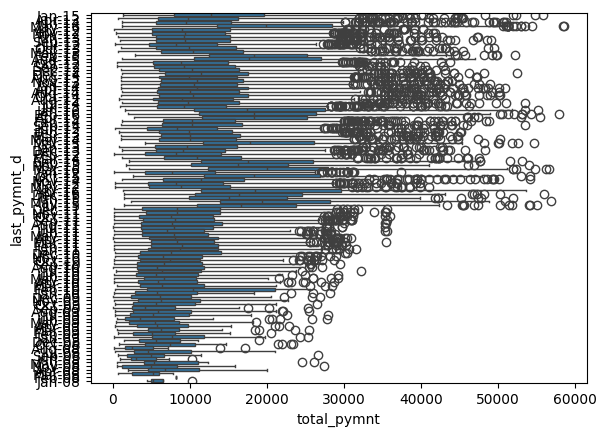

Box Plot of total_pymnt Vs last_credit_pull_d


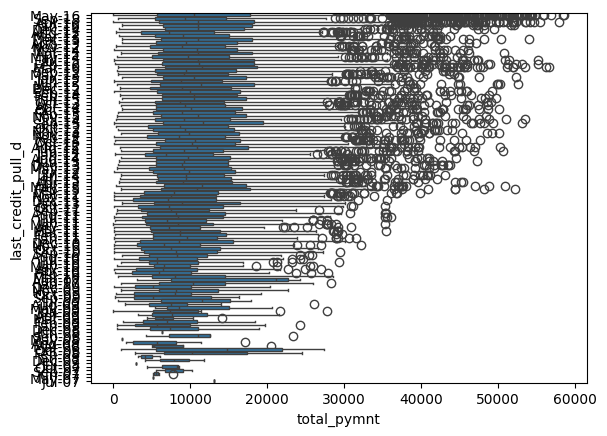

Box Plot of total_pymnt_inv Vs term


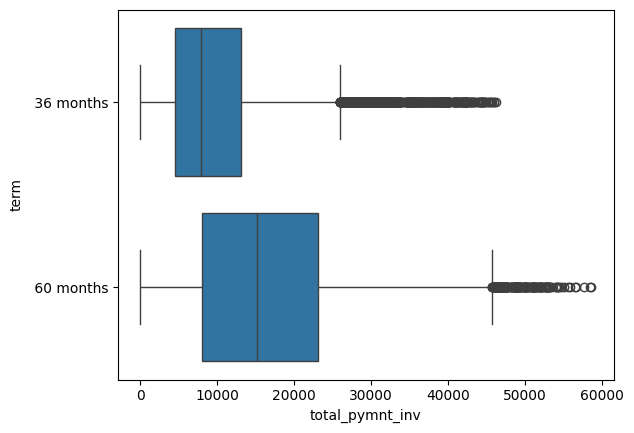

Box Plot of total_pymnt_inv Vs int_rate


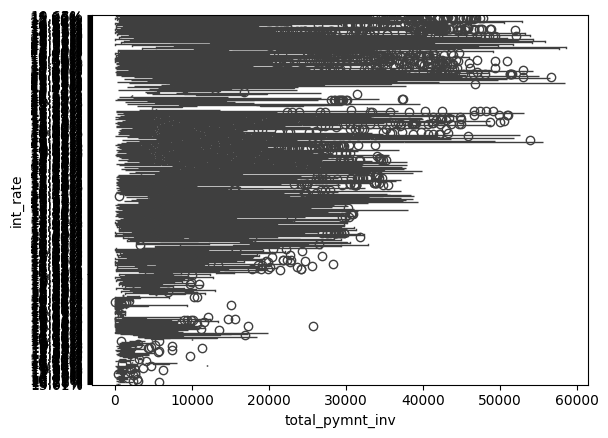

Box Plot of total_pymnt_inv Vs grade


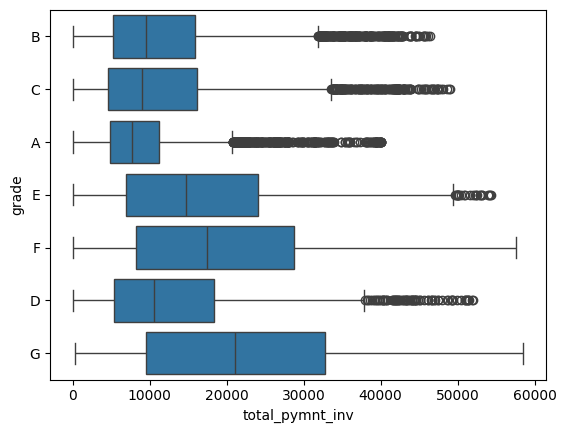

Box Plot of total_pymnt_inv Vs sub_grade


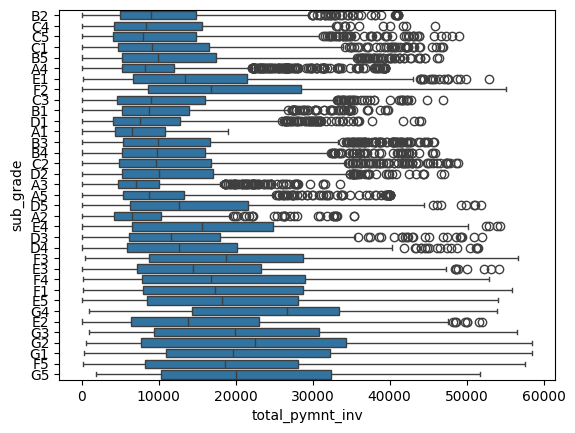

Box Plot of total_pymnt_inv Vs emp_length


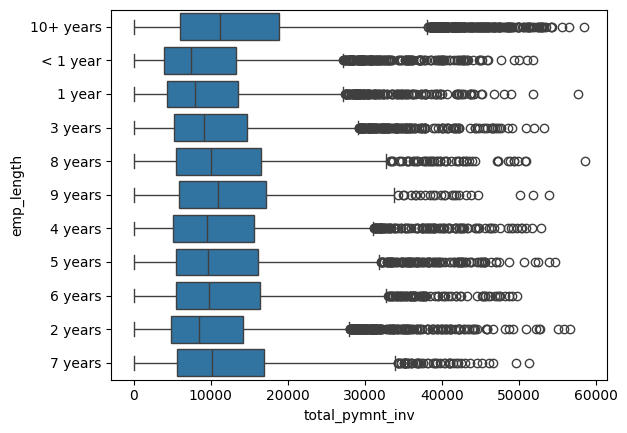

Box Plot of total_pymnt_inv Vs home_ownership


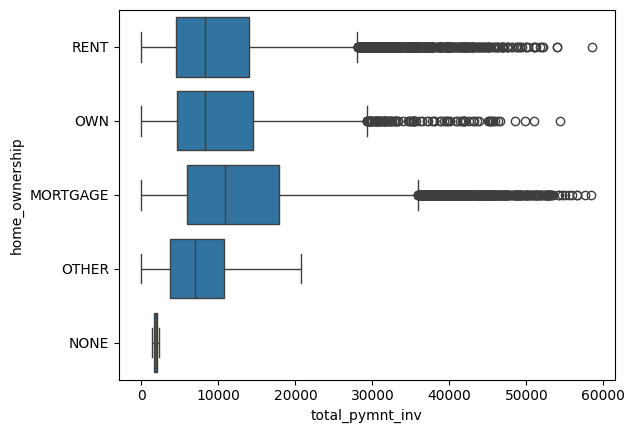

Box Plot of total_pymnt_inv Vs verification_status


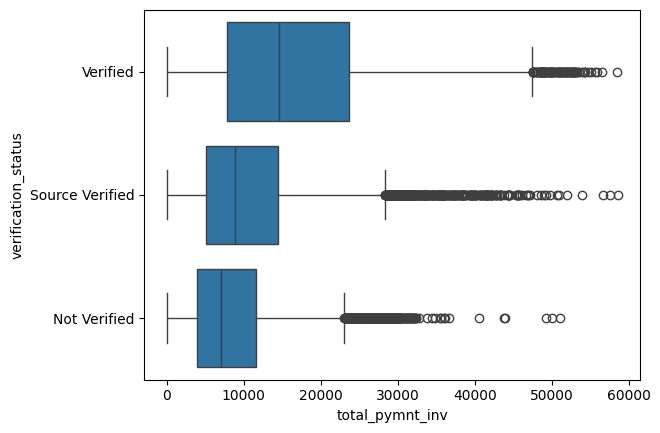

Box Plot of total_pymnt_inv Vs issue_d


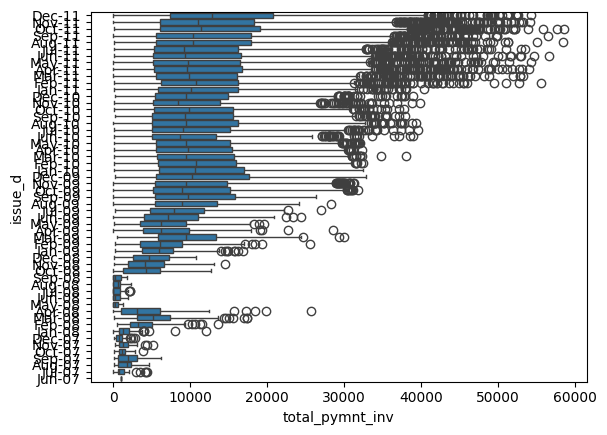

Box Plot of total_pymnt_inv Vs loan_status


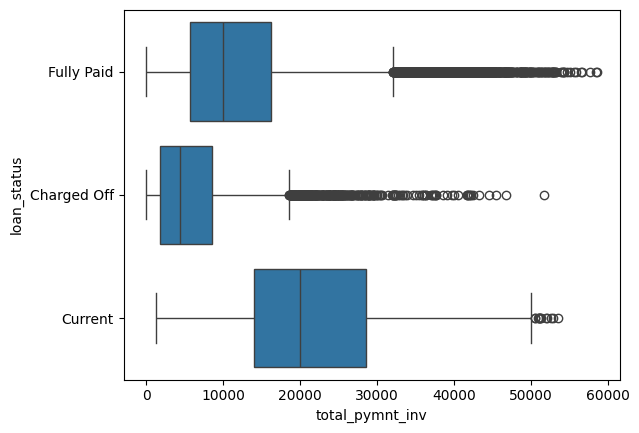

Box Plot of total_pymnt_inv Vs purpose


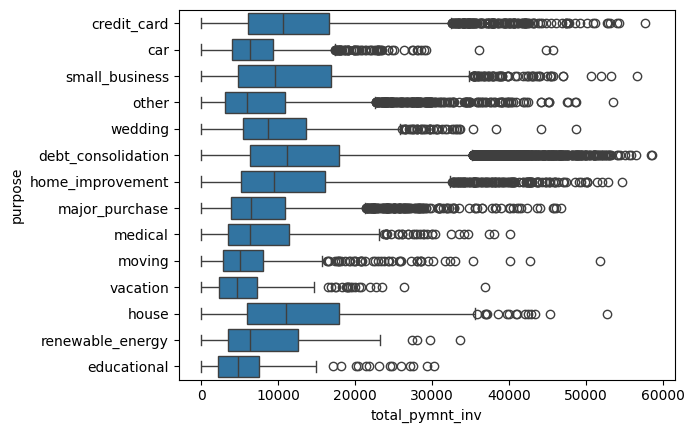

Box Plot of total_pymnt_inv Vs zip_code


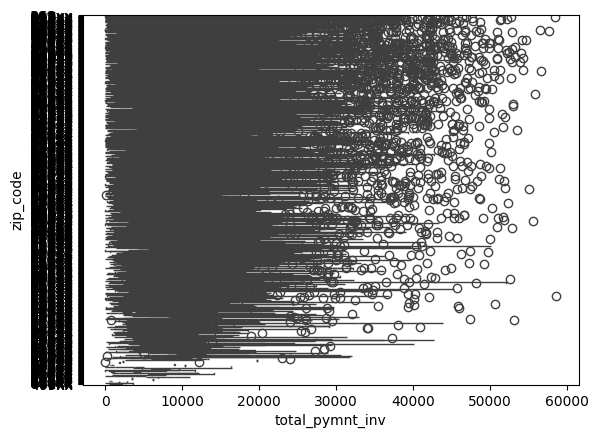

Box Plot of total_pymnt_inv Vs addr_state


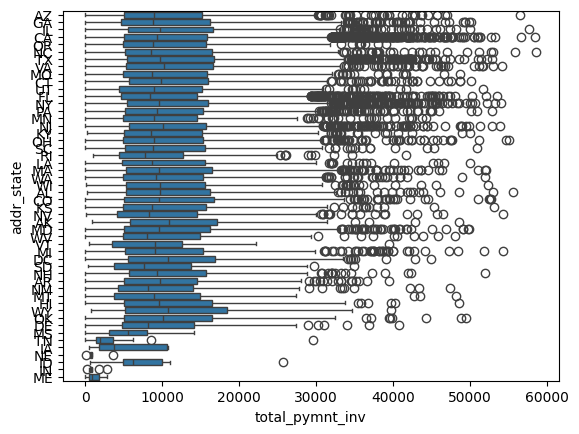

Box Plot of total_pymnt_inv Vs earliest_cr_line


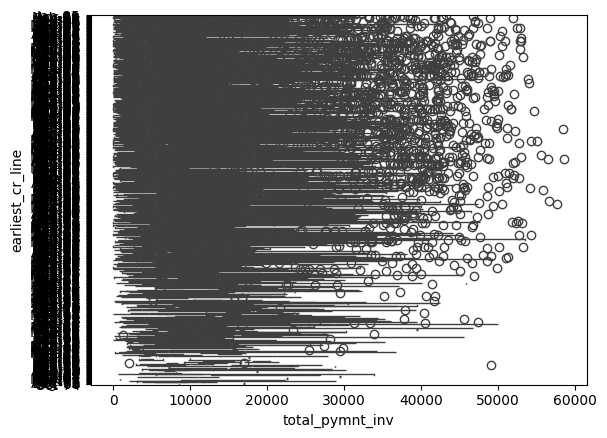

Box Plot of total_pymnt_inv Vs revol_util


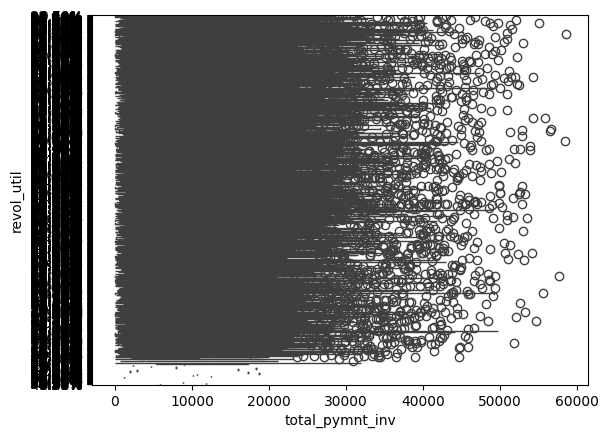

Box Plot of total_pymnt_inv Vs last_pymnt_d


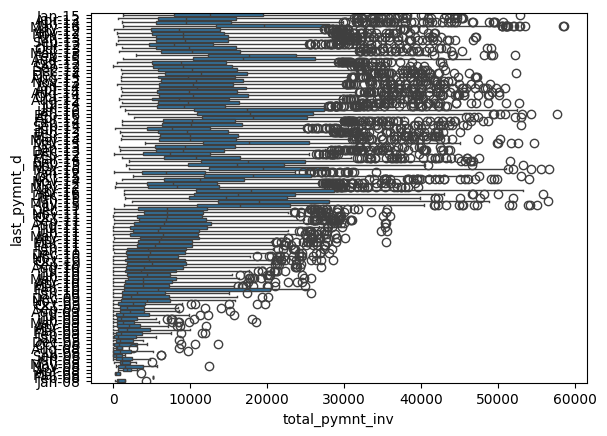

Box Plot of total_pymnt_inv Vs last_credit_pull_d


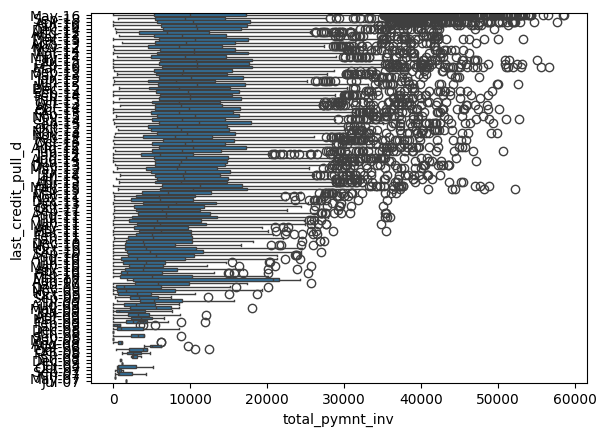

Box Plot of total_rec_prncp Vs term


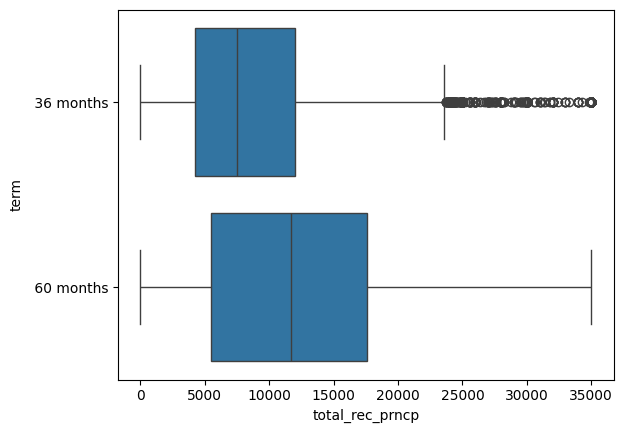

Box Plot of total_rec_prncp Vs int_rate


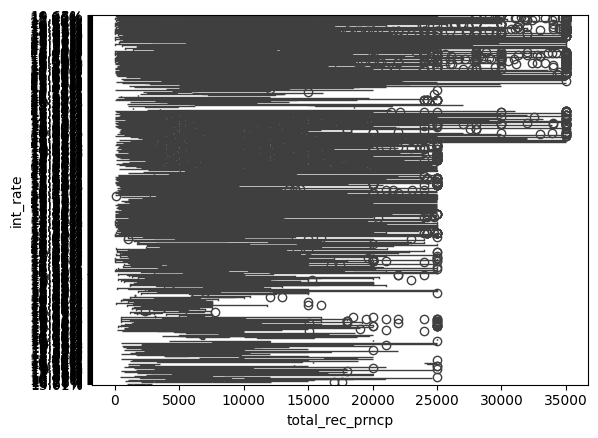

Box Plot of total_rec_prncp Vs grade


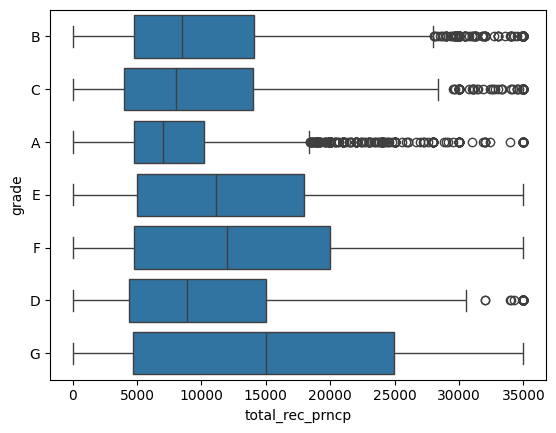

Box Plot of total_rec_prncp Vs sub_grade


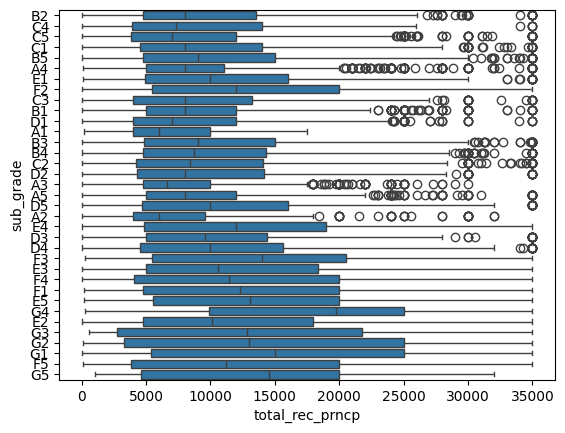

Box Plot of total_rec_prncp Vs emp_length


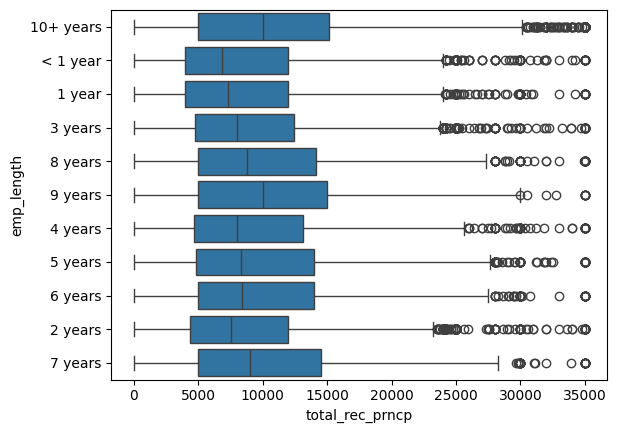

Box Plot of total_rec_prncp Vs home_ownership


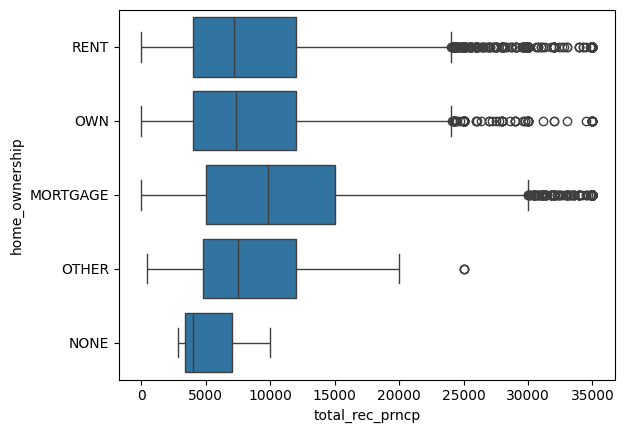

Box Plot of total_rec_prncp Vs verification_status


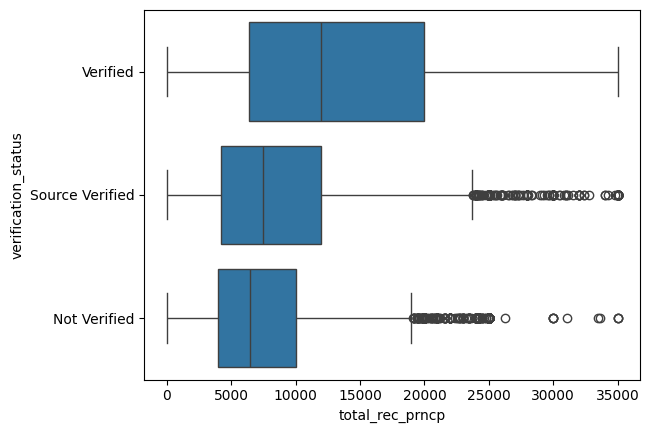

Box Plot of total_rec_prncp Vs issue_d


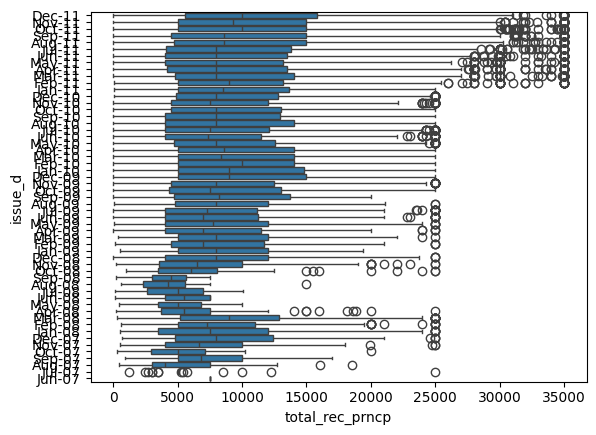

Box Plot of total_rec_prncp Vs loan_status


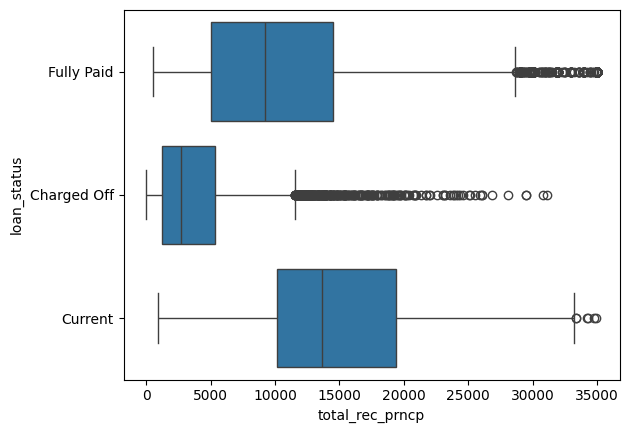

Box Plot of total_rec_prncp Vs purpose


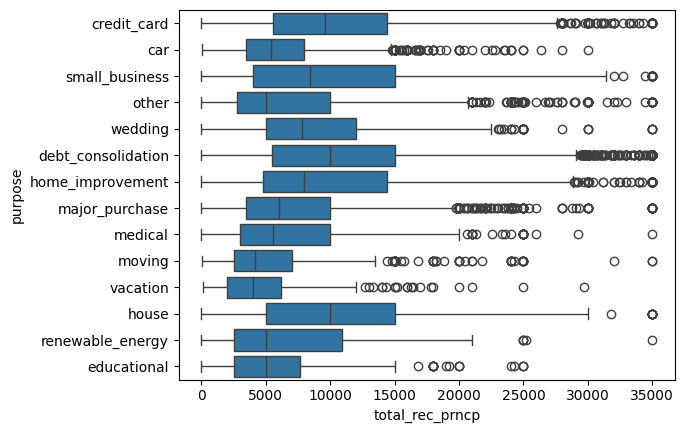

Box Plot of total_rec_prncp Vs zip_code


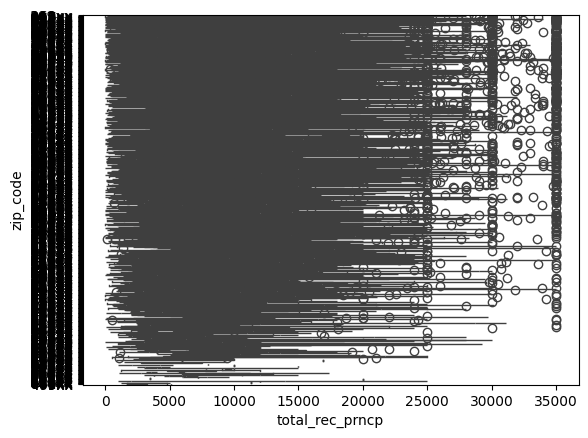

Box Plot of total_rec_prncp Vs addr_state


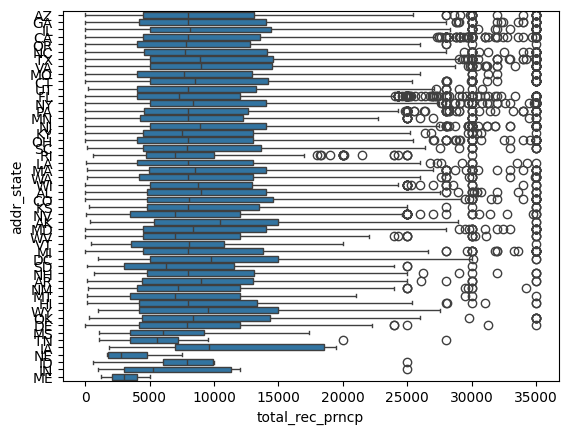

Box Plot of total_rec_prncp Vs earliest_cr_line


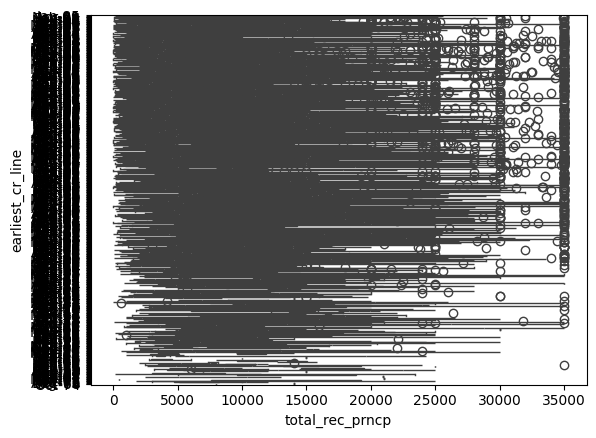

Box Plot of total_rec_prncp Vs revol_util


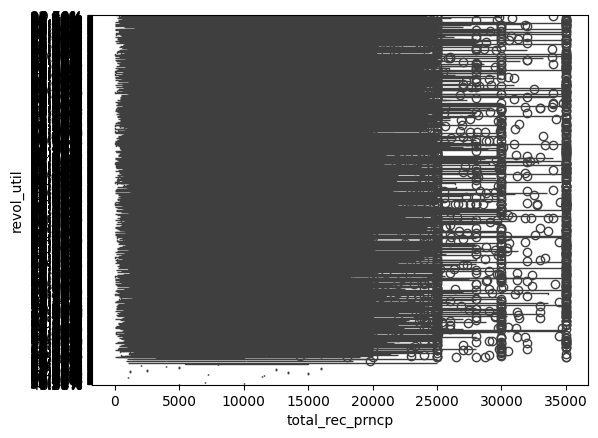

Box Plot of total_rec_prncp Vs last_pymnt_d


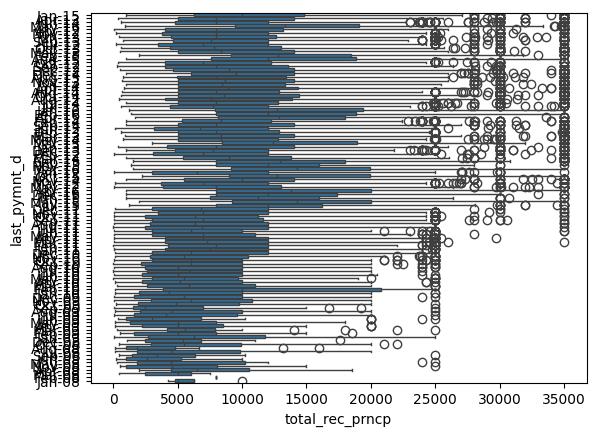

Box Plot of total_rec_prncp Vs last_credit_pull_d


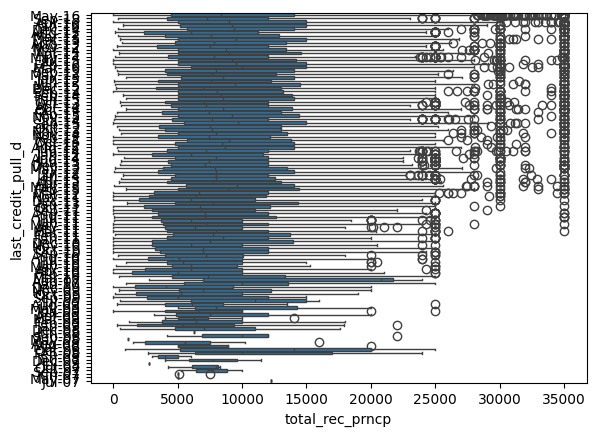

Box Plot of total_rec_int Vs term


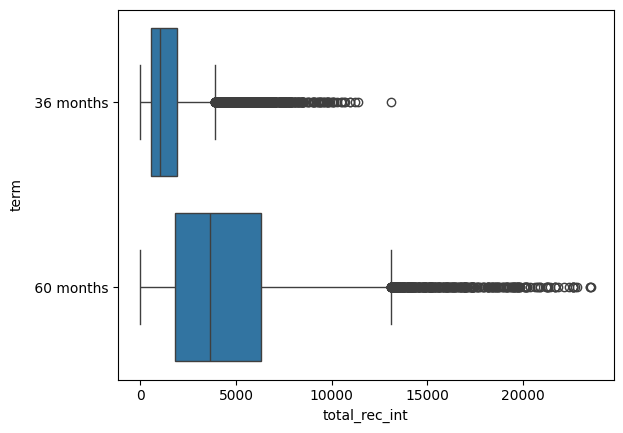

Box Plot of total_rec_int Vs int_rate


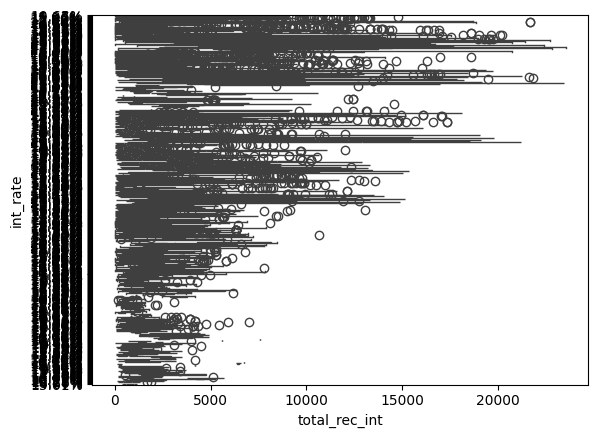

Box Plot of total_rec_int Vs grade


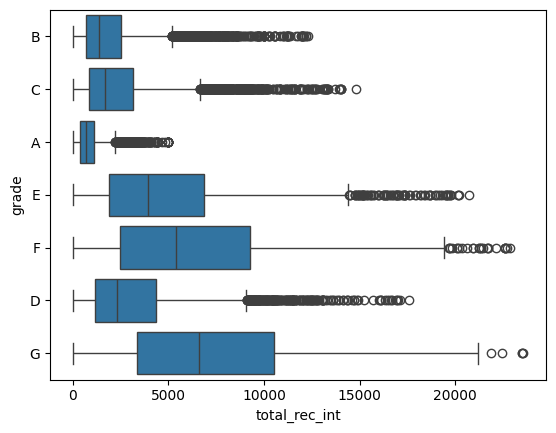

Box Plot of total_rec_int Vs sub_grade


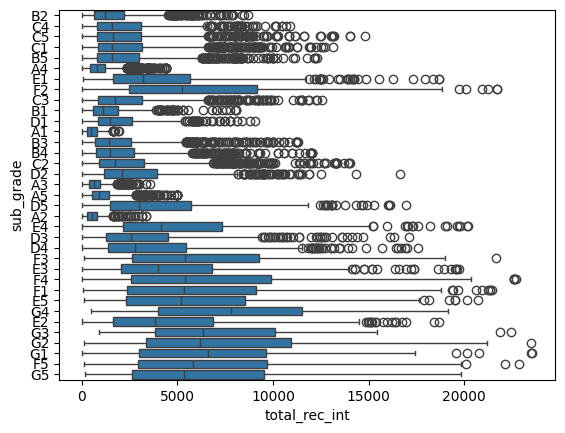

Box Plot of total_rec_int Vs emp_length


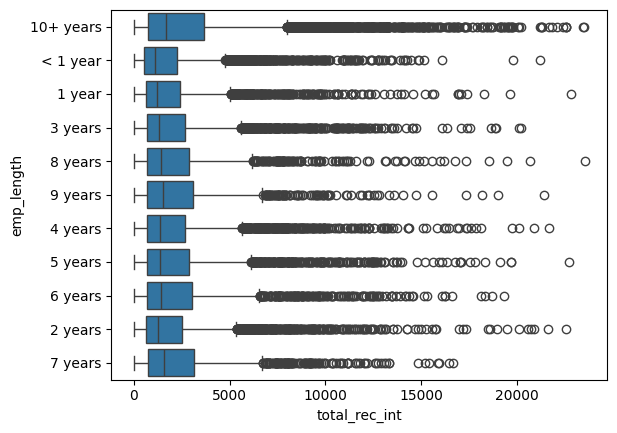

Box Plot of total_rec_int Vs home_ownership


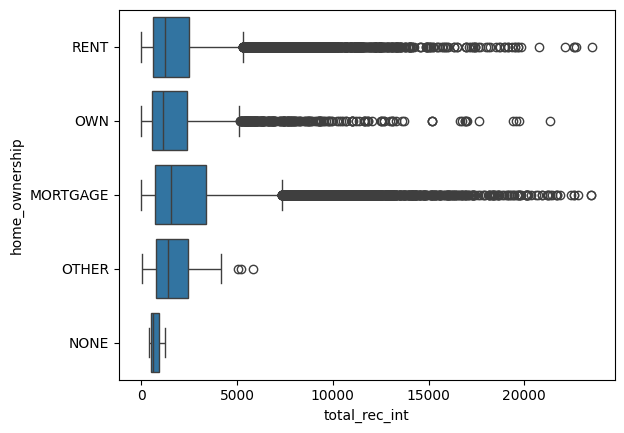

Box Plot of total_rec_int Vs verification_status


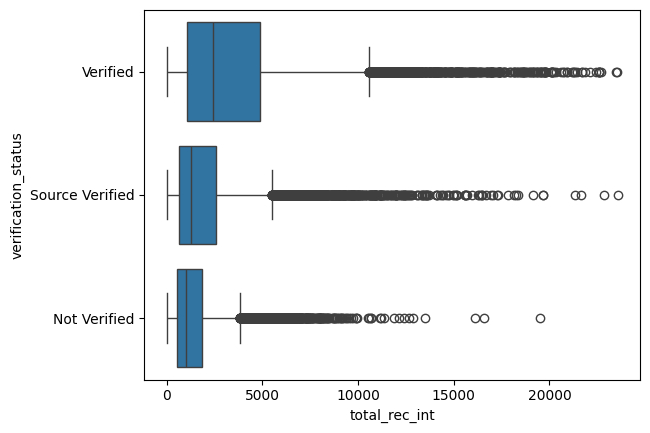

Box Plot of total_rec_int Vs issue_d


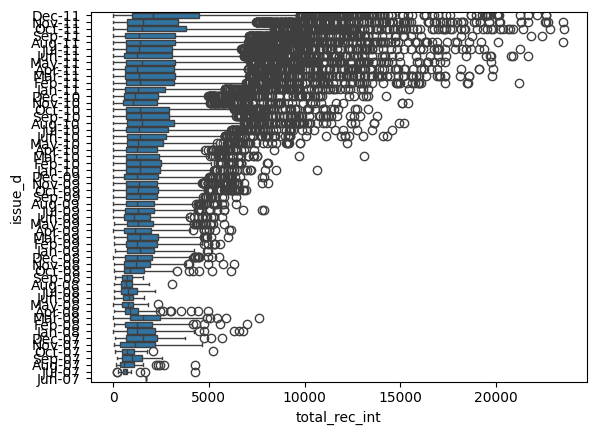

Box Plot of total_rec_int Vs loan_status


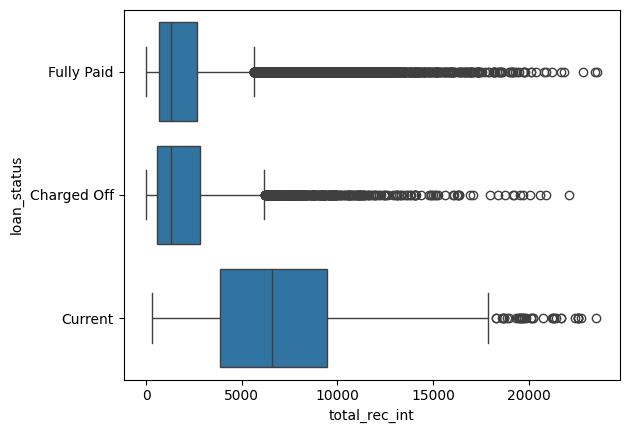

Box Plot of total_rec_int Vs purpose


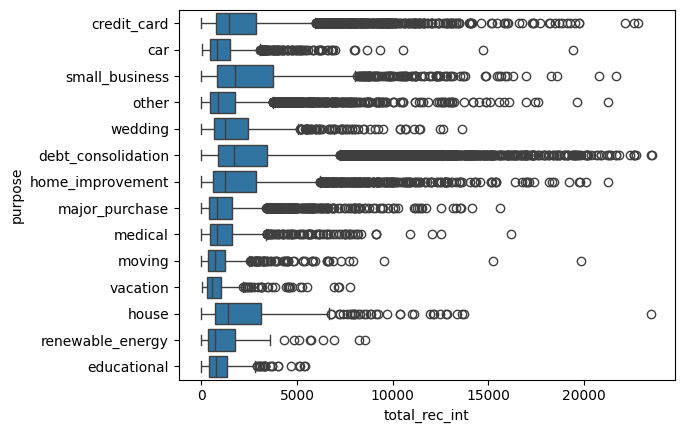

Box Plot of total_rec_int Vs zip_code


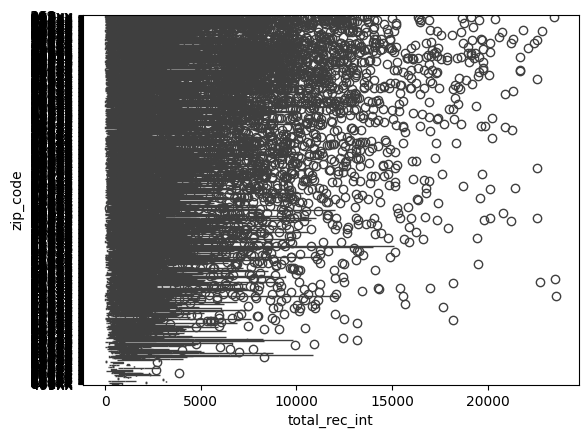

Box Plot of total_rec_int Vs addr_state


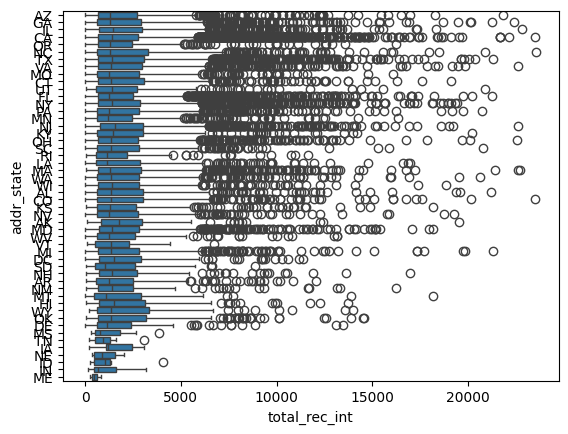

Box Plot of total_rec_int Vs earliest_cr_line


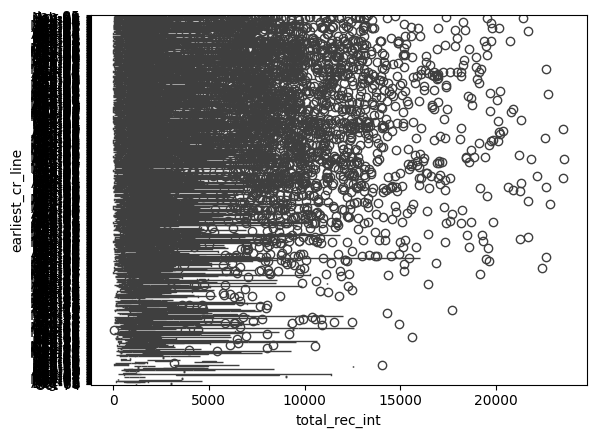

Box Plot of total_rec_int Vs revol_util


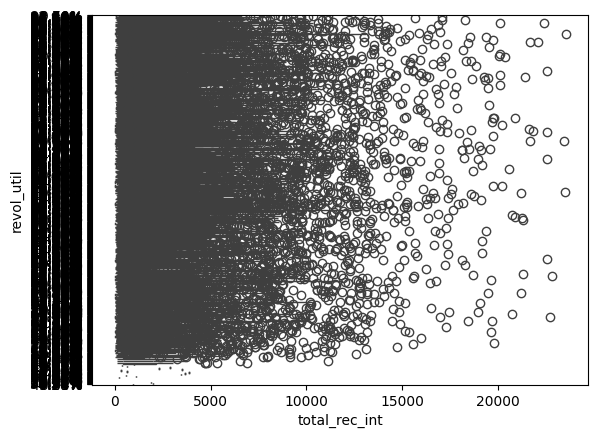

Box Plot of total_rec_int Vs last_pymnt_d


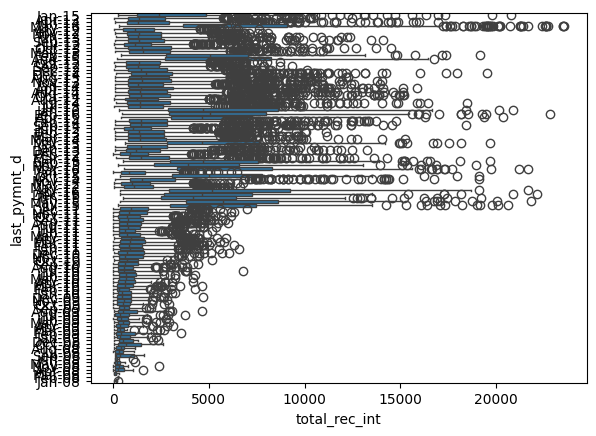

Box Plot of total_rec_int Vs last_credit_pull_d


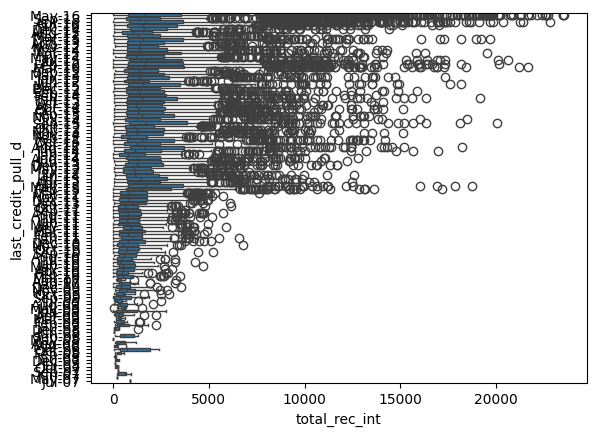

Box Plot of recoveries Vs term


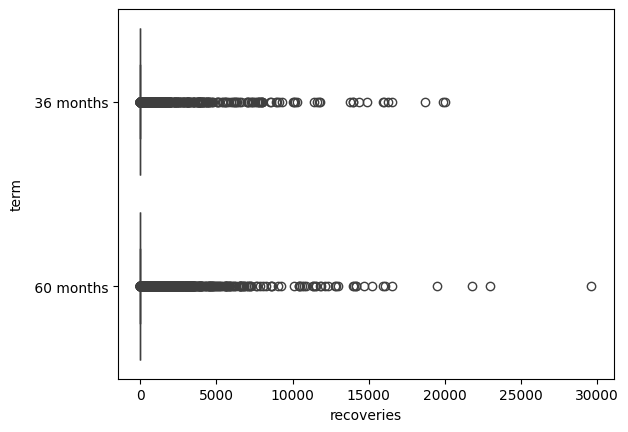

Box Plot of recoveries Vs int_rate


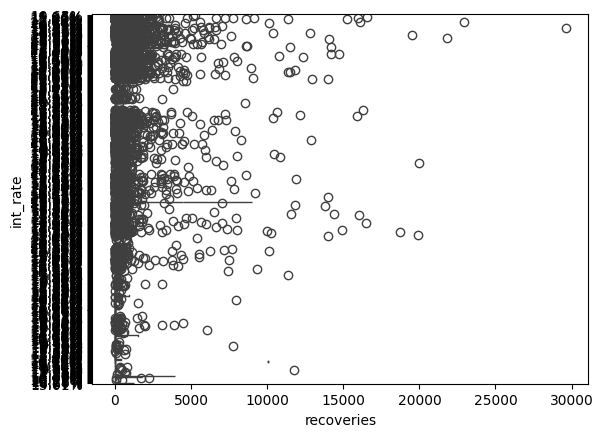

Box Plot of recoveries Vs grade


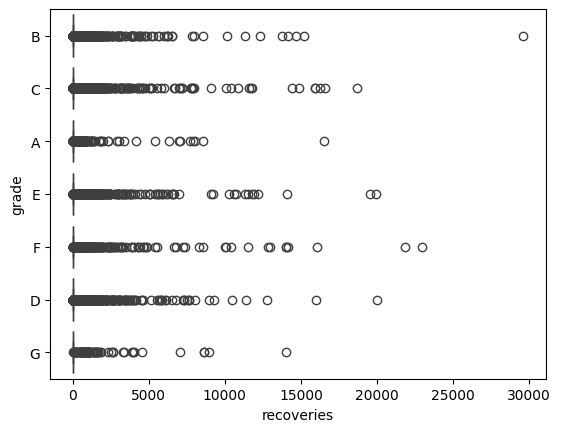

Box Plot of recoveries Vs sub_grade


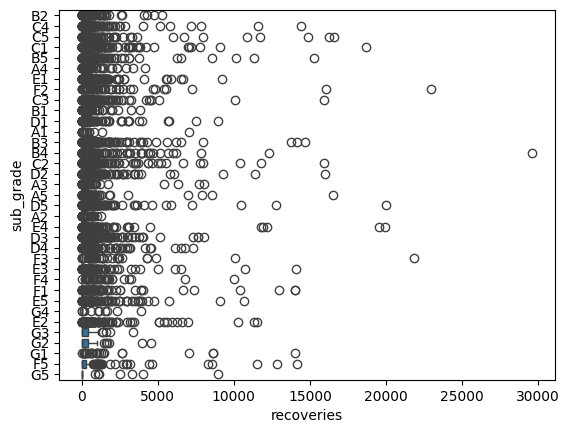

Box Plot of recoveries Vs emp_length


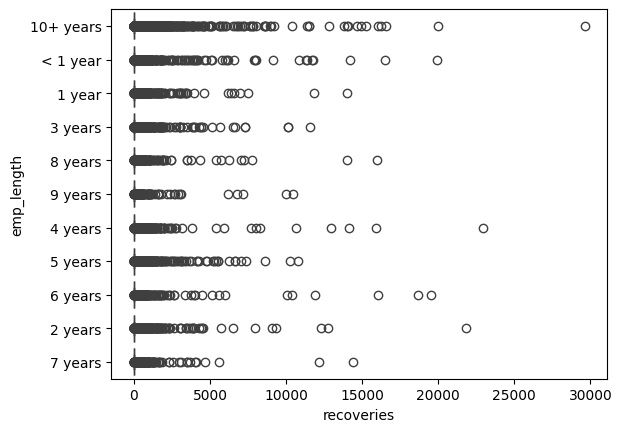

Box Plot of recoveries Vs home_ownership


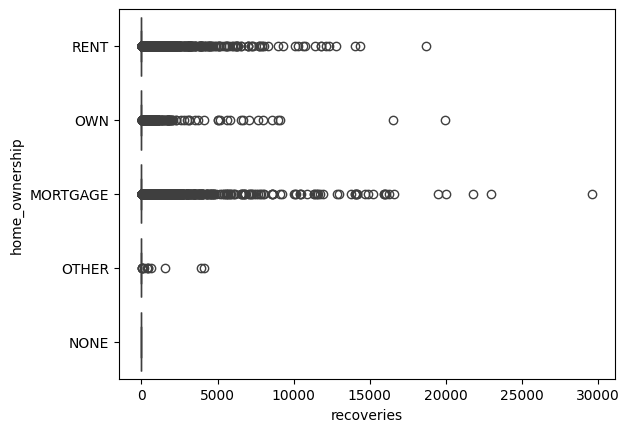

Box Plot of recoveries Vs verification_status


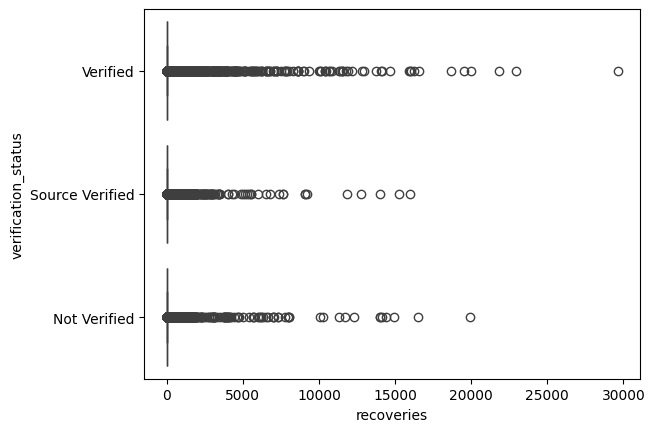

Box Plot of recoveries Vs issue_d


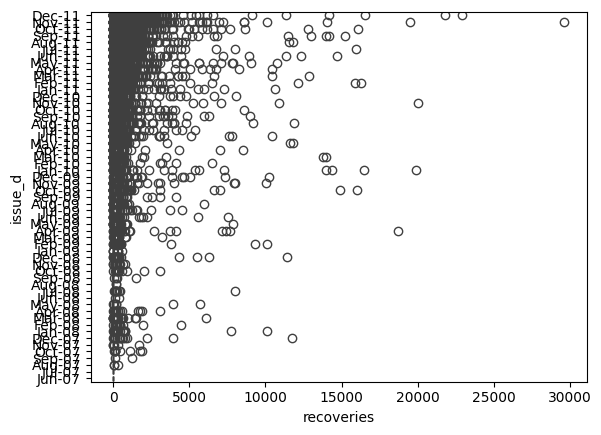

Box Plot of recoveries Vs loan_status


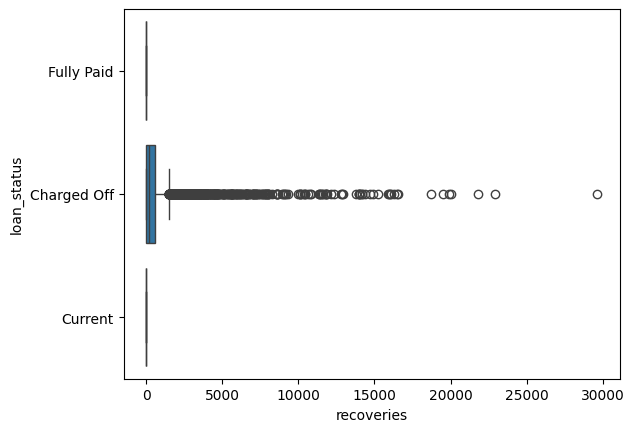

Box Plot of recoveries Vs purpose


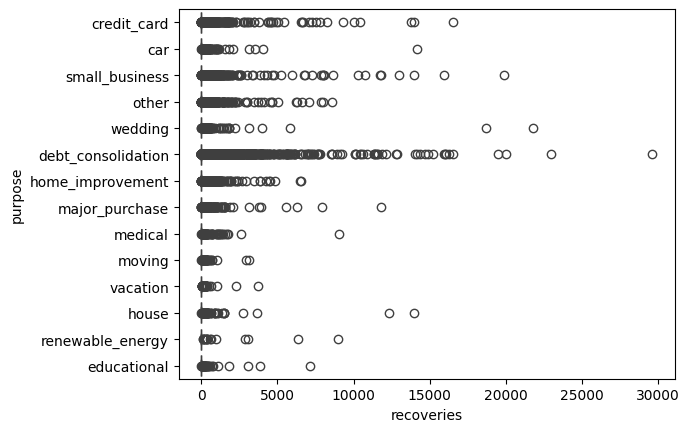

Box Plot of recoveries Vs zip_code


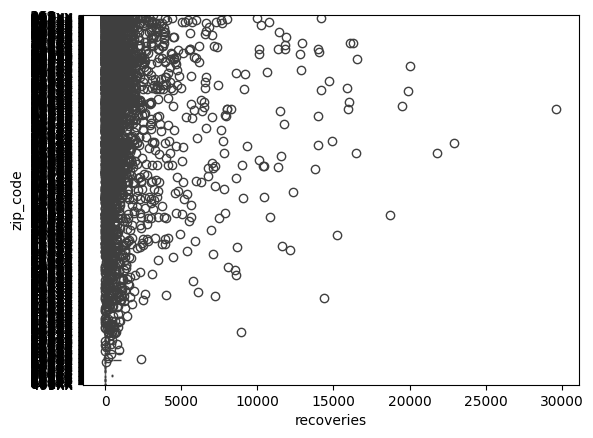

Box Plot of recoveries Vs addr_state


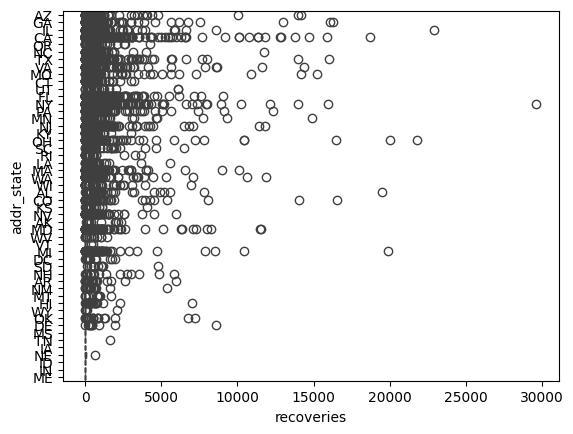

Box Plot of recoveries Vs earliest_cr_line


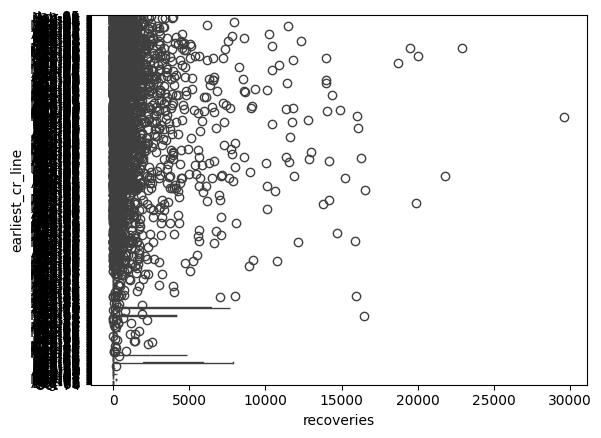

Box Plot of recoveries Vs revol_util


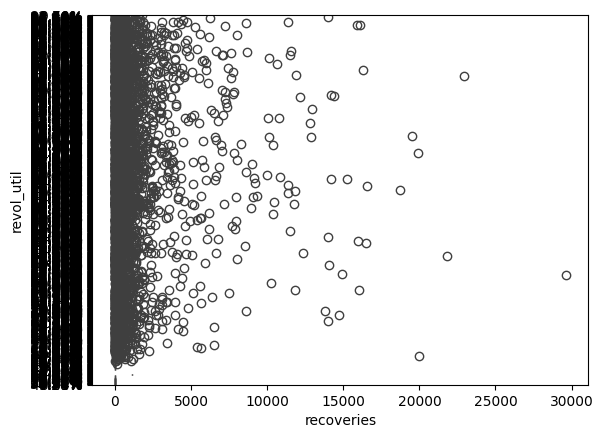

Box Plot of recoveries Vs last_pymnt_d


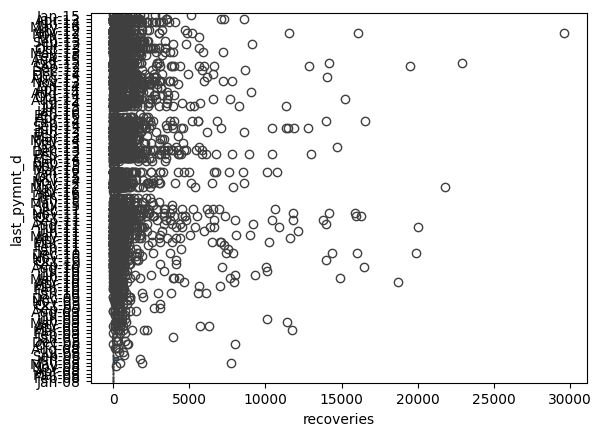

Box Plot of recoveries Vs last_credit_pull_d


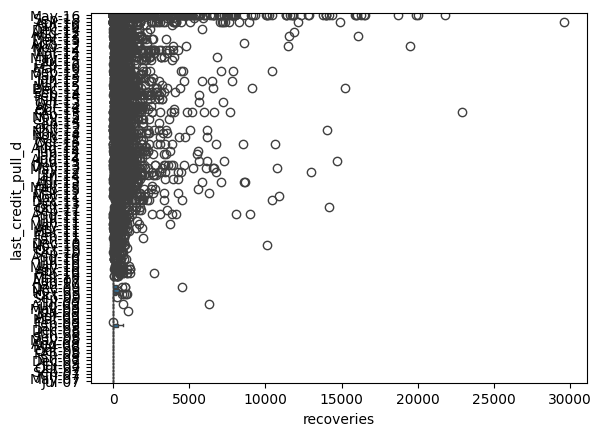

Box Plot of collection_recovery_fee Vs term


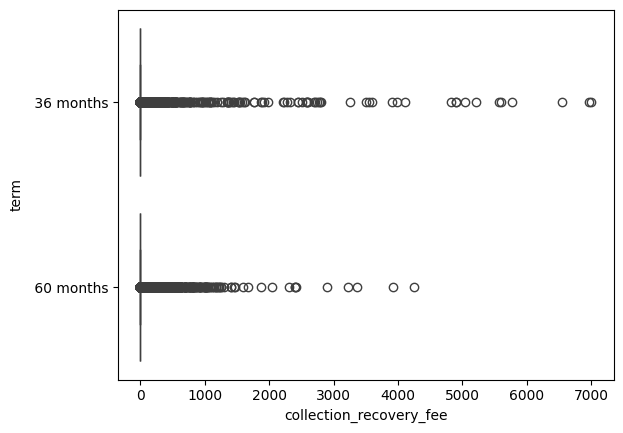

Box Plot of collection_recovery_fee Vs int_rate


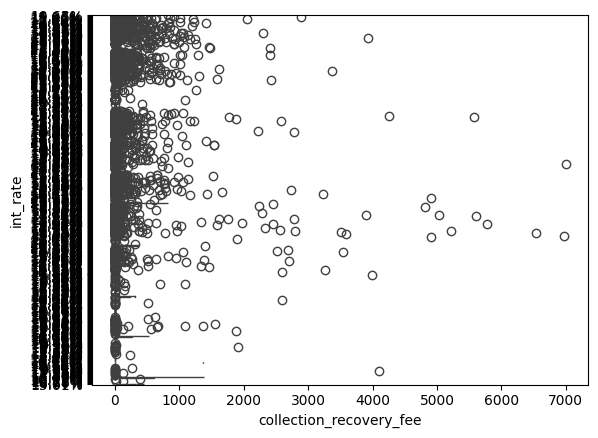

Box Plot of collection_recovery_fee Vs grade


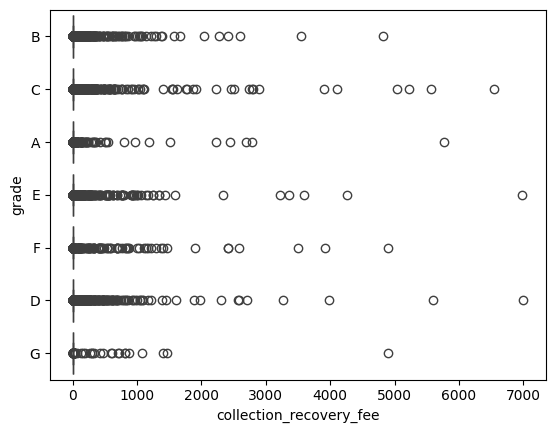

Box Plot of collection_recovery_fee Vs sub_grade


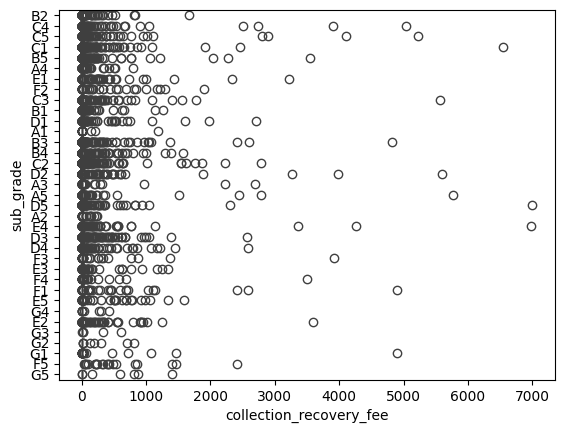

Box Plot of collection_recovery_fee Vs emp_length


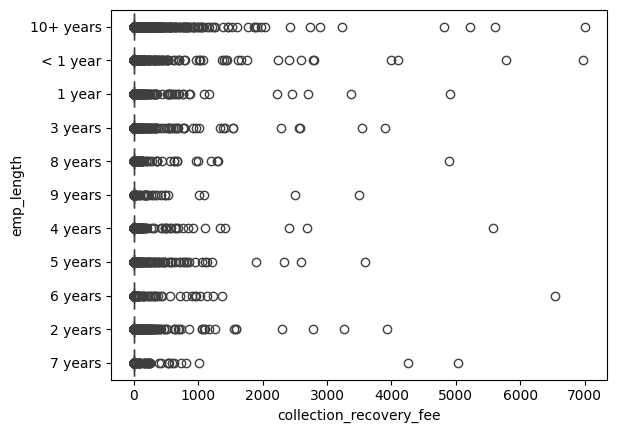

Box Plot of collection_recovery_fee Vs home_ownership


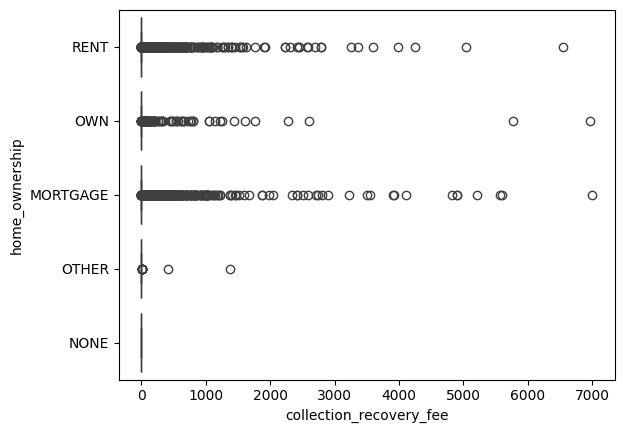

Box Plot of collection_recovery_fee Vs verification_status


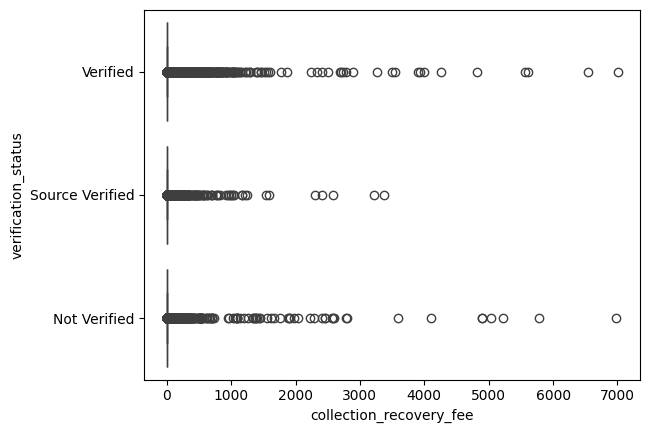

Box Plot of collection_recovery_fee Vs issue_d


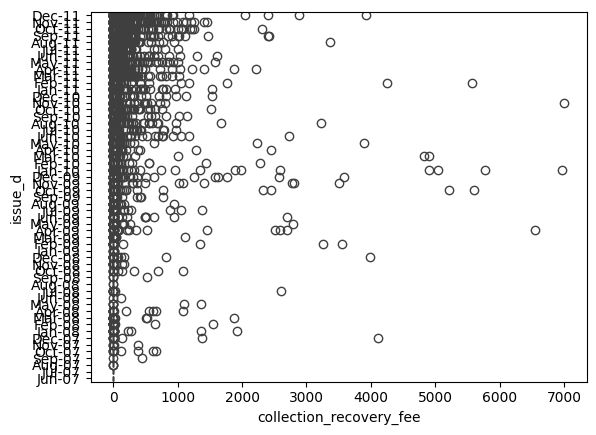

Box Plot of collection_recovery_fee Vs loan_status


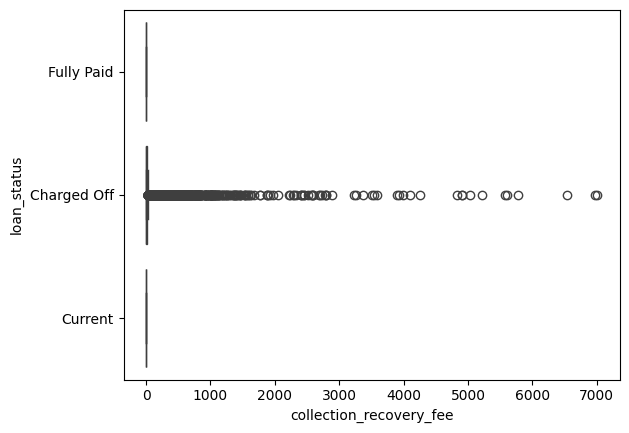

Box Plot of collection_recovery_fee Vs purpose


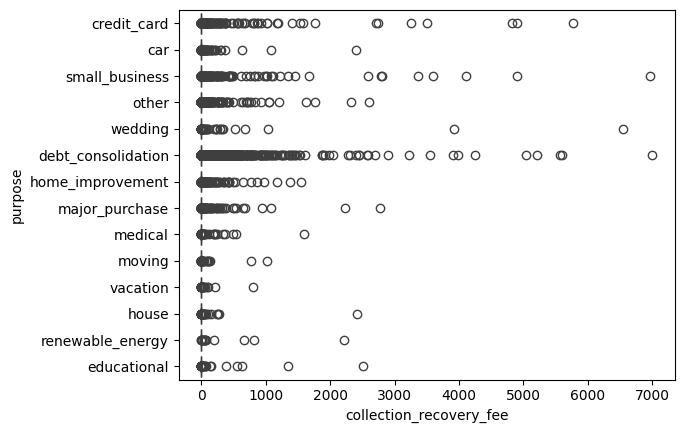

Box Plot of collection_recovery_fee Vs zip_code


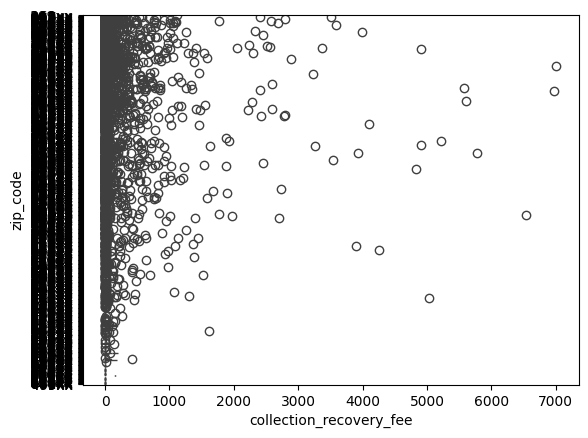

Box Plot of collection_recovery_fee Vs addr_state


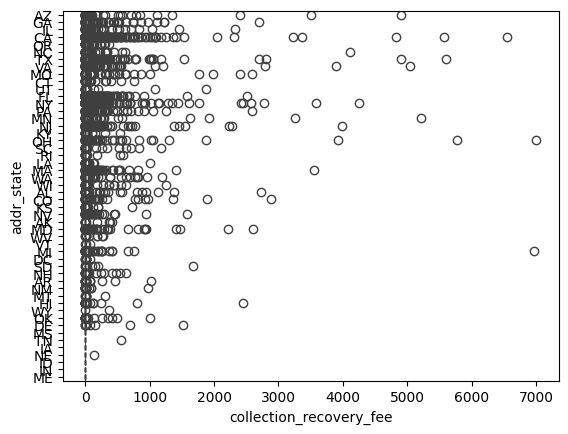

Box Plot of collection_recovery_fee Vs earliest_cr_line


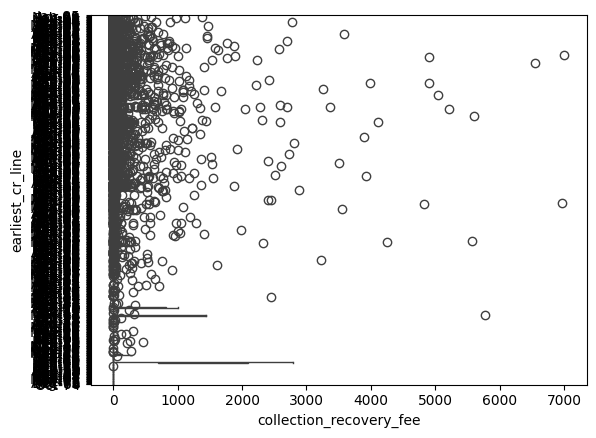

Box Plot of collection_recovery_fee Vs revol_util


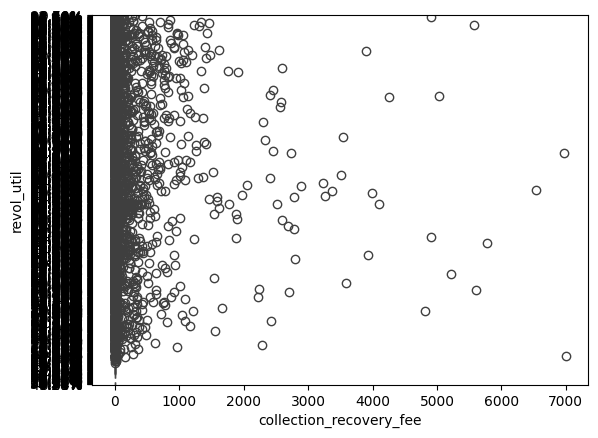

Box Plot of collection_recovery_fee Vs last_pymnt_d


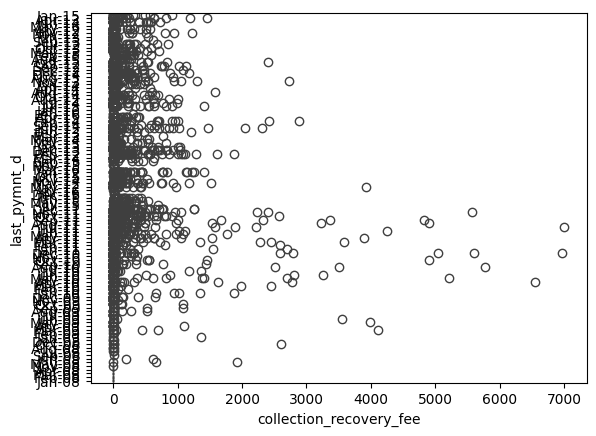

Box Plot of collection_recovery_fee Vs last_credit_pull_d


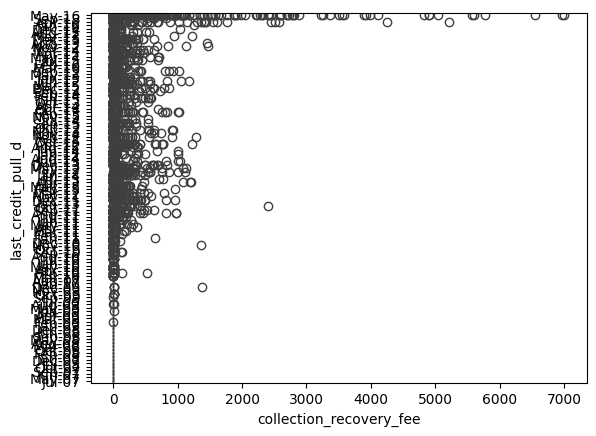

Box Plot of last_pymnt_amnt Vs term


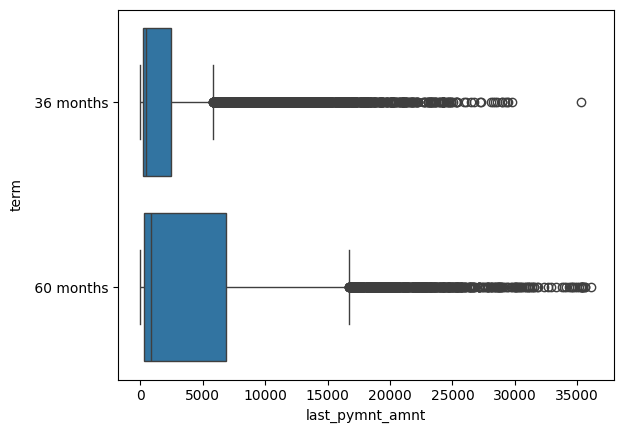

Box Plot of last_pymnt_amnt Vs int_rate


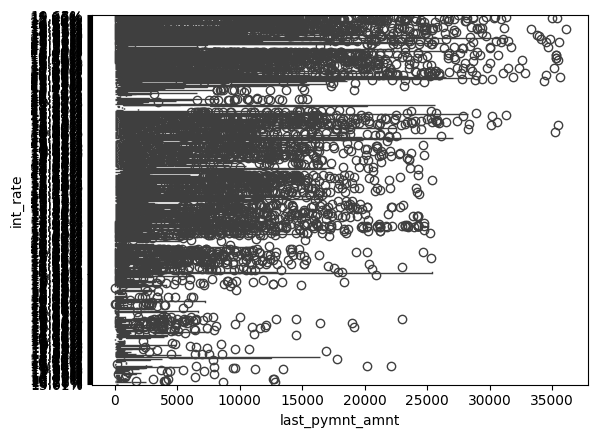

Box Plot of last_pymnt_amnt Vs grade


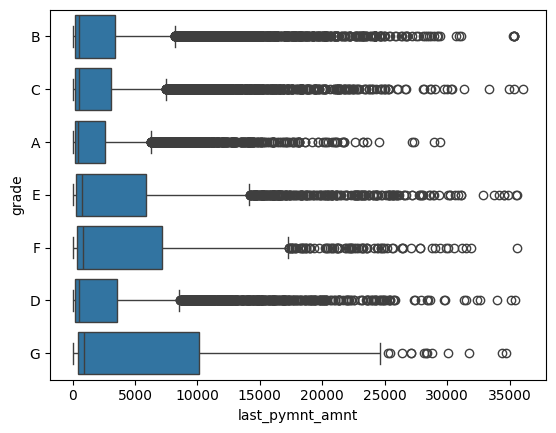

Box Plot of last_pymnt_amnt Vs sub_grade


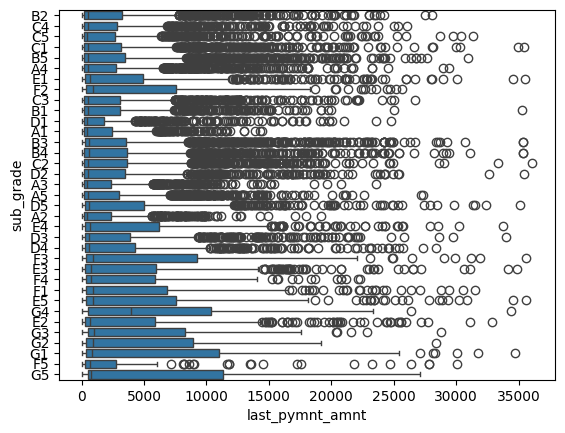

Box Plot of last_pymnt_amnt Vs emp_length


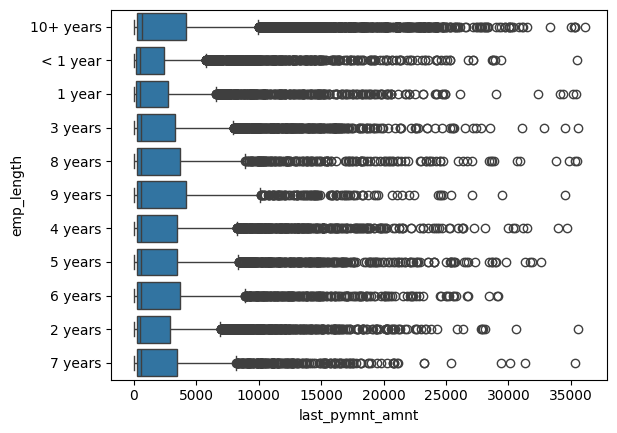

Box Plot of last_pymnt_amnt Vs home_ownership


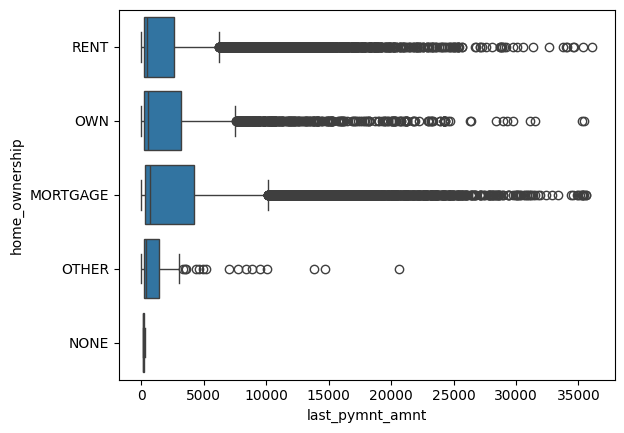

Box Plot of last_pymnt_amnt Vs verification_status


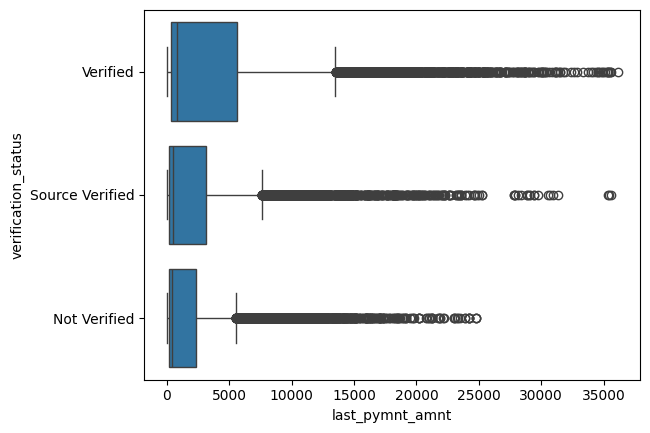

Box Plot of last_pymnt_amnt Vs issue_d


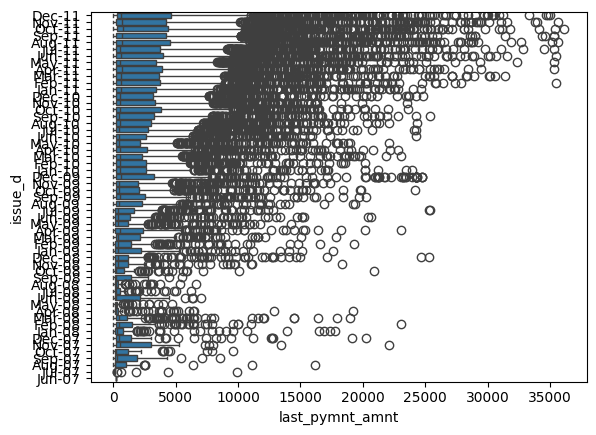

Box Plot of last_pymnt_amnt Vs loan_status


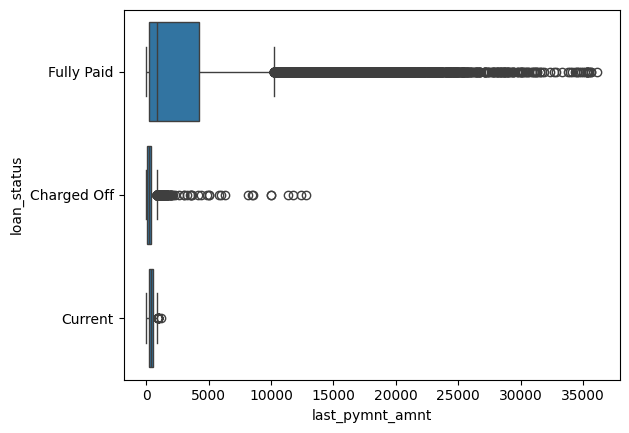

Box Plot of last_pymnt_amnt Vs purpose


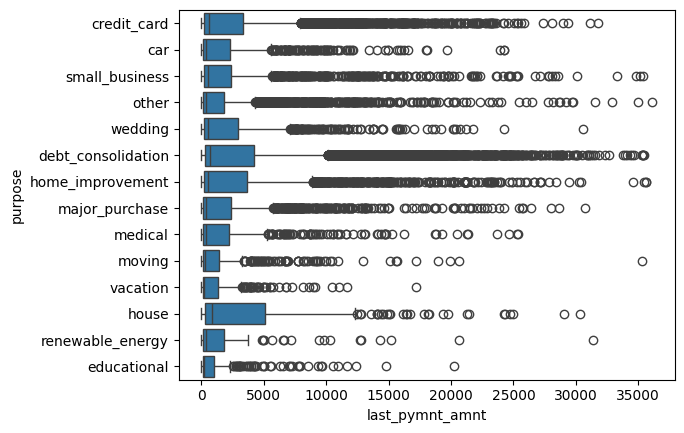

Box Plot of last_pymnt_amnt Vs zip_code


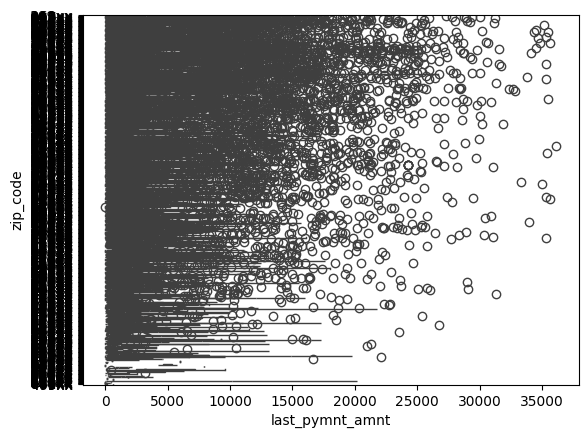

Box Plot of last_pymnt_amnt Vs addr_state


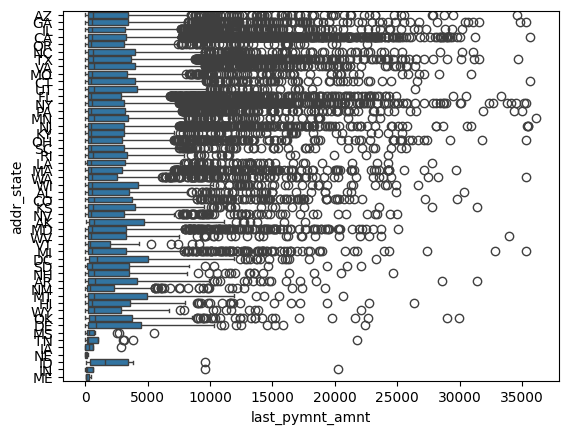

Box Plot of last_pymnt_amnt Vs earliest_cr_line


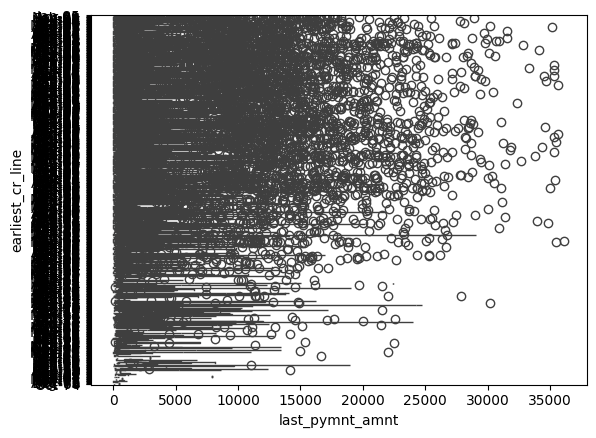

Box Plot of last_pymnt_amnt Vs revol_util


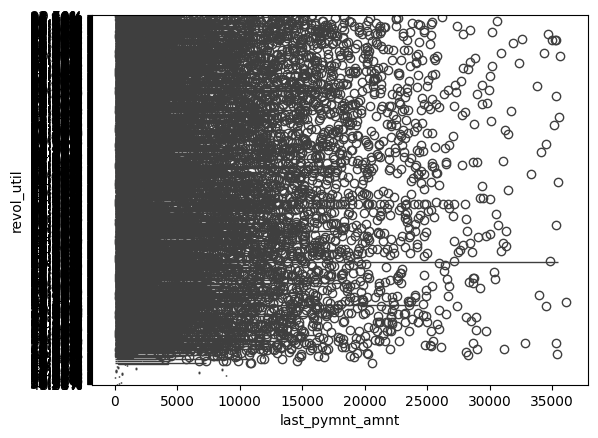

Box Plot of last_pymnt_amnt Vs last_pymnt_d


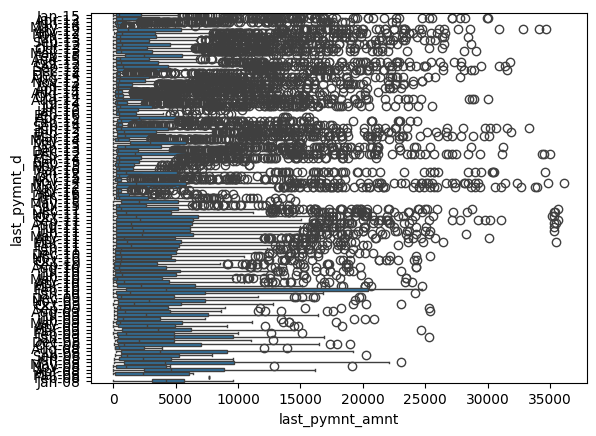

Box Plot of last_pymnt_amnt Vs last_credit_pull_d


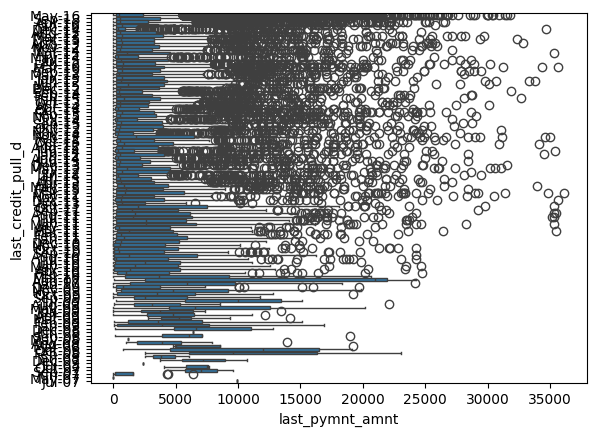

In [55]:
num_cols = ['loan_amnt','funded_amnt','funded_amnt_inv','installment', 'annual_inc', 'dti','inq_last_6mths','open_acc','pub_rec','revol_bal','total_acc','total_pymnt','total_pymnt_inv','total_rec_prncp','total_rec_int','recoveries','collection_recovery_fee','last_pymnt_amnt']
Cat_cols = ['term','int_rate','grade','sub_grade','emp_length','home_ownership','verification_status','issue_d','loan_status','purpose','zip_code','addr_state','earliest_cr_line','revol_util','last_pymnt_d','last_credit_pull_d']

for i in num_cols:
  for j in Cat_cols:
    print("Box Plot of",i,'Vs',j)
    sns.boxplot(x=df1[i],y=df1[j])
    plt.show()

In [56]:
num_cols = ['loan_amnt','funded_amnt','funded_amnt_inv','installment', 'annual_inc', 'dti','inq_last_6mths','open_acc','pub_rec','revol_bal','total_acc','total_pymnt','total_pymnt_inv','total_rec_prncp','total_rec_int','recoveries','collection_recovery_fee','last_pymnt_amnt']
Cat_cols = ['term','int_rate','grade','sub_grade','emp_length','home_ownership','verification_status','issue_d','loan_status','purpose','zip_code','addr_state','earliest_cr_line','revol_util','last_pymnt_d','last_credit_pull_d']


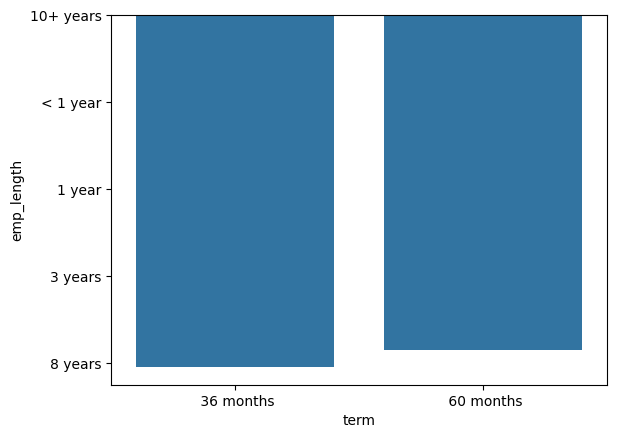

In [58]:
sns.barplot(x=df1['term'],y=df1['emp_length'],ci=None)
plt.show()

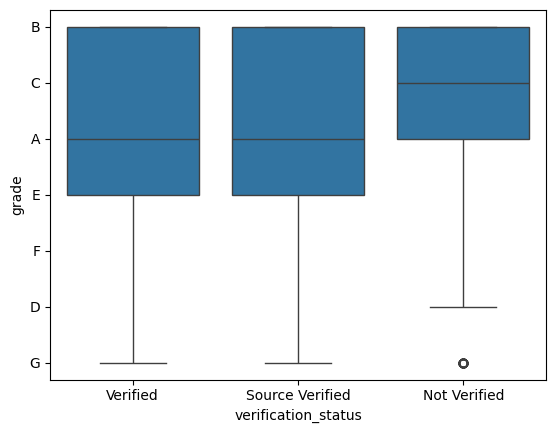

In [60]:
sns.boxplot(x=df1['verification_status'],y=df1['grade'])
plt.show()

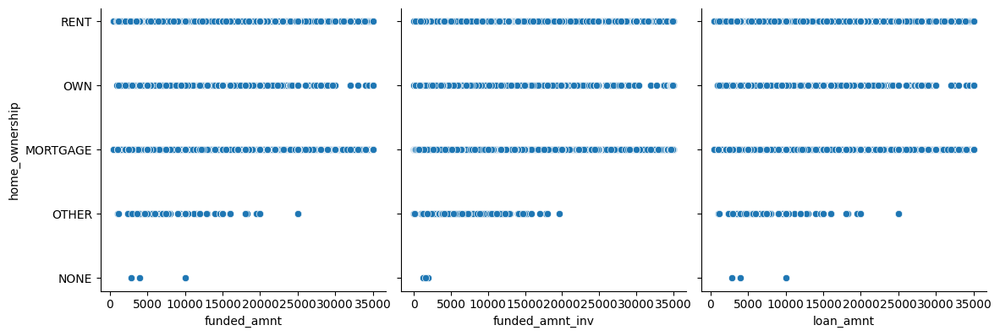

In [78]:
num_cols = ['loan_amnt','funded_amnt','funded_amnt_inv','installment', 'annual_inc', 'dti','inq_last_6mths','open_acc','pub_rec','revol_bal','total_acc','total_pymnt','total_pymnt_inv','total_rec_prncp','total_rec_int','recoveries','collection_recovery_fee','last_pymnt_amnt']
Cat_cols = ['term','int_rate','grade','sub_grade','emp_length','home_ownership','verification_status','issue_d','loan_status','purpose','zip_code','addr_state','earliest_cr_line','revol_util','last_pymnt_d','last_credit_pull_d']

sns.pairplot(df, x_vars=['funded_amnt','funded_amnt_inv','loan_amnt'], y_vars=['home_ownership'], size=4, aspect = 1, kind = 'scatter')
plt.show()

In [ ]:
sns.pairplot(df, x_vars=['funded_amnt','funded_amnt_inv','loan_amnt'], y_vars=['home_ownership'], size=4, aspect = 1, kind = 'scatter')
plt.show()

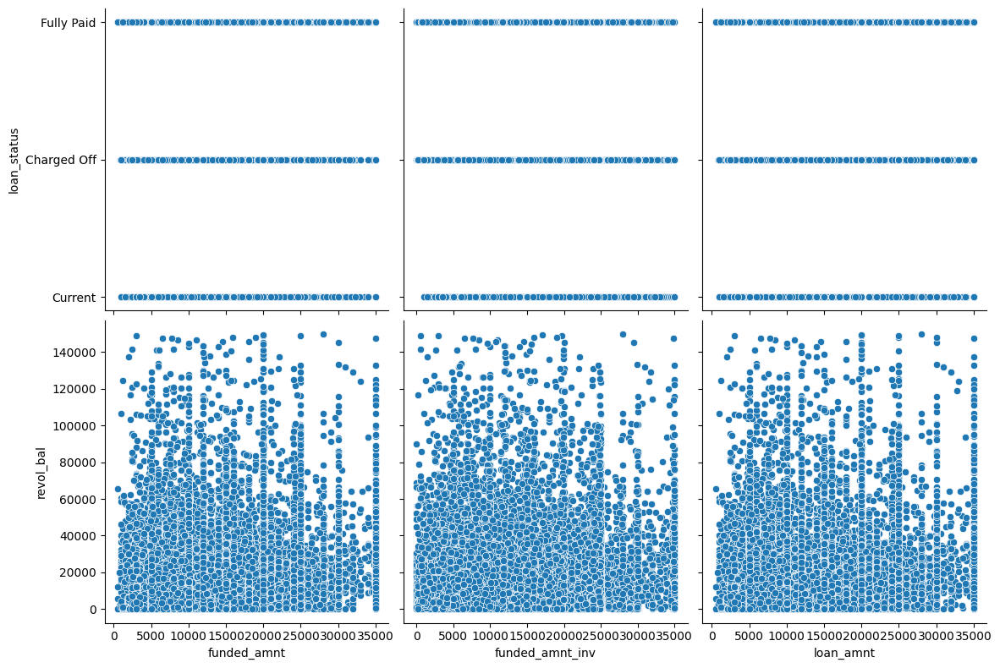

In [80]:
sns.pairplot(df, x_vars=['funded_amnt','funded_amnt_inv','loan_amnt'], y_vars=['loan_status','revol_bal'], size=4, aspect = 1, kind = 'scatter')
plt.show()

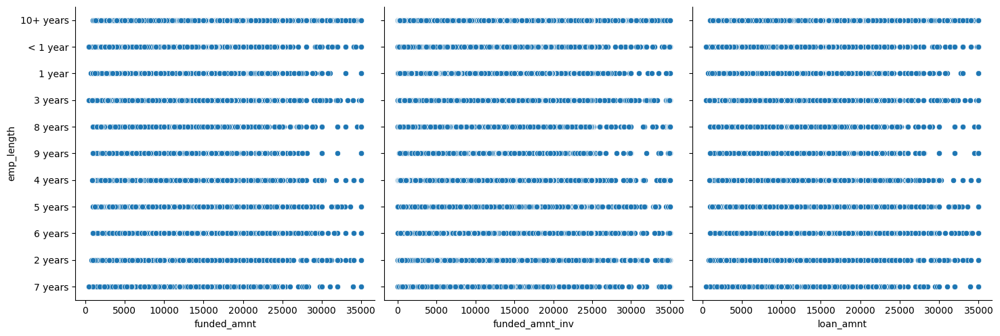

In [67]:
sns.pairplot(df, x_vars=['funded_amnt','funded_amnt_inv','loan_amnt'], y_vars=['emp_length'], size = 5, kind = 'scatter')
plt.show()

In [69]:
df2.describe().columns

Index(['loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'installment',
       'annual_inc', 'dti', 'inq_last_6mths', 'open_acc', 'pub_rec',
       'revol_bal', 'total_acc', 'total_pymnt', 'total_pymnt_inv',
       'total_rec_prncp', 'total_rec_int', 'recoveries',
       'collection_recovery_fee', 'last_pymnt_amnt'],
      dtype='object')

#Multivariate Analysis

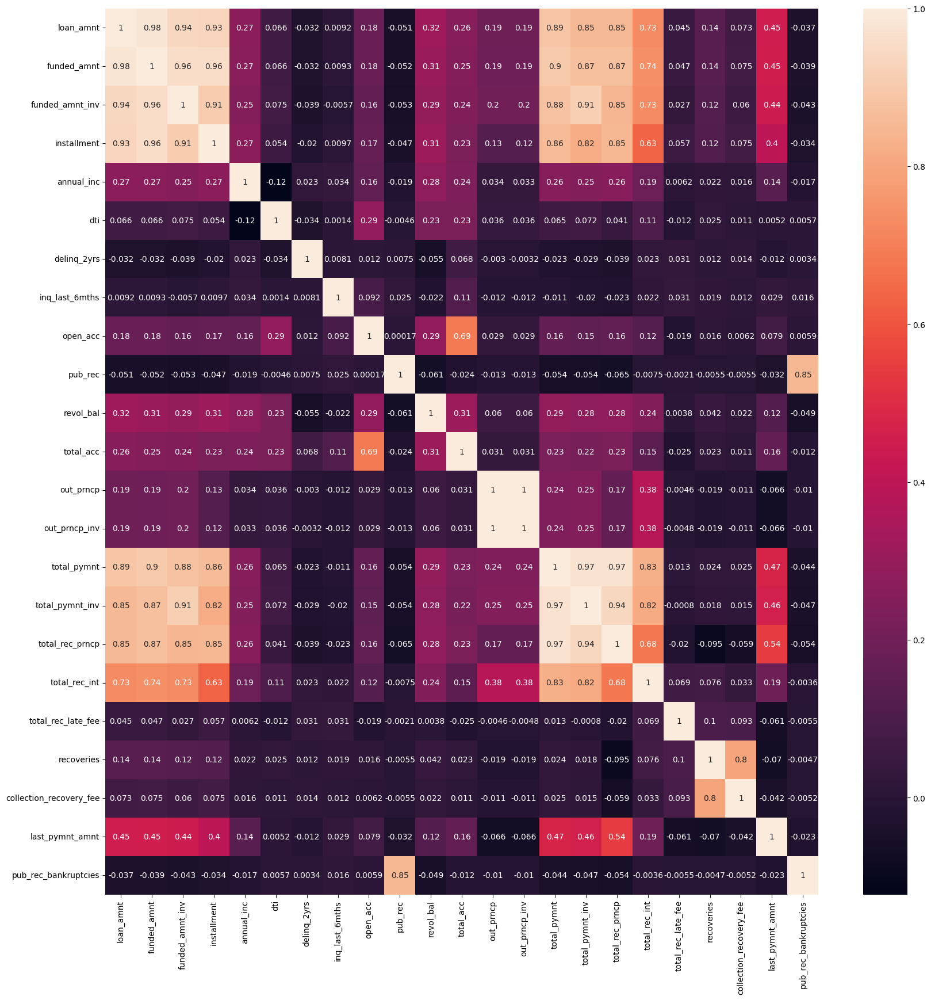

In [70]:
plt.figure(figsize = (20,20))
sns.heatmap(df[['loan_amnt', 'funded_amnt','funded_amnt_inv','installment','annual_inc','dti','delinq_2yrs','inq_last_6mths','open_acc','pub_rec','revol_bal','total_acc','out_prncp','out_prncp_inv','total_pymnt','total_pymnt_inv','total_rec_prncp','total_rec_int','total_rec_late_fee','recoveries','collection_recovery_fee','last_pymnt_amnt','pub_rec_bankruptcies']].corr(), annot = True)
plt.show()

<Axes: >

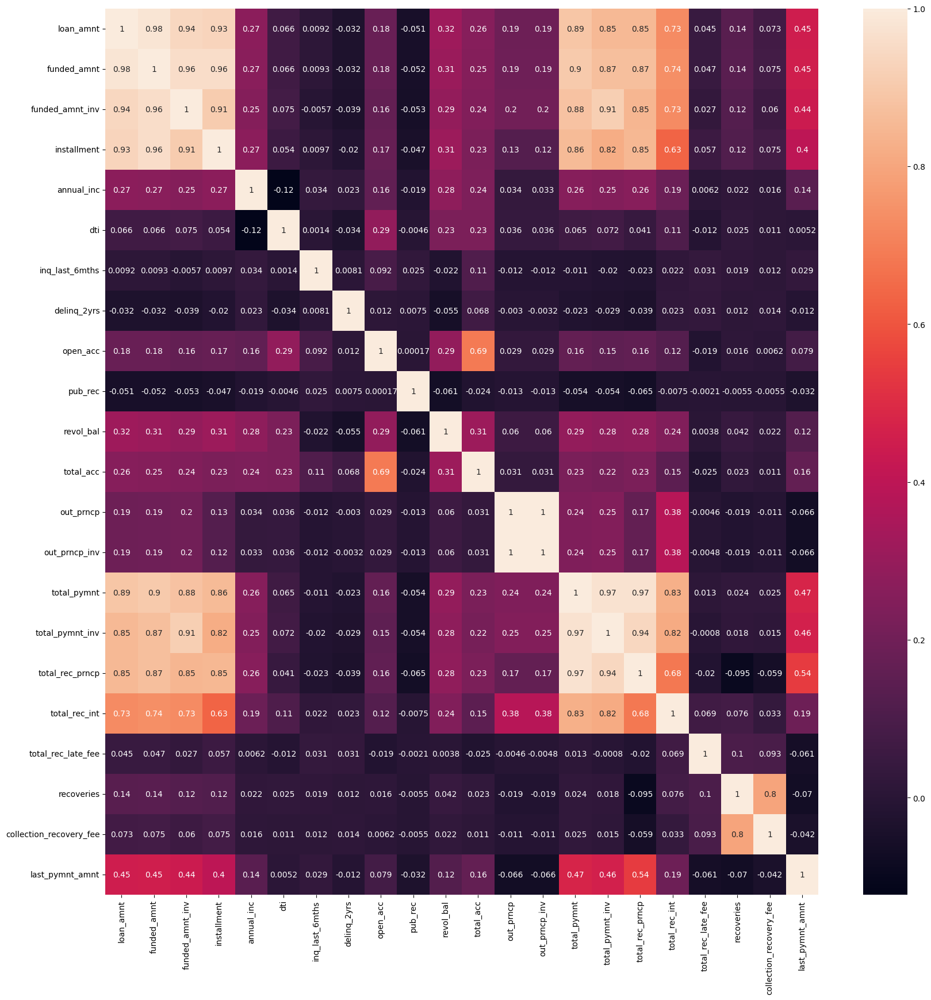

In [71]:
num_cols = ['loan_amnt','funded_amnt','funded_amnt_inv','installment', 'annual_inc', 'dti','inq_last_6mths','open_acc','pub_rec','revol_bal','total_acc','total_pymnt','total_pymnt_inv','total_rec_prncp','total_rec_int','recoveries','collection_recovery_fee','last_pymnt_amnt']
Cat_cols = ['term','int_rate','grade','sub_grade','emp_length','home_ownership','verification_status','issue_d','loan_status','purpose','zip_code','addr_state','earliest_cr_line','revol_util','last_pymnt_d','last_credit_pull_d']

plt.figure(figsize = (20,20))
sns.heatmap(df1[['loan_amnt','funded_amnt','funded_amnt_inv','installment', 'annual_inc', 'dti','inq_last_6mths','delinq_2yrs','open_acc','pub_rec','revol_bal','total_acc', 'out_prncp','out_prncp_inv','total_pymnt','total_pymnt_inv','total_rec_prncp','total_rec_int','total_rec_late_fee','recoveries','collection_recovery_fee','last_pymnt_amnt','term','int_rate','grade','sub_grade','emp_length','home_ownership','verification_status','issue_d','loan_status','purpose','zip_code','addr_state','earliest_cr_line','revol_util','last_pymnt_d','last_credit_pull_d']].corr() , annot = True)

<Axes: >

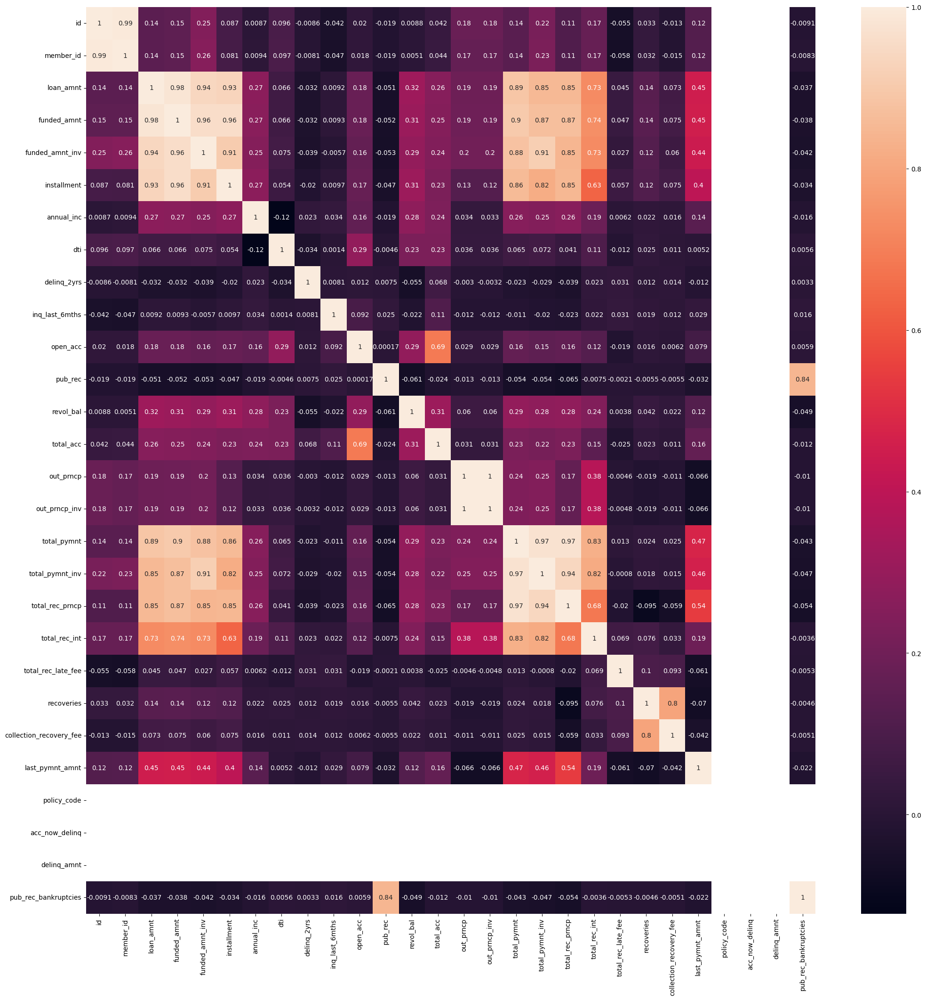

In [ ]:
plt.figure(figsize = (25,25))
sns.heatmap(df1.corr(),annot = True)

In [81]:
num_cols = ['loan_amnt','funded_amnt','funded_amnt_inv','installment', 'annual_inc', 'dti','inq_last_6mths','open_acc','pub_rec','revol_bal','total_acc','total_pymnt','total_pymnt_inv','total_rec_prncp','total_rec_int','recoveries','collection_recovery_fee','last_pymnt_amnt']
Cat_cols = ['term','int_rate','grade','sub_grade','emp_length','home_ownership','verification_status','issue_d','loan_status','purpose','zip_code','addr_state','earliest_cr_line','revol_util','last_pymnt_d','last_credit_pull_d']


<Axes: >

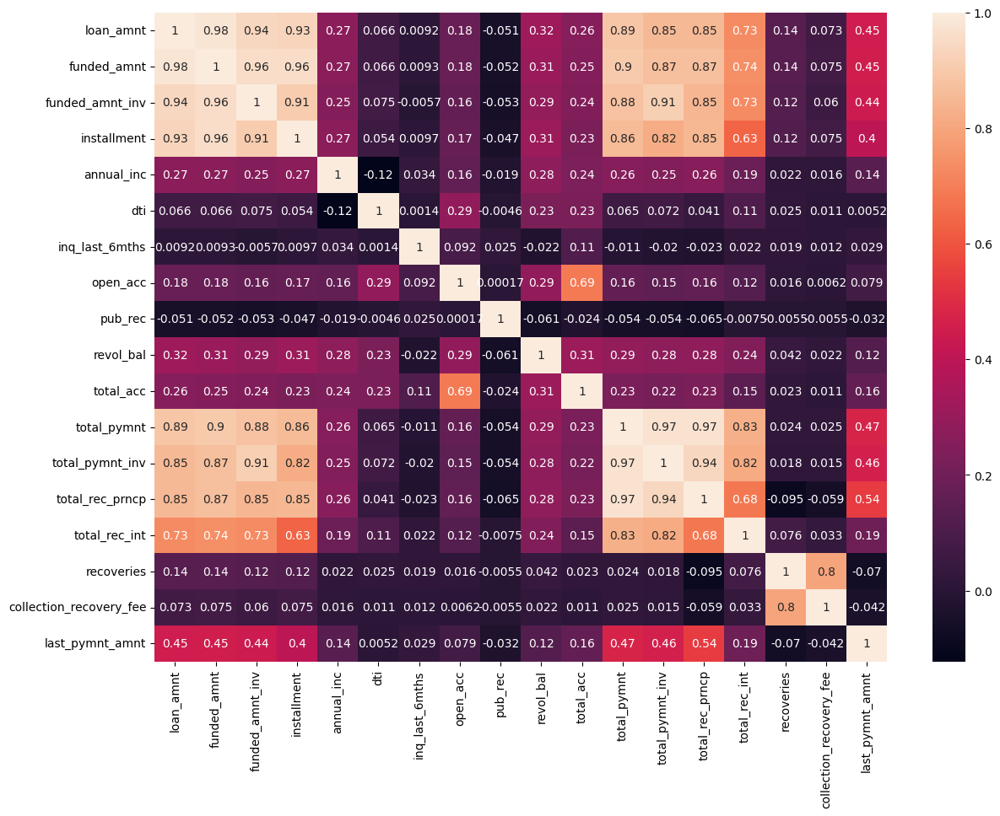

In [85]:
plt.figure(figsize = (14,10))
sns.heatmap(df2.corr(), annot = True)

In [88]:
df2.describe().columns

Index(['loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'installment',
       'annual_inc', 'dti', 'inq_last_6mths', 'open_acc', 'pub_rec',
       'revol_bal', 'total_acc', 'total_pymnt', 'total_pymnt_inv',
       'total_rec_prncp', 'total_rec_int', 'recoveries',
       'collection_recovery_fee', 'last_pymnt_amnt'],
      dtype='object')

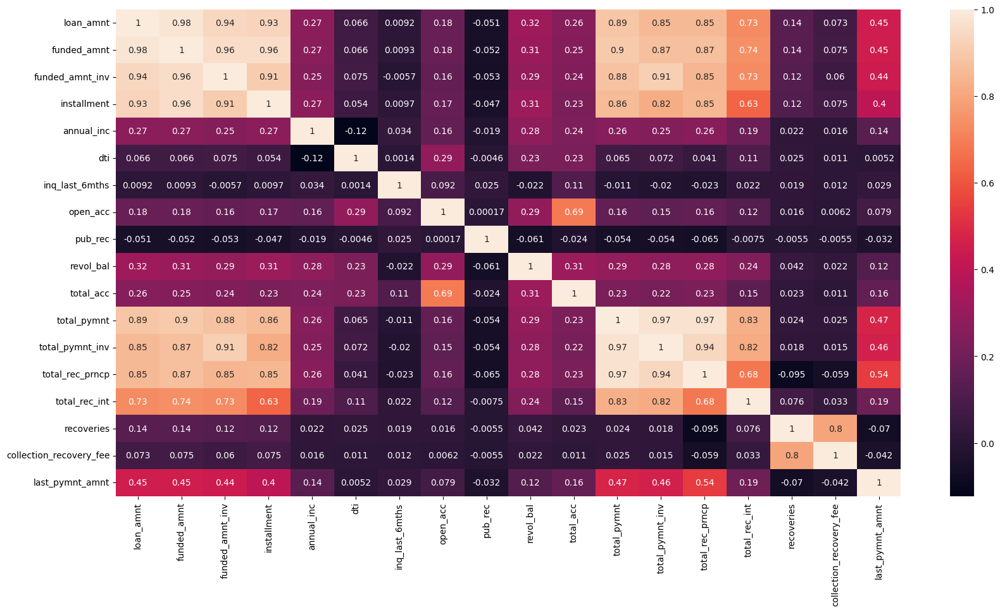

In [91]:
plt.figure(figsize = (20,10))
sns.heatmap(df2[['loan_amnt','funded_amnt','funded_amnt_inv','installment','annual_inc','dti','inq_last_6mths','open_acc','pub_rec','revol_bal','total_acc','total_pymnt','total_pymnt_inv','total_rec_prncp','total_rec_int','recoveries','collection_recovery_fee','last_pymnt_amnt']].corr(), annot = True)
plt.show()